# Summary

In this notebook we explore how MMBGP compares with BGP in fitting
back to noisy synthetic data in two settings:
1. prior confidence = 0.8 (traditional BGP)
2. funky prior where prior confidence = 0.5 (uninformative) 
   for pseudotime [0, 0.8] and then is 0.8 on [0.8, 1].

We measure RMSE of true branching points vs learned branching points 
as well as the cell label inconsistency for BGP.

In [1]:
from BranchedGP.MBGP.data_generation import ToyBranchedData, GeneExpressionData
from BranchedGP.MBGP.training_helpers import TrainingOutcome, get_training_outcome
from BranchedGP.MBGP.plotting_helpers import plot_detailed_fit, plot_model_snapshot
from BranchedGP.MBGP.sampling_helpers import get_synthetic_noisy_branched_data

from BranchedGP.MBGP.assigngp import AssignGP
from BranchedGP.MBGP.VBHelperFunctions import plotBranchModel
import matplotlib.pyplot as plt
import numpy as np

from BranchedGP.MBGP.training_helpers import (
    construct_assigngp_model, 
    SimplePhiConstructor, 
    ScipyOptimiser, 
    ElvijsAmazingOptimiser,
)
import gpflow
from typing import Sequence


def get_assigngp_with_target_bps(bps: Sequence[float], lengthscale: float, noise_variance: float) -> AssignGP:
    """ A simple wrapper that tweaks some key model construction parameters. """
    data = ToyBranchedData(bps, N=100)  # not used; need data to construct a model
    m = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=SimplePhiConstructor(data, prior_confidence=0.65),
        initial_branching_points=[0.5]*data.num_genes,
    )
    
    # assign reasonable initial values for the BPs
    m.kernel.Bv.assign(np.array(bps))
    m.kernel.kern.lengthscales.assign(lengthscale)
    m.likelihood.variance.assign(noise_variance)
    return m

In [2]:
from BranchedGP.MBGP.data_generation import Vector
from BranchedGP.MBGP.training_helpers import InitialAndPriorPhi, PhiConstructor


def get_funky_phi(
        global_branching_state: Vector,
        uninformative_until: float,
        informative_prior_confidence: float,
) -> InitialAndPriorPhi:
    if not 0 <= uninformative_until <= 1:
        raise ValueError(
            f"Expected uninformative_until to be in the range [0, 1]. "
            f"Instead got: {uninformative_until}."
        )
    if not 0 <= informative_prior_confidence <= 1:
        raise ValueError(
            f"Expected informative_prior_confidence to be in the range [0, 1]. "
            f"Instead got: {uninformative_until}."
        )

    (N,) = global_branching_state.shape
    # WARNING: assumes uniformly spaced state on [0, 1].
    uninformative_until_idx = int(uninformative_until * N)
    print(f"Uninformative until idx: {uninformative_until_idx}")

    # Initialise phi_initial and phi_prior to 50% probability for each of the branches g, h
    # We will then update them
    phi_initial = np.ones((N, 2)) * 0.5
    phi_prior = np.ones((N, 2)) * 0.5

    # TODO: the following can probably be written as pure numpy array operations,
    #   but we're taking the easy way for speed.
    for i in range(N):
        not_trunk = global_branching_state[i] in {2, 3}

        if not_trunk:
            # The g, h states normally map to 2, 3, but here we want to map them to columns 0, 1
            true_branch_col = int(global_branching_state[i] - 2)
            if i > uninformative_until_idx:
                phi_prior[i, :] = 1 - informative_prior_confidence
                phi_prior[i, true_branch_col] = informative_prior_confidence
            # else leave at 0.5, 0.5

            # Set phi_initial to have true state label with a random probability in [0.5, 1]
            # This is the same as SimplePhiConstructor
            phi_initial[i, true_branch_col] = 0.5 + (np.random.random() / 2.)
            phi_initial[i, true_branch_col != np.array([0, 1])] = 1 - phi_initial[i, true_branch_col]

    assert np.allclose(phi_prior.sum(1), 1), \
        f"Phi Prior probability distribution should sum to 1 for each branch. " \
        f"Instead got: {phi_prior.sum(1)}"
    assert np.allclose(phi_initial.sum(1), 1), \
        f"Phi Initial probability distribution should sum to 1 for each branch. " \
        f"Instead got: {phi_initial.sum(1)}"
    assert np.all(~np.isnan(phi_initial)), f"Found NaNs in phi_initial, something has gone badly wrong!"
    assert np.all(~np.isnan(phi_prior)), f"Found NaNs in phi_prior, something has gone badly wrong!"
    return phi_initial, phi_prior


class FunkyPrior(PhiConstructor):
    """
    Uninformative prior for early cells, informative prior for late cells.
    """

    def __init__(
            self,
            gene_expression_data: GeneExpressionData,
            uninformative_until: float,
            informative_prior_confidence: float,
            allow_infs: bool = True,
    ) -> None:
        self._state = gene_expression_data.state
        self._uninformative_until = uninformative_until
        self._informative_prior_confidence = informative_prior_confidence
        self._allow_infs = allow_infs

    def build(self) -> InitialAndPriorPhi:
        phi_initial, phi_prior = get_funky_phi(
            global_branching_state=self._state,
            uninformative_until=self._uninformative_until,
            informative_prior_confidence=self._informative_prior_confidence,
        )

        phi_prior = np.c_[np.zeros(phi_prior.shape[0])[:, None], phi_prior]  # prepend 0 for trunk
        return phi_initial, phi_prior

## Sanity check the implementation

`phi_initial` uniformly samples `[0.5, 1]` as the probability of the true state.
`phi_prior` provides `prior_confidence` as the probability of the true state. Let's just see it in action.

In [3]:
toy_data = ToyBranchedData(B=(0.5,), N=10)

for prior_confidence in [0.5, 0.75, 1.]:
    print(f"SimplePhiConstructor Prior confidence: {prior_confidence}")
    phi_init, phi_prior = SimplePhiConstructor(toy_data, prior_confidence).build()
    print(f"State: {toy_data.state}")
    print(f"Phi initial: {phi_init}")
    print(f"Phi prior: {phi_prior}")

SimplePhiConstructor Prior confidence: 0.5
State: [2 3 2 3 2 3 2 3 2 3]
Phi initial: [[0.51029225 0.48970775]
 [0.01504507 0.98495493]
 [0.91622132 0.08377868]
 [0.39383044 0.60616956]
 [0.59091248 0.40908752]
 [0.40829775 0.59170225]
 [0.65212112 0.34787888]
 [0.23762178 0.76237822]
 [0.71597251 0.28402749]
 [0.35438543 0.64561457]]
Phi prior: [[0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]]
SimplePhiConstructor Prior confidence: 0.75
State: [2 3 2 3 2 3 2 3 2 3]
Phi initial: [[0.51029225 0.48970775]
 [0.01504507 0.98495493]
 [0.91622132 0.08377868]
 [0.39383044 0.60616956]
 [0.59091248 0.40908752]
 [0.40829775 0.59170225]
 [0.65212112 0.34787888]
 [0.23762178 0.76237822]
 [0.71597251 0.28402749]
 [0.35438543 0.64561457]]
Phi prior: [[0.   0.75 0.25]
 [0.   0.25 0.75]
 [0.   0.75 0.25]
 [0.   0.25 0.75]
 [0.   0.75 0.25]
 [0.   0.25 0.75]
 [0.   0.75 0.25]
 [0.   0.25 0.75]
 [0.   0.7

Now compare with the funky prior

In [4]:
for prior_confidence in [0.5, 0.75, 1.]:
    for uninformative_until in [0., 0.5, 1.]:
        print(f"FunkyPhi Prior confidence: {prior_confidence}, uninformative until: {uninformative_until}")
        phi_init, phi_prior = FunkyPrior(
            toy_data,
            uninformative_until=uninformative_until,
            informative_prior_confidence=prior_confidence,
        ).build()
        print(f"State: {toy_data.state}")
        print(f"Phi prior: {phi_prior}")

FunkyPhi Prior confidence: 0.5, uninformative until: 0.0
Uninformative until idx: 0
State: [2 3 2 3 2 3 2 3 2 3]
Phi prior: [[0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]]
FunkyPhi Prior confidence: 0.5, uninformative until: 0.5
Uninformative until idx: 5
State: [2 3 2 3 2 3 2 3 2 3]
Phi prior: [[0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]]
FunkyPhi Prior confidence: 0.5, uninformative until: 1.0
Uninformative until idx: 10
State: [2 3 2 3 2 3 2 3 2 3]
Phi prior: [[0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]
 [0.  0.5 0.5]]
FunkyPhi Prior confidence: 0.75, uninformative until: 0.0
Uninformative until idx: 0
State: [2 3 2 3 2 3 2 3 2 3]
Phi prior: [[0.   0.5  0.5 ]
 [0.   0.25 0.75]
 [0.   0.75 0

OK, that looks pretty legit, let's see what's the maximum amount of noise that we can reasonably handle.
Just a reminder that we want the noise high as that is both more impressive as well as more realistic.

# Counting branch inconsistencies

To test, we first need some BGPs.

Metal device set to: Apple M1
Sampling branching data from the following model
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤═══════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                             │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪═══════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                       │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼───────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                               │
├────────

2023-05-11 07:03:22.085711: W tensorflow/tsl/platform/profile_utils/cpu_utils.cc:128] Failed to get CPU frequency: 0 Hz


Trained model
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 6.23102                            │
├───────────────────────────────────┼───────────┼──────────────────┼

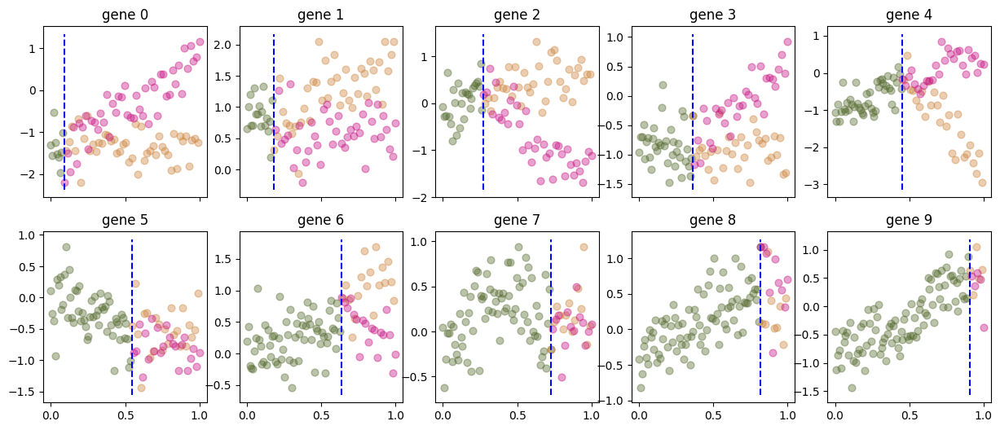

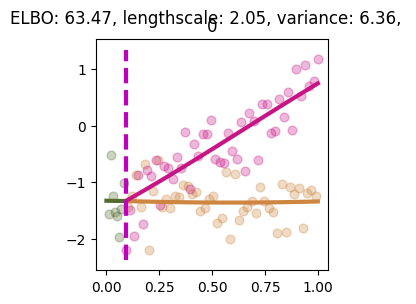

Slicing for gene 1
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

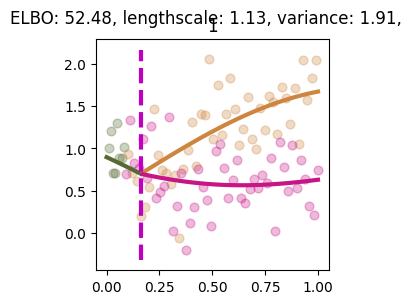

Slicing for gene 2
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

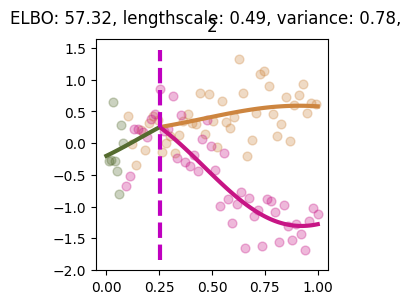

Slicing for gene 3
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

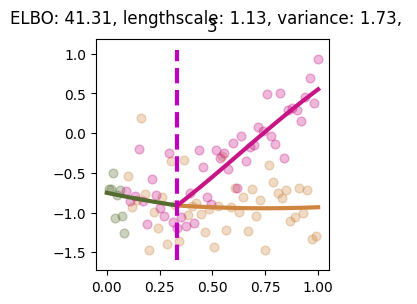

Slicing for gene 4
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

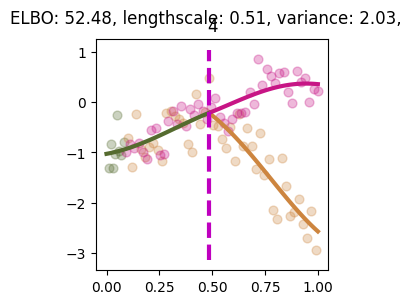

Slicing for gene 5
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

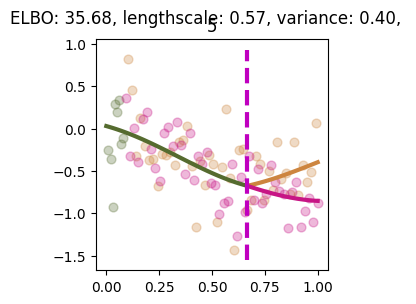

Slicing for gene 6
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

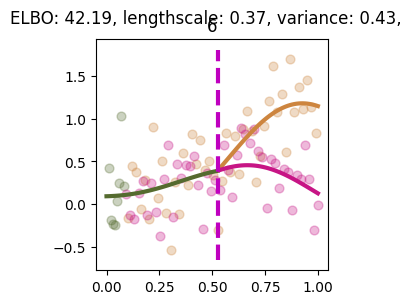

Slicing for gene 7
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

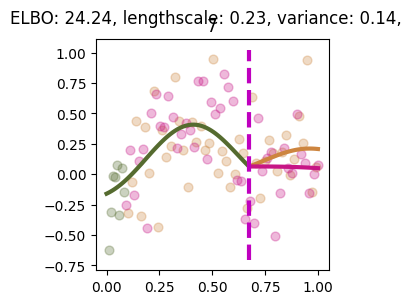

Slicing for gene 8
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

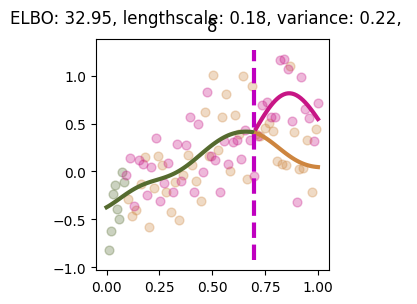

Slicing for gene 9
╒═══════════════════════════════════╤═══════════╤══════════════════╤═════════╤═════════════╤════════════╤═════════╤════════════════════════════════════╕
│ name                              │ class     │ transform        │ prior   │ trainable   │ shape      │ dtype   │ value                              │
╞═══════════════════════════════════╪═══════════╪══════════════════╪═════════╪═════════════╪════════════╪═════════╪════════════════════════════════════╡
│ AssignGP.ZExpanded                │ Parameter │ Identity         │         │ False       │ (180, 2)   │ float64 │ [[0., 1....                        │
├───────────────────────────────────┼───────────┼──────────────────┼─────────┼─────────────┼────────────┼─────────┼────────────────────────────────────┤
│ AssignGP.kernel.kern.variance     │ Parameter │ Softplus         │         │ True        │ ()         │ float64 │ 1.0                                │
├───────────────────────────────────┼───────────┼──────────────

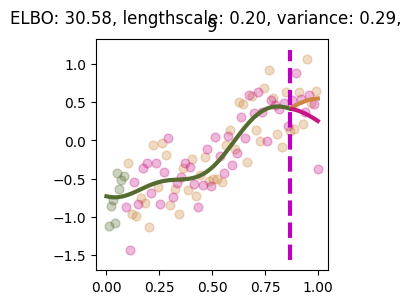

In [5]:
NOISE = 0.1
LENGTHSCALE = 0.5
BGP_PRIOR_CONFIDENCE = 0.8


dummy_model = get_assigngp_with_target_bps(
    [i/11 for i in range(1, 11, 1)], 
    lengthscale=LENGTHSCALE, 
    noise_variance=NOISE,
)
print("Sampling branching data from the following model")
gpflow.utilities.print_summary(dummy_model)
gene_expressions = get_synthetic_noisy_branched_data(dummy_model, num_samples=1, x_pts=100)
data = gene_expressions[0]
data.plot()
bgp_models = []

for i in range(data.num_genes):
    print(f"Slicing for gene {i}")
    
    sliced_data = GeneExpressionData(
        t=data.t,
        Y=data.Y[:, i].reshape(-1, 1),
        state=data.state,
        gene_labels=[f"{i}"]
    )
   
    # new model with default-ey parameter values, but SimplePhiConstructor
    new_model = construct_assigngp_model(
        gene_expression=sliced_data,
        phi_constructor=SimplePhiConstructor(sliced_data, BGP_PRIOR_CONFIDENCE),
        initial_branching_points=[0.5],  # Don't start at the true locations
    )
    gpflow.utilities.print_summary(new_model)
    
    optimiser = ElvijsAmazingOptimiser()
    trained_model = optimiser.train(new_model)
    print("Trained model")
    gpflow.utilities.print_summary(trained_model)
    
    plot_model_snapshot(trained_model, genes=sliced_data, alpha=0.3)
    plt.show()
    
    bgp_models.append(trained_model)

In [6]:
def count_branch_inconsistencies(
        models: Sequence[AssignGP], 
        threshold: float, 
        debug: bool = False,
        only_branches: bool = True,
) -> int:
    """ 
    Count how many cell assignments to branches g, h are inconsistent across genes. 
    
    What do we mean by inconsistent cell assignments to branches g, h?
    Set n = 0.
    Iterate over all cells.
    For each cell, iterate over all models.
    We say that a model has strong belief about cell assignment 
    to branches g, h if either probability in Phi is above :param:`threshold`.
    Compare all models with strong beliefs.
    If they all agree on the cell assignment, then we don't increment n.
    Otherwise increment n.
    """
    n = 0
    num_cells = models[0].N
    
    # only keep the bits of Phi that correspond to g and h
    all_phis_projected = [m.GetPhi()[:, 1:] for m in models]
    all_bps = [m.BranchingPoints[0] for m in models]

    for i in range(num_cells):
        # Here we're assuming X is uniformly spaced across [0, 1].
        cell_pseudotime = i/num_cells
        
        strong_opinions = [phi[i] > threshold for phi in all_phis_projected]
        
        # we only consider strong opinions if they are after the model's indicated branching point
        valid_strong_opinions = []
        for j, opinion in enumerate(strong_opinions):
            if opinion.any():
                if only_branches:
                    # only keep data past the branching point
                    if cell_pseudotime > all_bps[j]:
                        valid_strong_opinions.append(opinion)
                else:
                    valid_strong_opinions.append(opinion)
        
        # We now multiply all the valid strong opinions together.
        # If they disagree, we're left with np.array([0, 0]), otherwise we get
        # either np.array([1, 0]) or np.array([0, 1]).
        # We discern the situation via .sum()
        strong_opinions_agree = bool(np.multiply.reduce(valid_strong_opinions).sum())
        
        if not strong_opinions_agree:
            n += 1
            if debug:
                print(
                    f"phis: {[phi[i] for phi in all_phis_projected]}, "
                    f"valid_strong_opinions: {valid_strong_opinions}"
                )
    
    return n

In [7]:
inconsistencies = count_branch_inconsistencies(bgp_models, threshold=0.8, debug=True)
print(inconsistencies)

phis: [array([0.90796037, 0.09185533]), array([0.19417411, 0.8052807 ]), array([0.78072061, 0.21917134]), array([0.92032611, 0.07915096]), array([0.79945198, 0.20041626]), array([0.80487493, 0.19494317]), array([0.78582471, 0.21406345]), array([0.76735552, 0.23246611]), array([0.9329452 , 0.06669053]), array([0.84527844, 0.15471069])], valid_strong_opinions: [array([ True, False]), array([False,  True]), array([ True, False])]
phis: [array([9.99999964e-01, 1.66949686e-11]), array([0.96184171, 0.03760546]), array([9.99999386e-01, 6.00140500e-09]), array([9.99999826e-01, 8.98656146e-11]), array([1.0000000e+00, 1.8054053e-16]), array([0.75655604, 0.2433484 ]), array([9.99999992e-01, 5.92830460e-12]), array([0.76541514, 0.23431076]), array([4.41109656e-13, 1.00000000e+00]), array([0.78267399, 0.21729652])], valid_strong_opinions: [array([ True, False]), array([ True, False]), array([ True, False]), array([ True, False]), array([ True, False]), array([ True, False]), array([False,  True])]


OK, that looks reasonable, let's proceed to the experiments.

# Experiments

We will take 10 random branching processes with fixed BPs (at 1/11, 2/11, ... 10/11) samples with a fixed, maximal noise level on 10 genes. We want the noise as high as possible provided the models don't go pear-shaped.

## Prior confidence = 0.8

10 samples drawn, 0 valid samples constructed
20 samples drawn, 3 valid samples constructed
30 samples drawn, 7 valid samples constructed
40 samples drawn, 10 valid samples constructed
50 samples drawn, 14 valid samples constructed
Processing sample 0


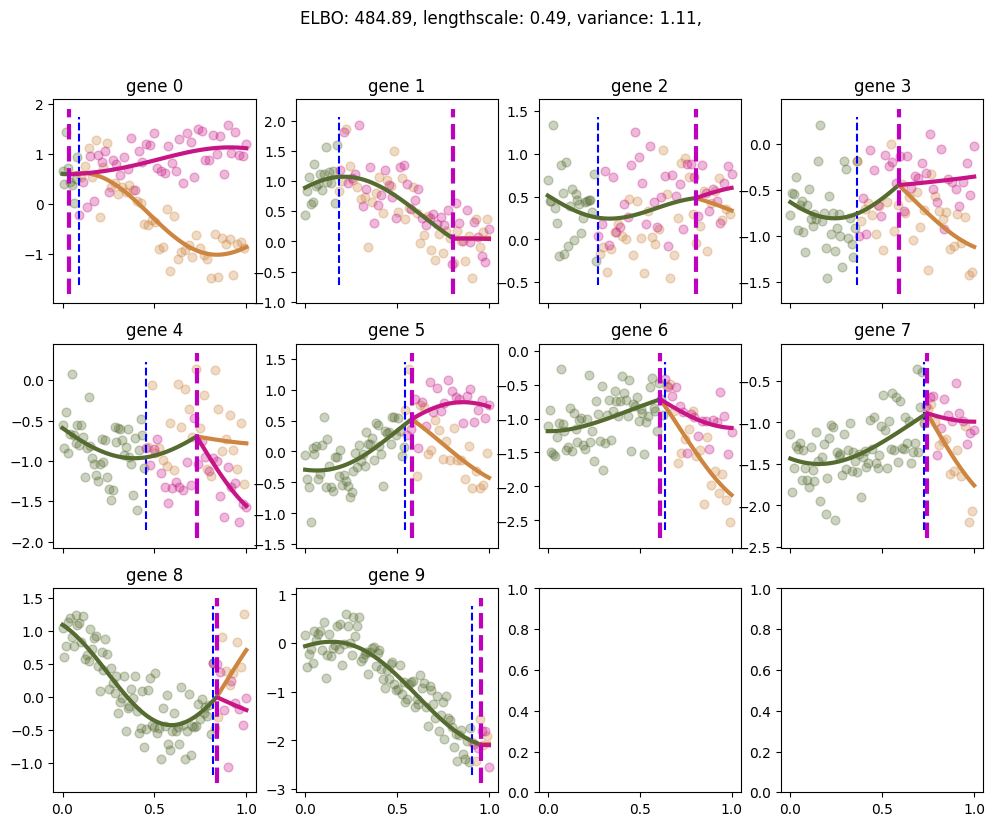

Slicing for gene 0


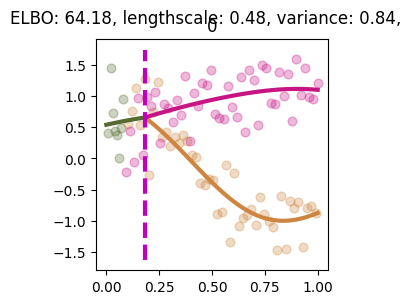

Slicing for gene 1


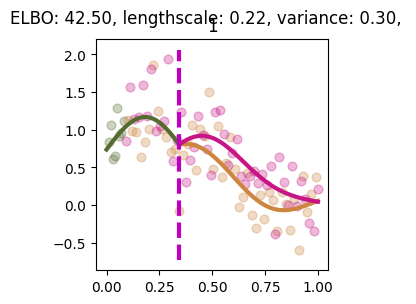

Slicing for gene 2


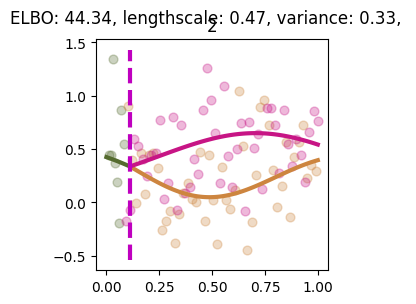

Slicing for gene 3


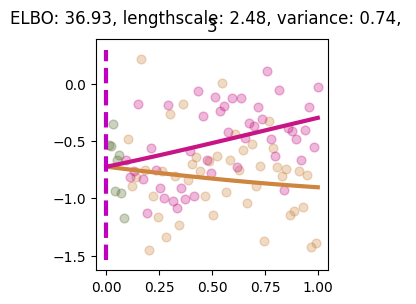

Slicing for gene 4


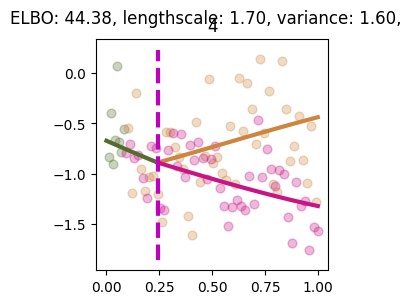

Slicing for gene 5


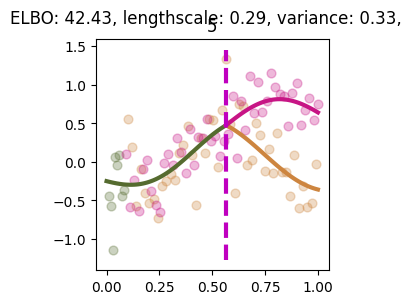

Slicing for gene 6


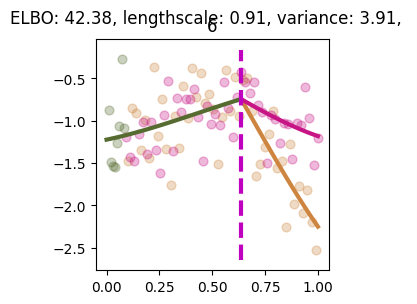

Slicing for gene 7


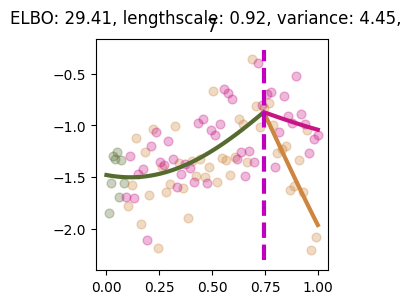

Slicing for gene 8


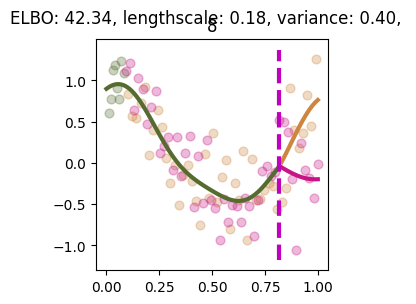

Slicing for gene 9


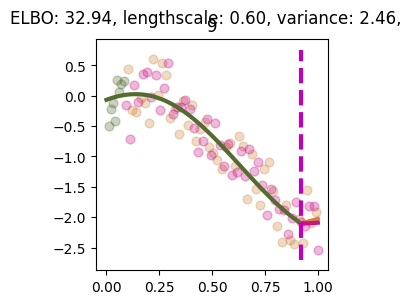

Processing sample 1


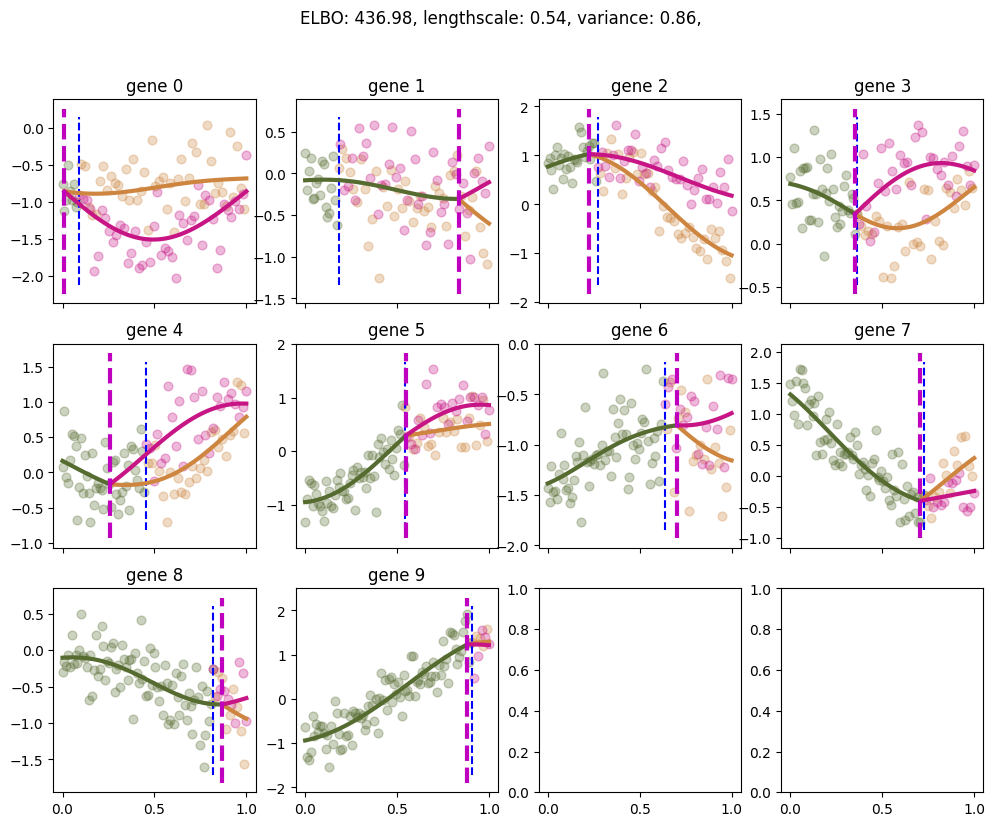

Slicing for gene 0


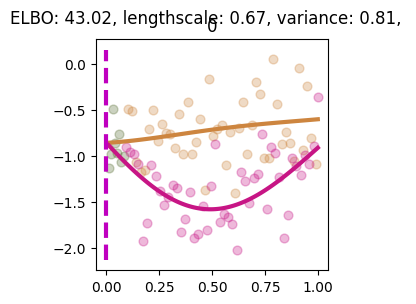

Slicing for gene 1


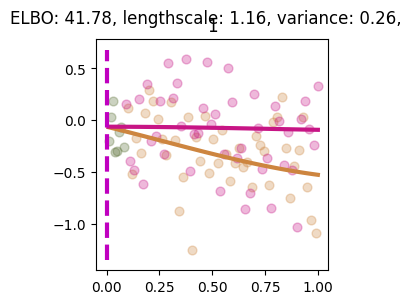

Slicing for gene 2


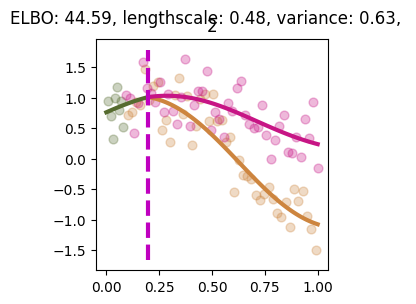

Slicing for gene 3


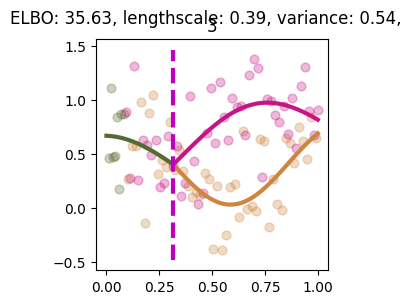

Slicing for gene 4


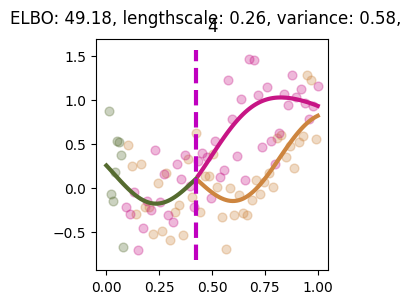

Slicing for gene 5


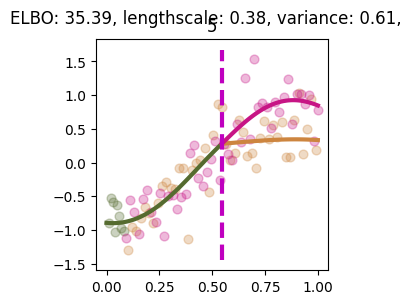

Slicing for gene 6


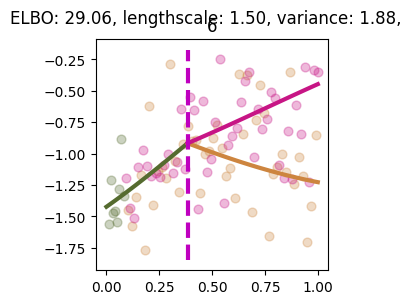

Slicing for gene 7


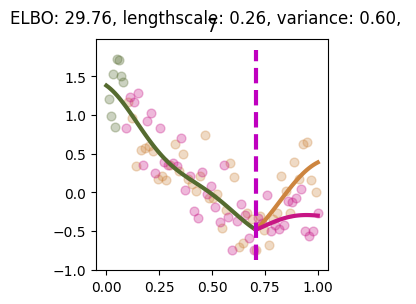

Slicing for gene 8


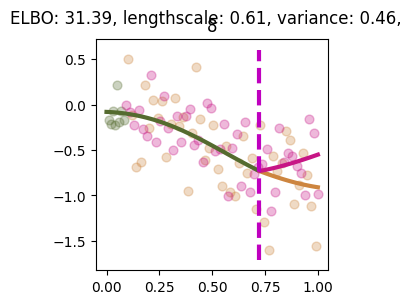

Slicing for gene 9


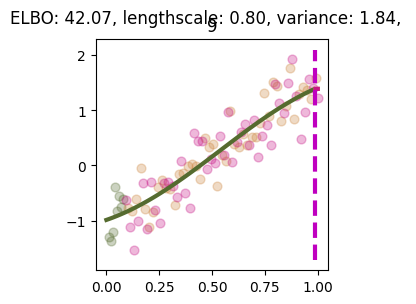

Processing sample 2


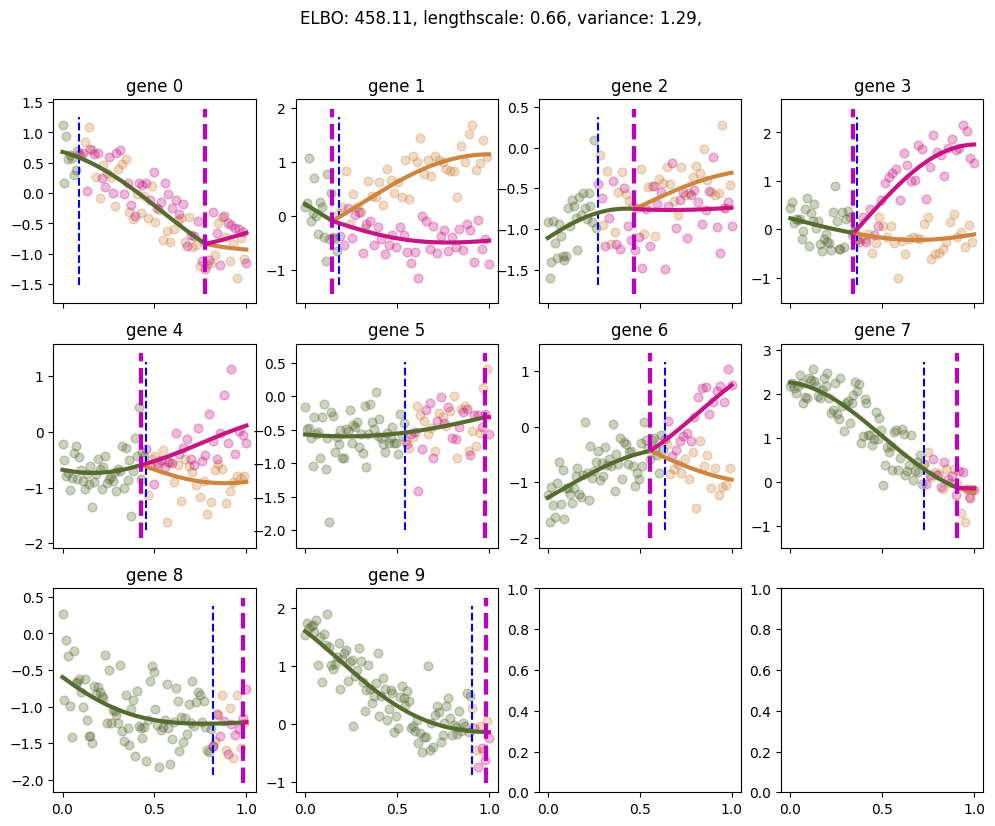

Slicing for gene 0


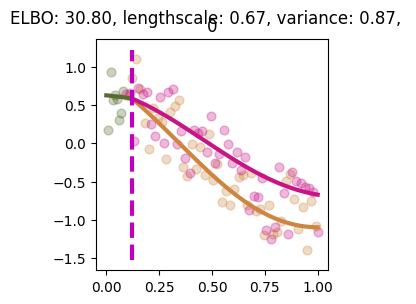

Slicing for gene 1


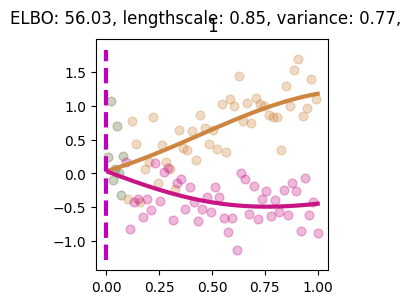

Slicing for gene 2


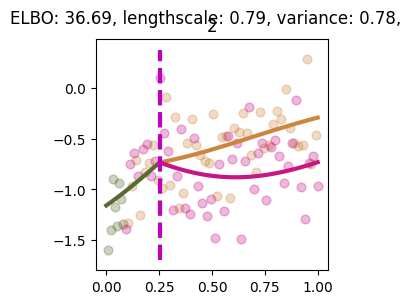

Slicing for gene 3


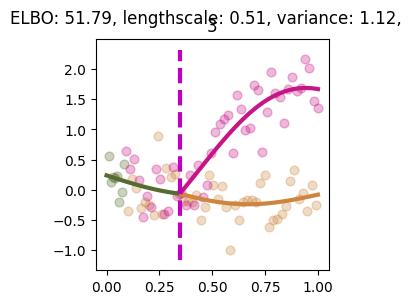

Slicing for gene 4


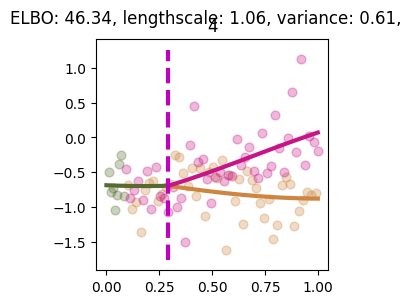

Slicing for gene 5


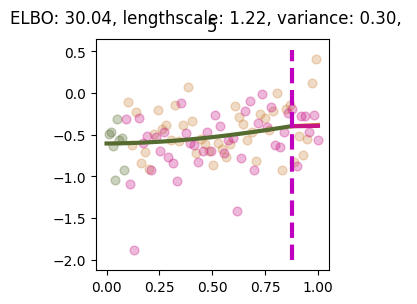

Slicing for gene 6


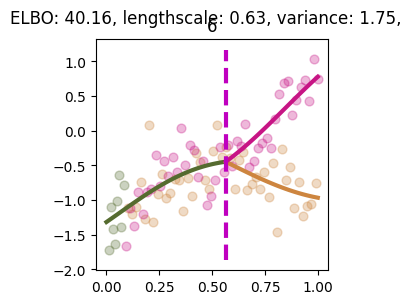

Slicing for gene 7


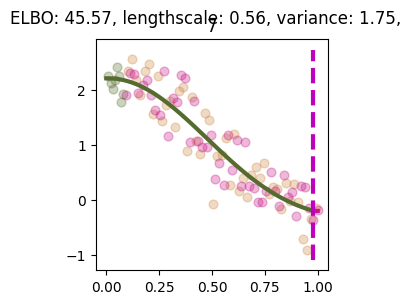

Slicing for gene 8


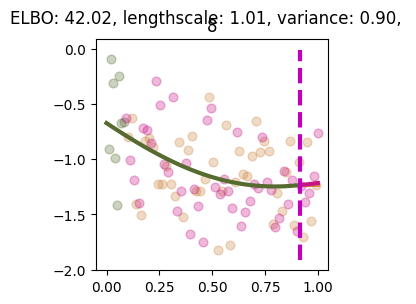

Slicing for gene 9


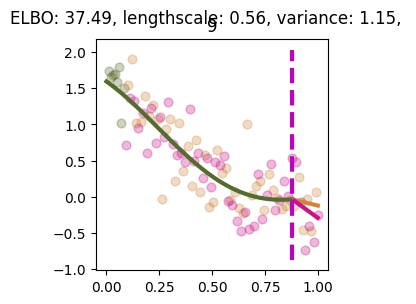

Processing sample 3


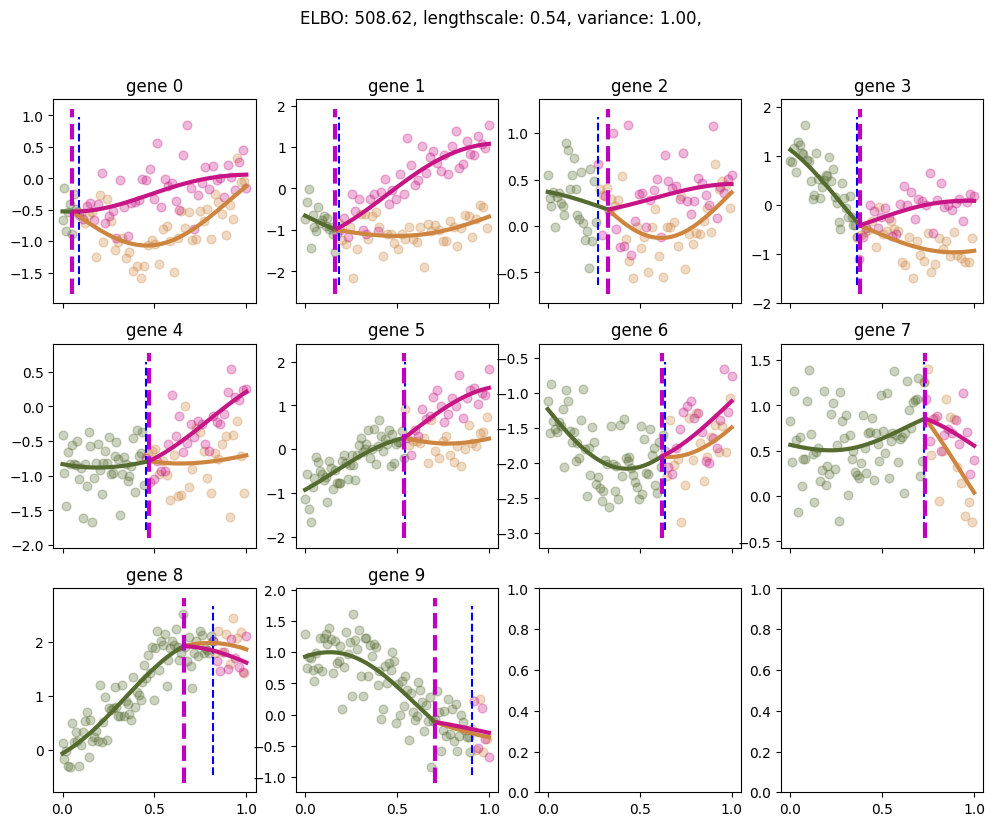

Slicing for gene 0


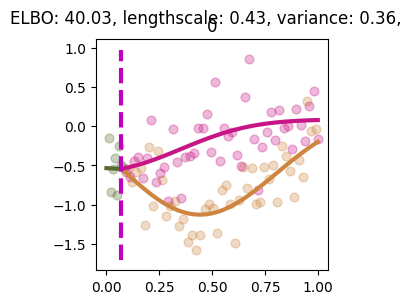

Slicing for gene 1


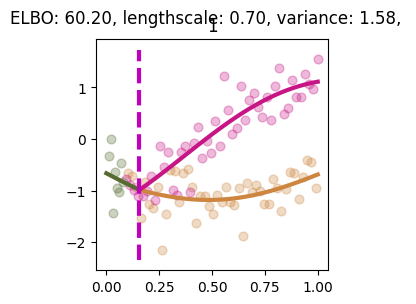

Slicing for gene 2


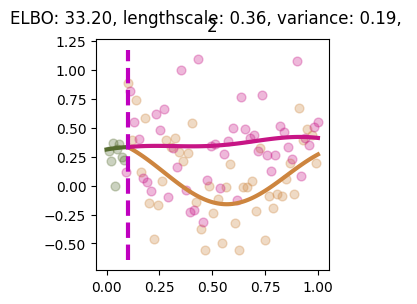

Slicing for gene 3


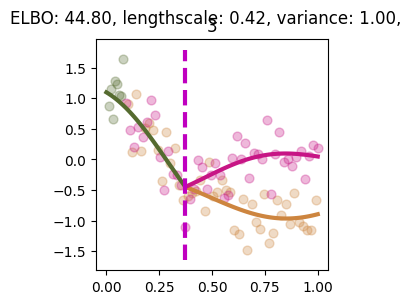

Slicing for gene 4


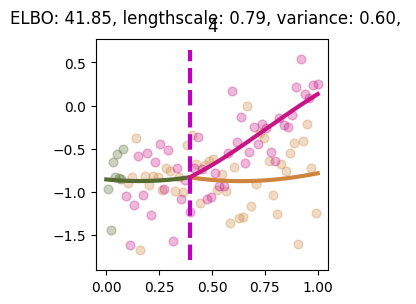

Slicing for gene 5


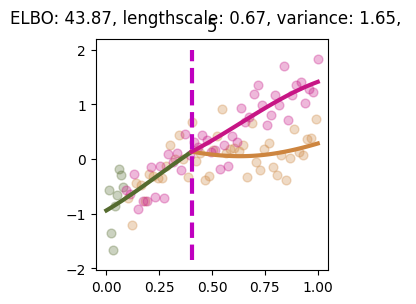

Slicing for gene 6


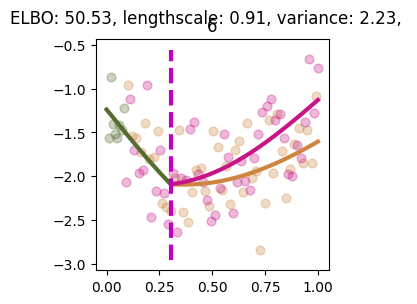

Slicing for gene 7


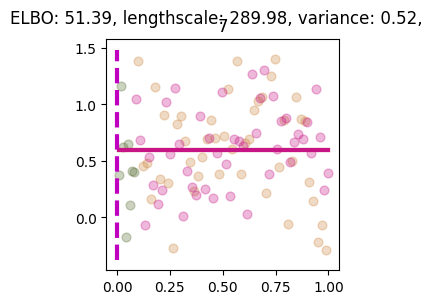

Slicing for gene 8


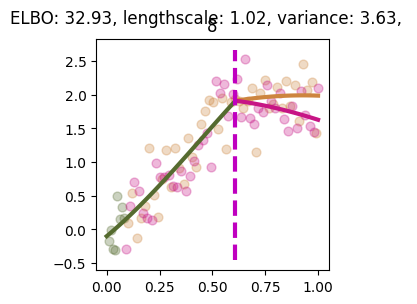

Slicing for gene 9


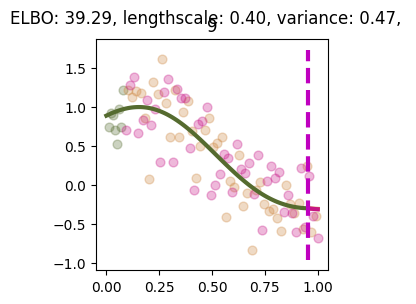

Processing sample 4


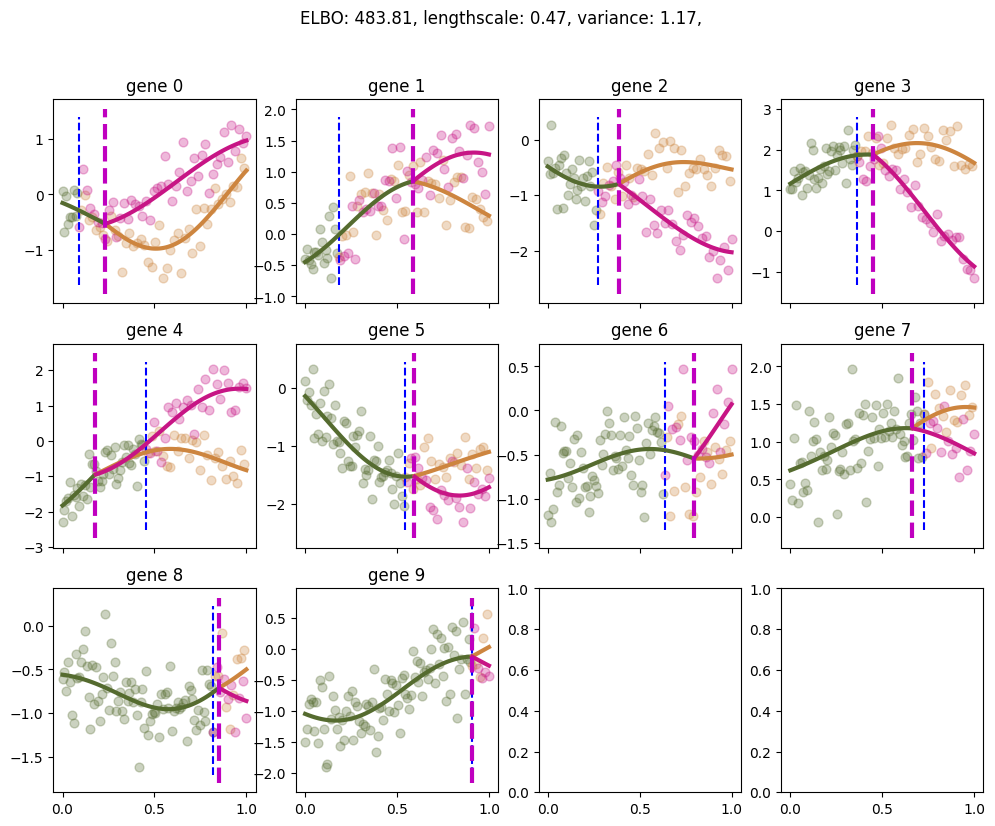

Slicing for gene 0


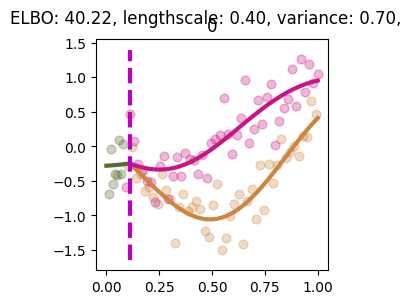

Slicing for gene 1


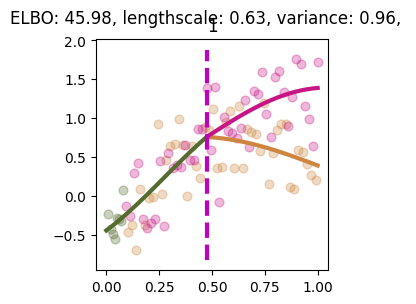

Slicing for gene 2


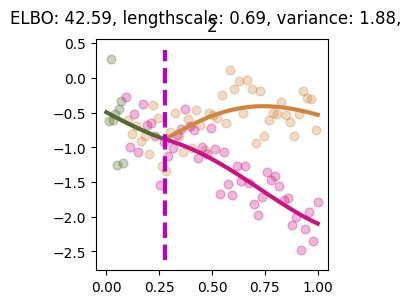

Slicing for gene 3


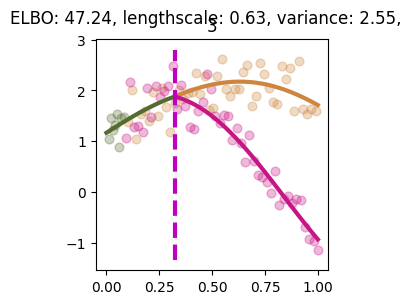

Slicing for gene 4


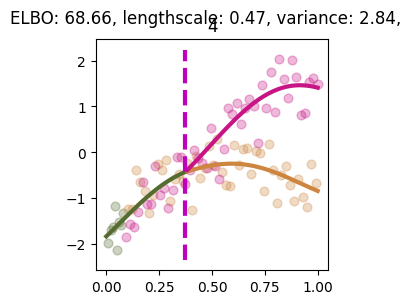

Slicing for gene 5


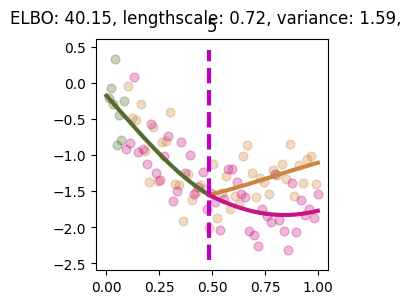

Slicing for gene 6


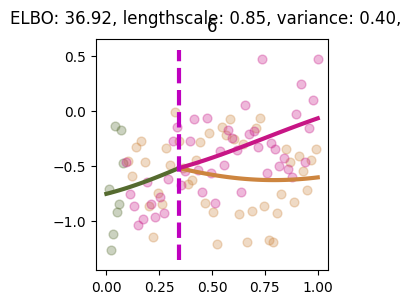

Slicing for gene 7


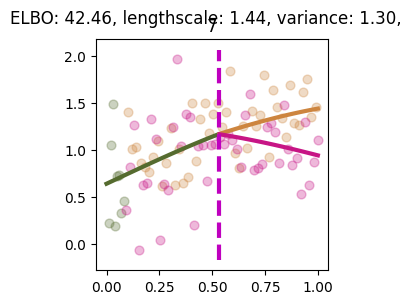

Slicing for gene 8


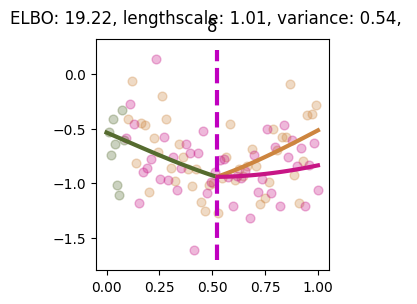

Slicing for gene 9


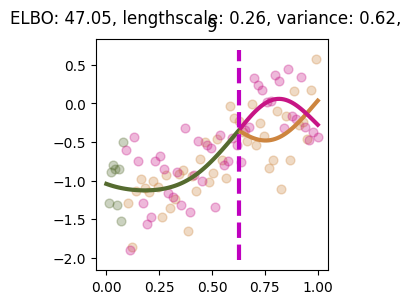

Processing sample 5


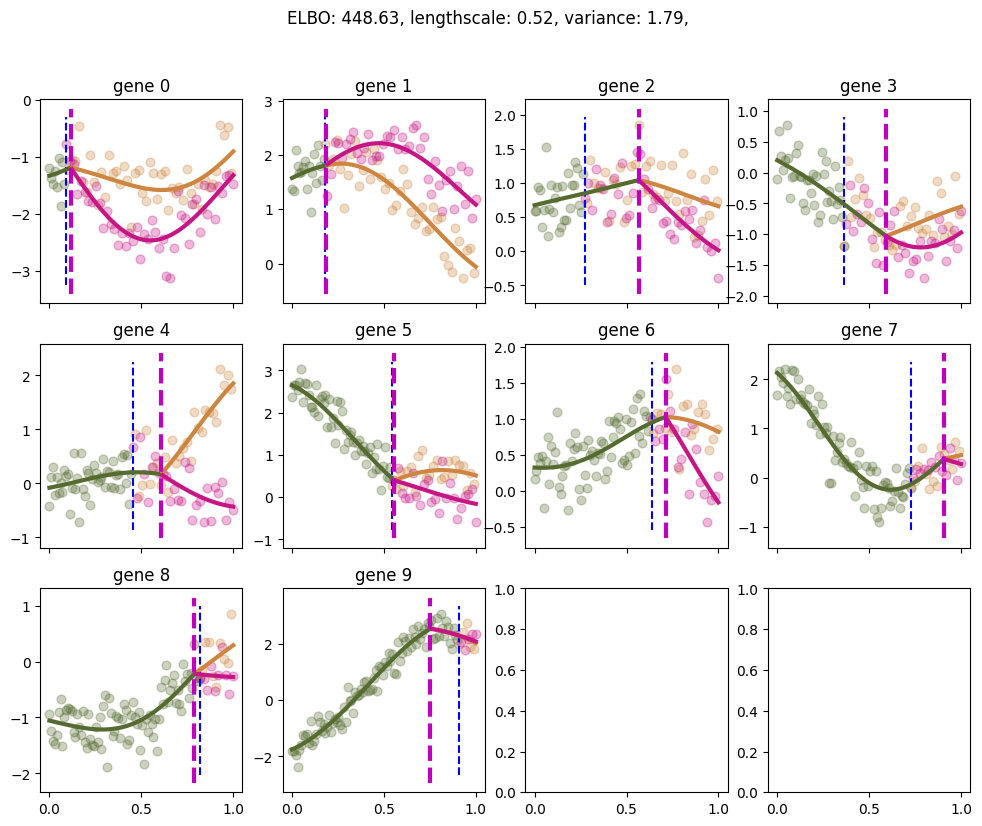

Slicing for gene 0


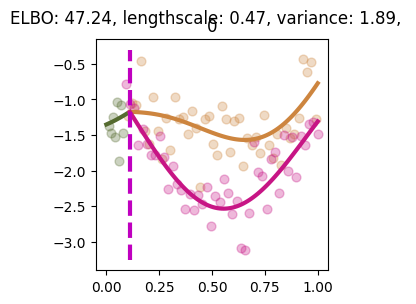

Slicing for gene 1


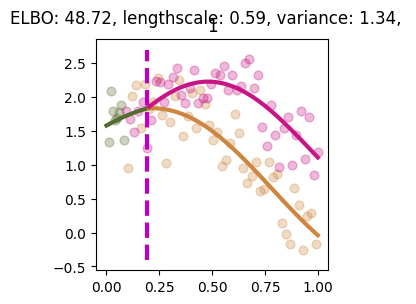

Slicing for gene 2


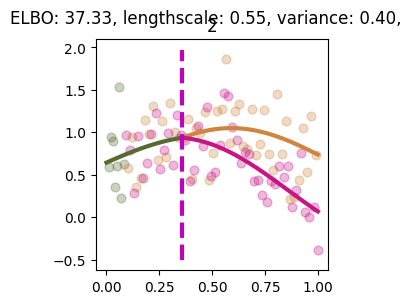

Slicing for gene 3


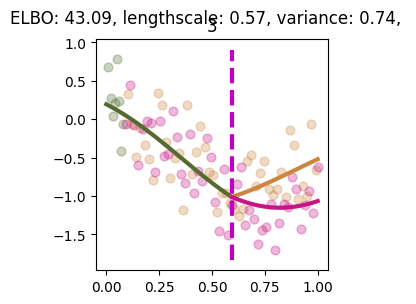

Slicing for gene 4


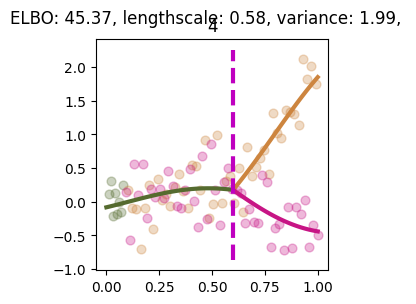

Slicing for gene 5


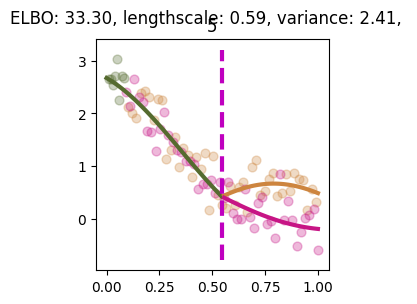

Slicing for gene 6


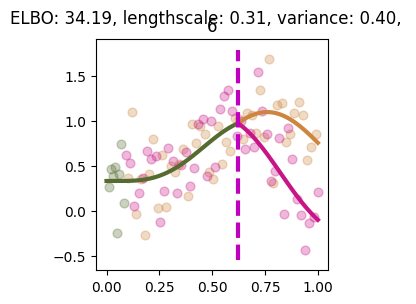

Slicing for gene 7


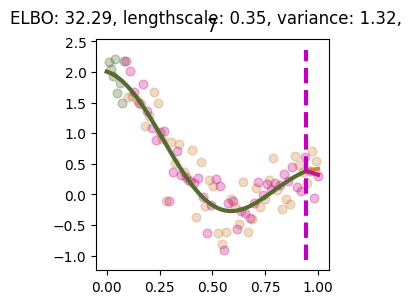

Slicing for gene 8


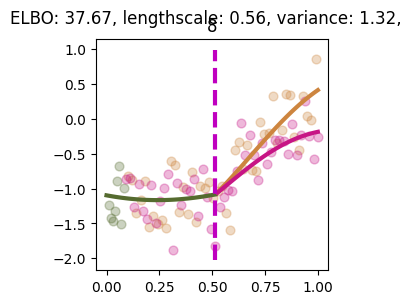

Slicing for gene 9
Error in training: Graph execution error:

Detected at node 'f2f1/invKbb' defined at (most recent call last):
    File "/Users/elvijssarkans/.pyenv/versions/3.10.7/lib/python3.10/runpy.py", line 196, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "/Users/elvijssarkans/.pyenv/versions/3.10.7/lib/python3.10/runpy.py", line 86, in _run_code
      exec(code, run_globals)
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/traitlets/config/application.py", line 1043, in launch_instance
      app.start()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/ipykernel/kernelapp.py", line 725, in start
      self.io_loop.start()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/tornado/platfor

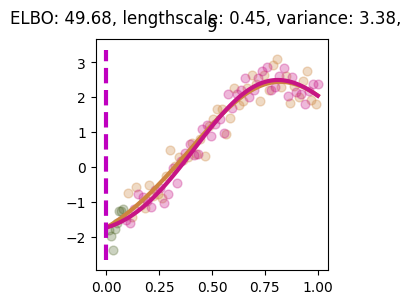

Processing sample 6


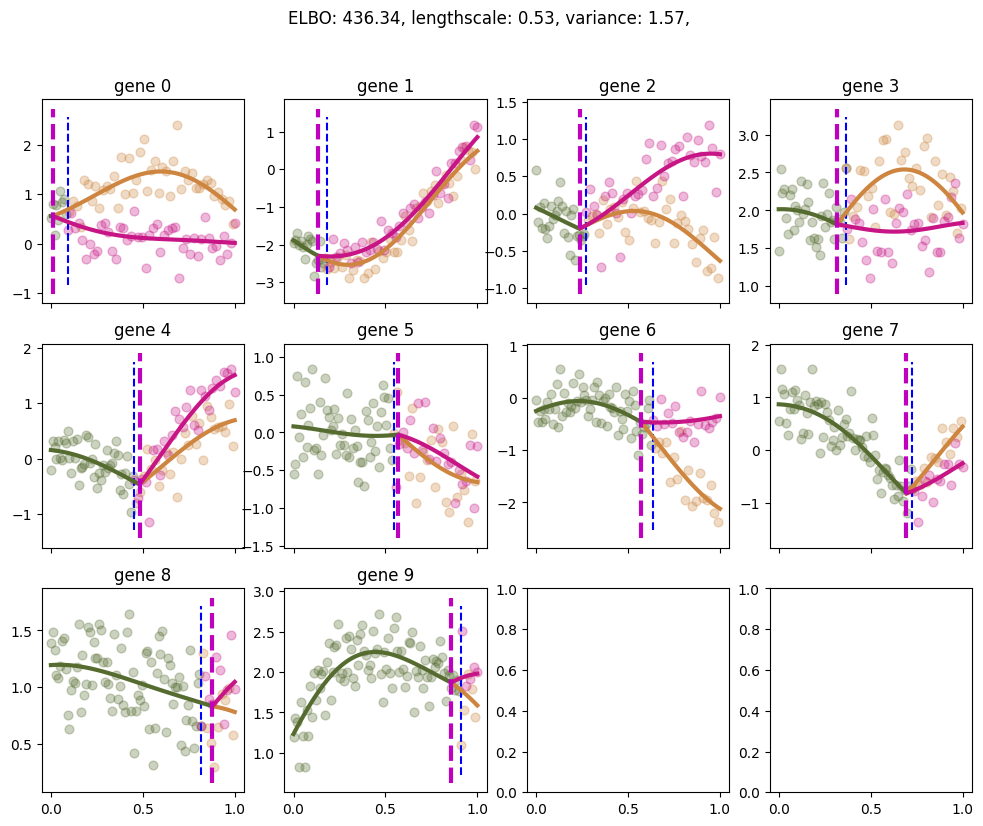

Slicing for gene 0


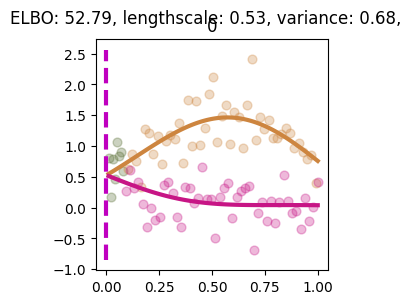

Slicing for gene 1


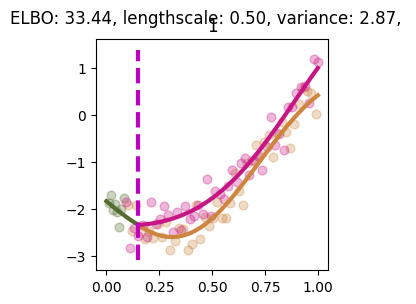

Slicing for gene 2


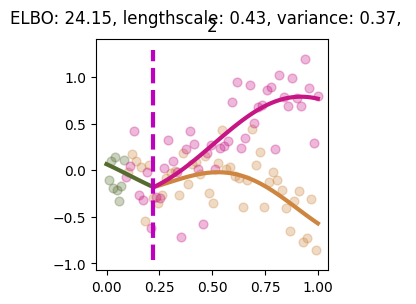

Slicing for gene 3


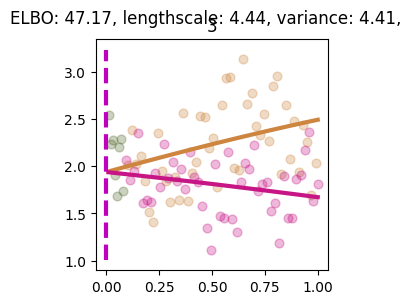

Slicing for gene 4


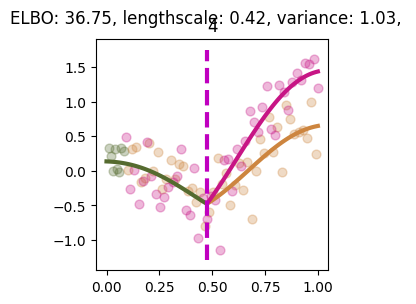

Slicing for gene 5


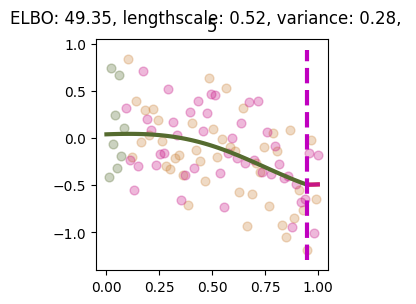

Slicing for gene 6


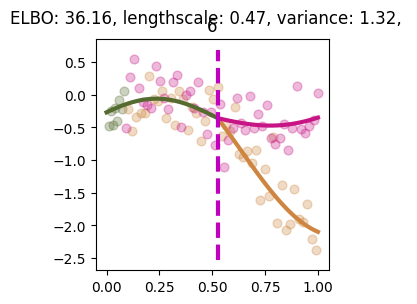

Slicing for gene 7


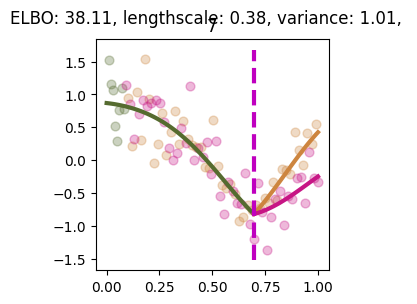

Slicing for gene 8


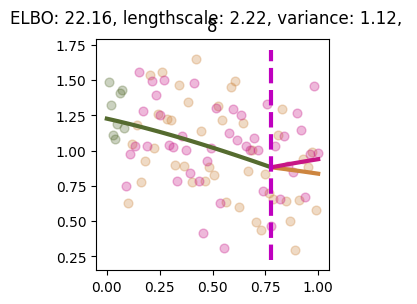

Slicing for gene 9


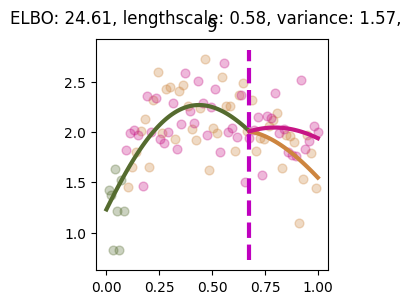

Processing sample 7


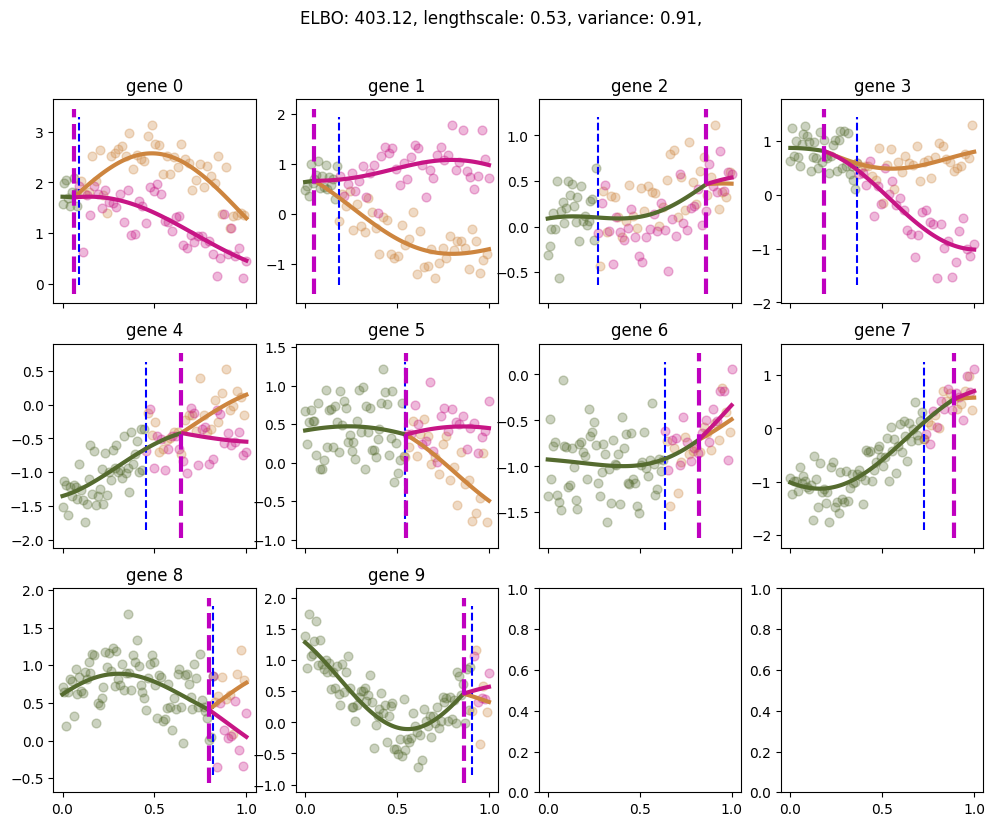

Slicing for gene 0


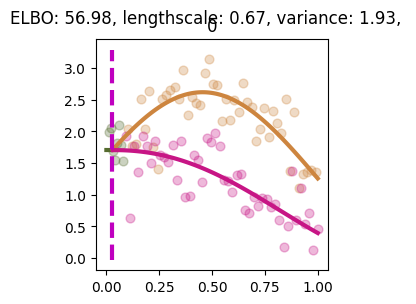

Slicing for gene 1


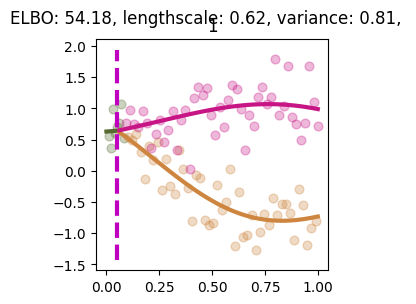

Slicing for gene 2


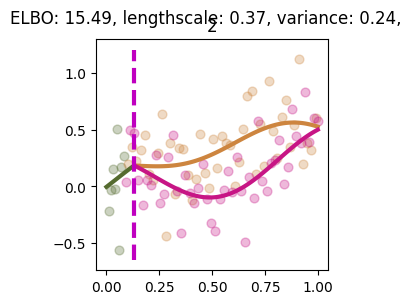

Slicing for gene 3


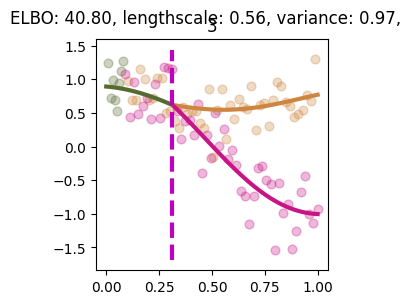

Slicing for gene 4


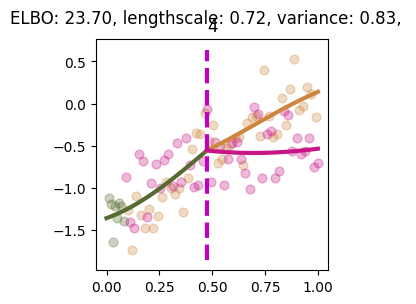

Slicing for gene 5


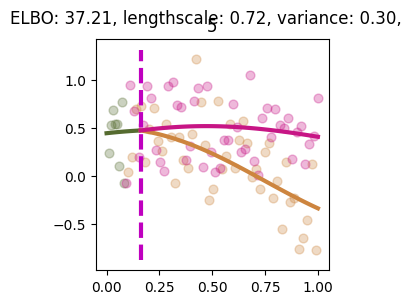

Slicing for gene 6


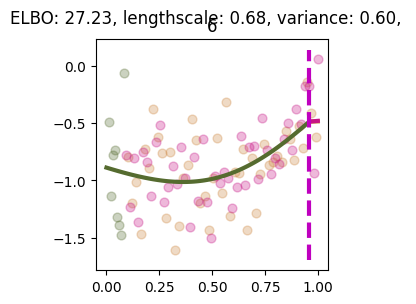

Slicing for gene 7


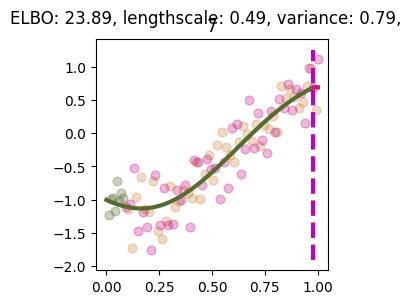

Slicing for gene 8


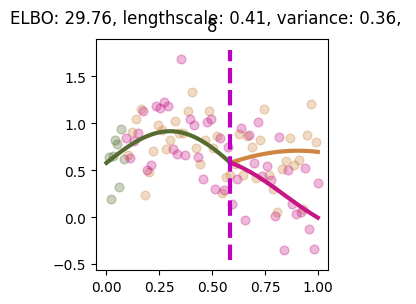

Slicing for gene 9


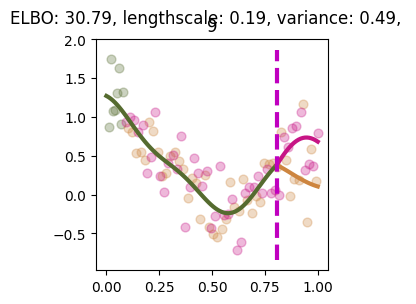

Processing sample 8


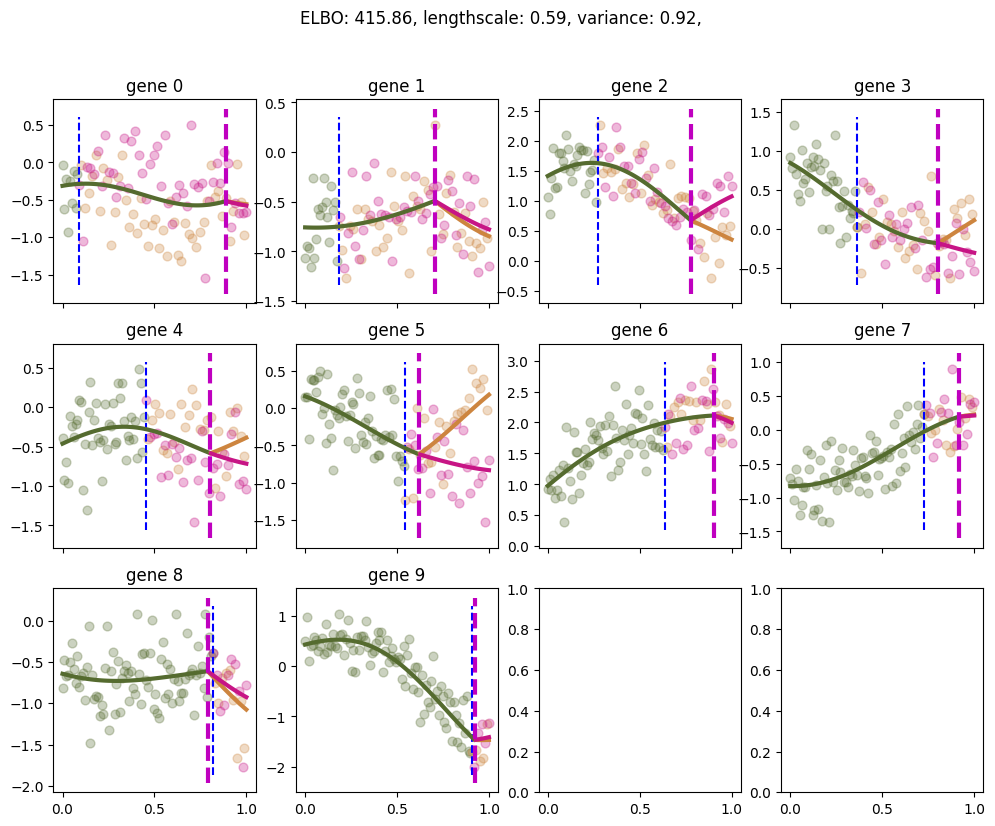

Slicing for gene 0


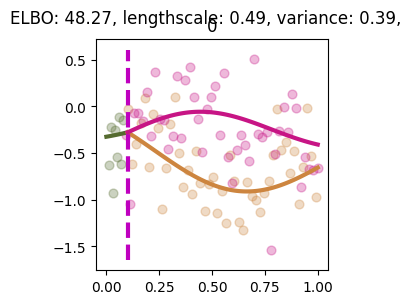

Slicing for gene 1


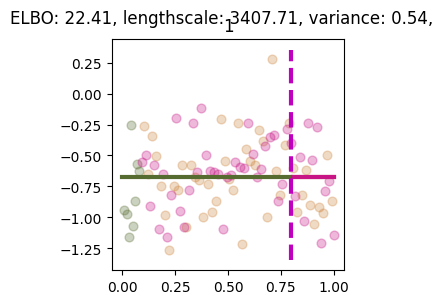

Slicing for gene 2


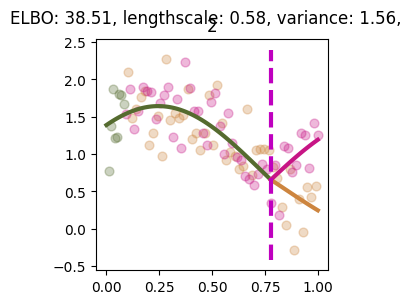

Slicing for gene 3


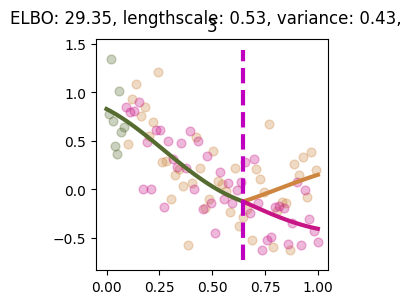

Slicing for gene 4


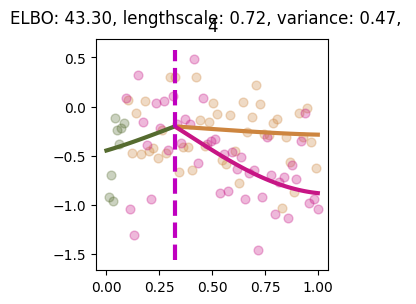

Slicing for gene 5


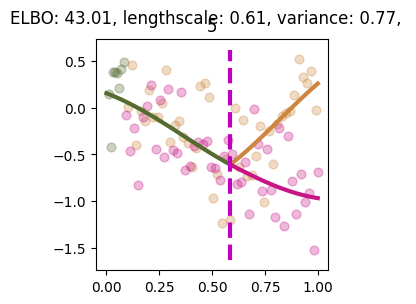

Slicing for gene 6


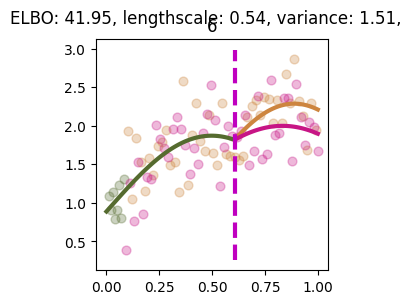

Slicing for gene 7


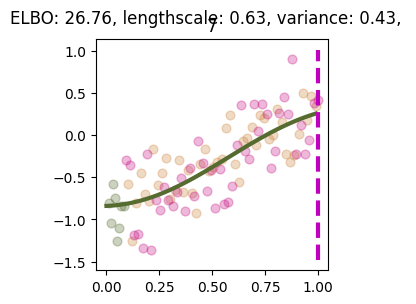

Slicing for gene 8


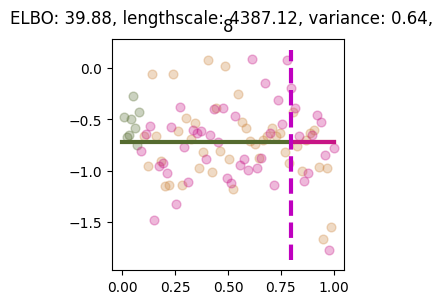

Slicing for gene 9


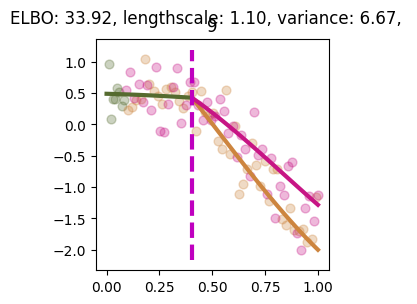

Processing sample 9


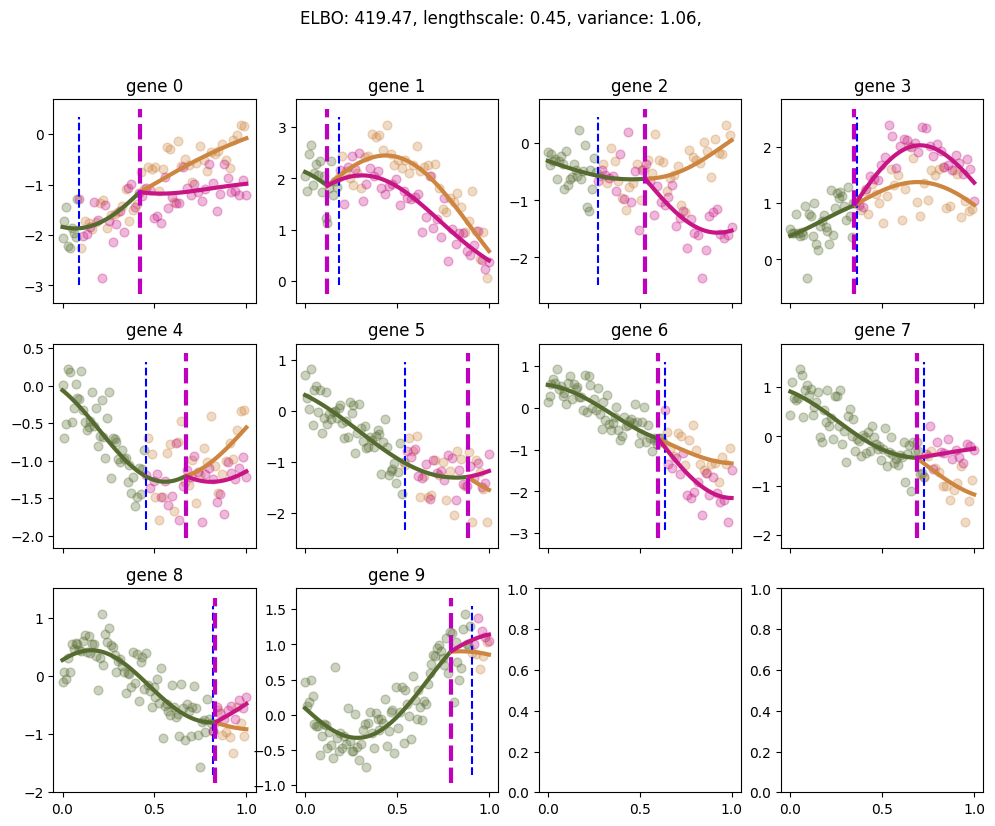

Slicing for gene 0


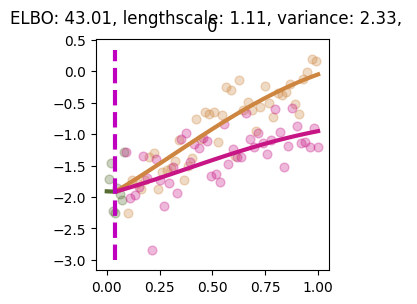

Slicing for gene 1


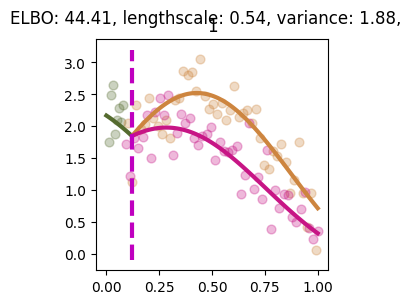

Slicing for gene 2


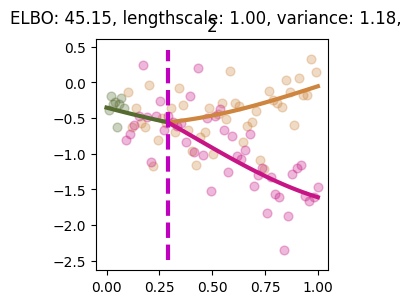

Slicing for gene 3


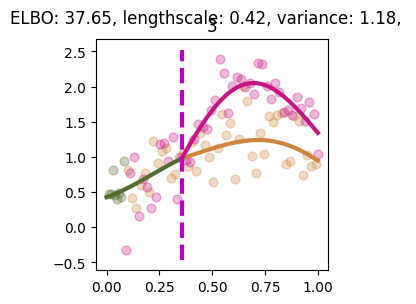

Slicing for gene 4


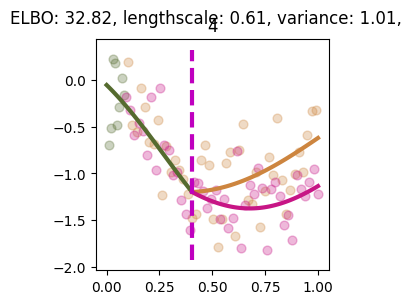

Slicing for gene 5


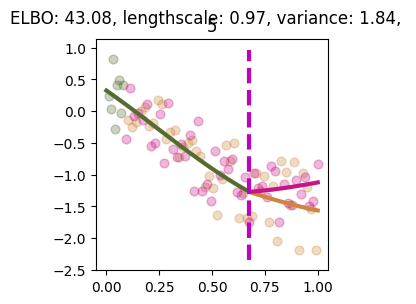

Slicing for gene 6


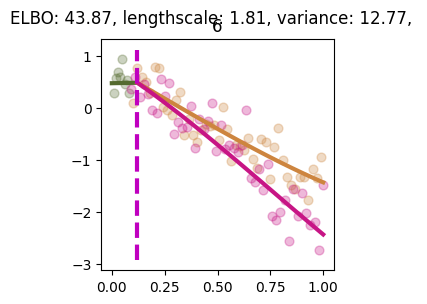

Slicing for gene 7


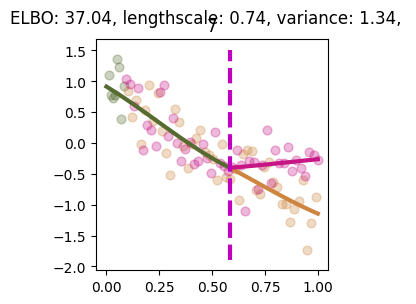

Slicing for gene 8


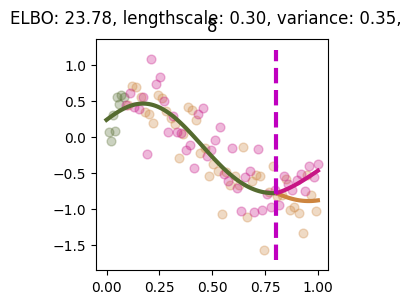

Slicing for gene 9


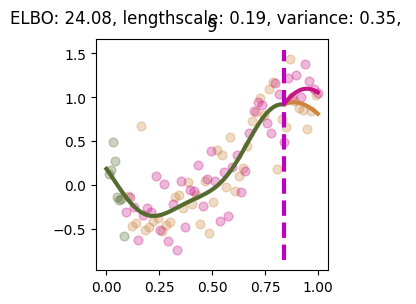

Processing sample 10


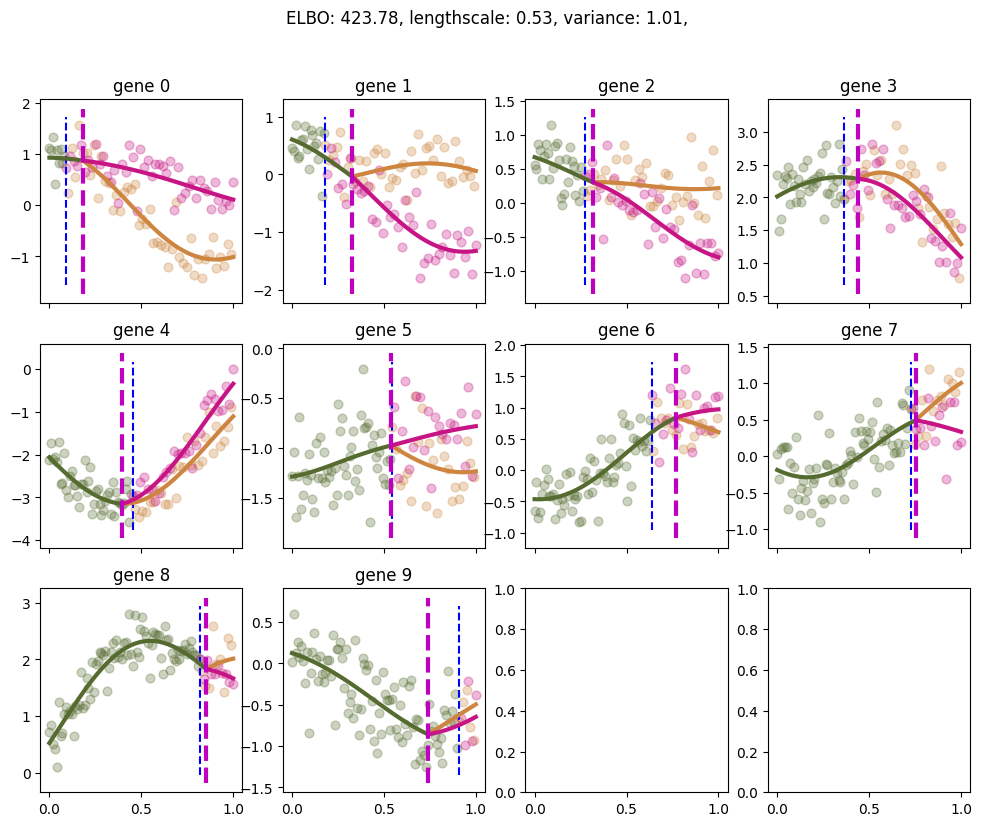

Slicing for gene 0


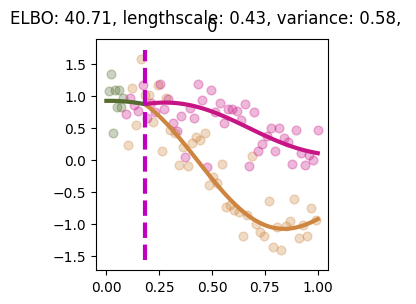

Slicing for gene 1


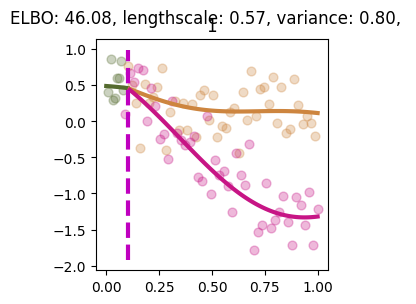

Slicing for gene 2


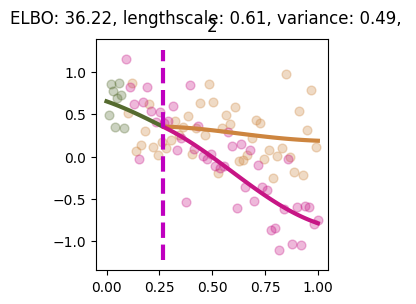

Slicing for gene 3


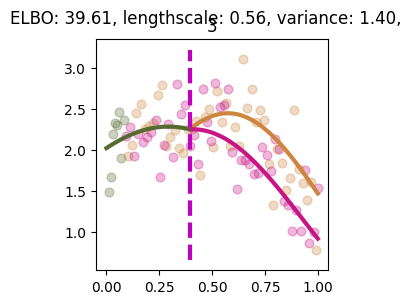

Slicing for gene 4


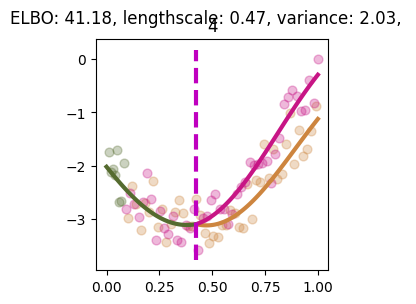

Slicing for gene 5


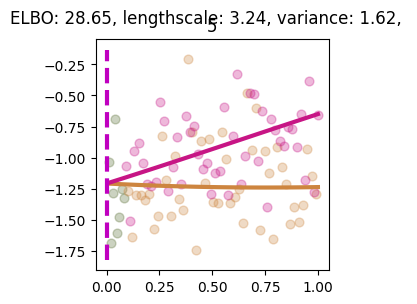

Slicing for gene 6


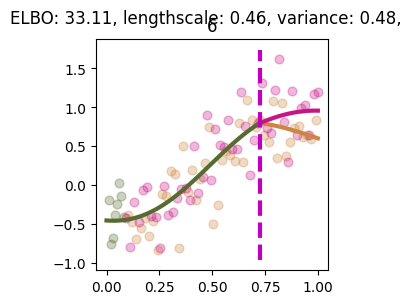

Slicing for gene 7


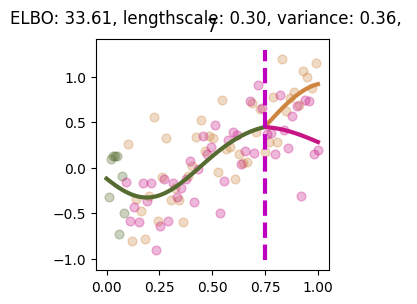

Slicing for gene 8


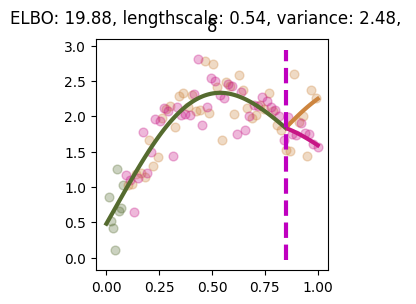

Slicing for gene 9


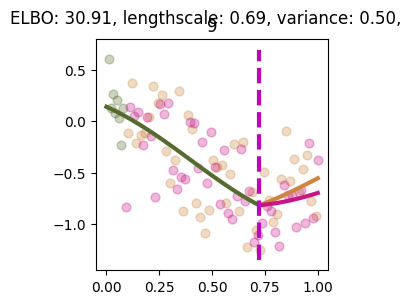

Processing sample 11


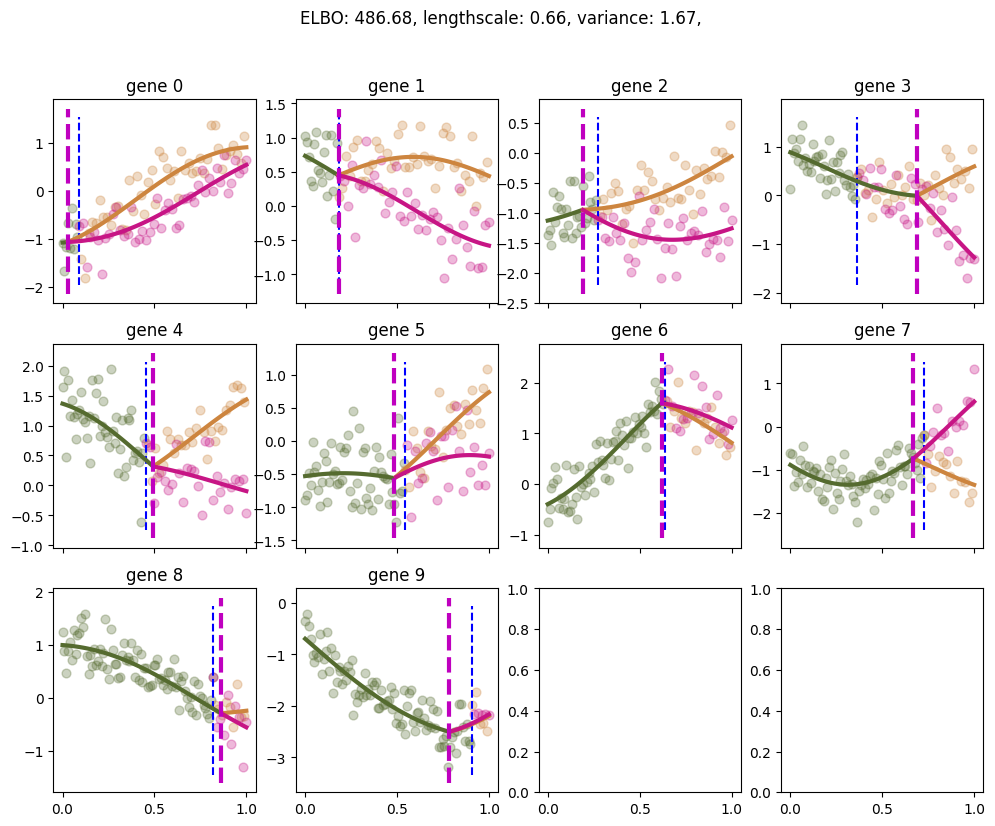

Slicing for gene 0


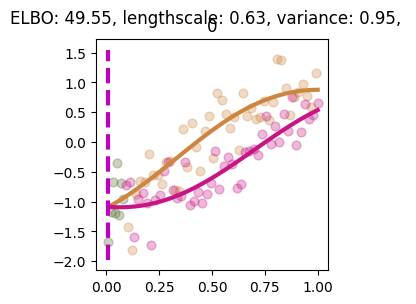

Slicing for gene 1


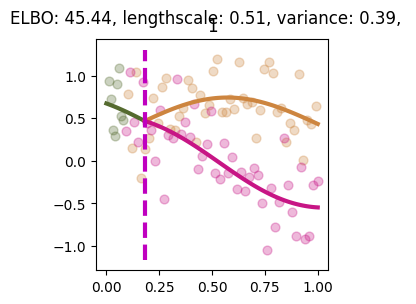

Slicing for gene 2


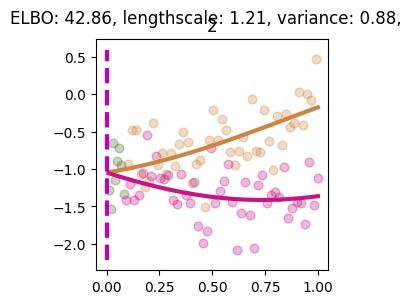

Slicing for gene 3


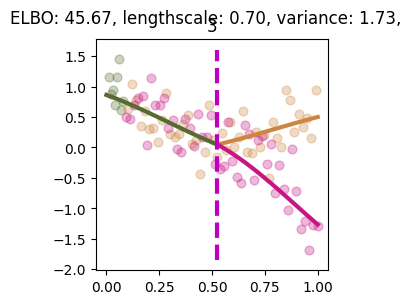

Slicing for gene 4


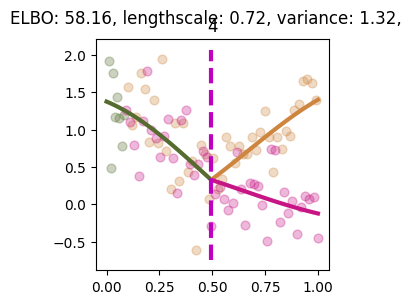

Slicing for gene 5


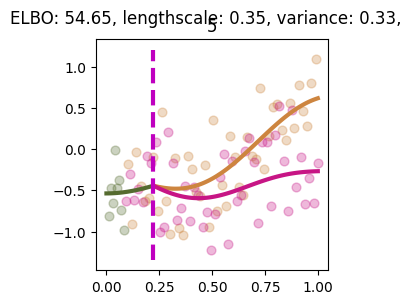

Slicing for gene 6


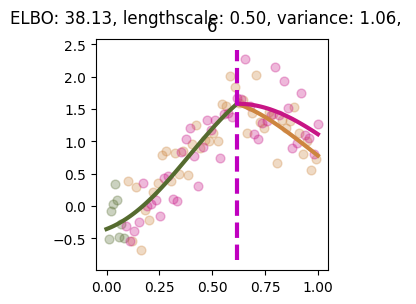

Slicing for gene 7


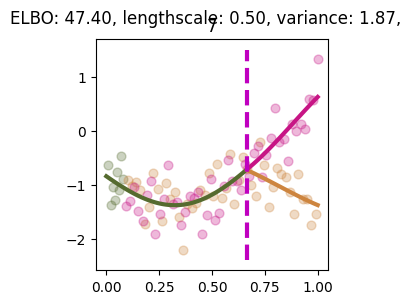

Slicing for gene 8


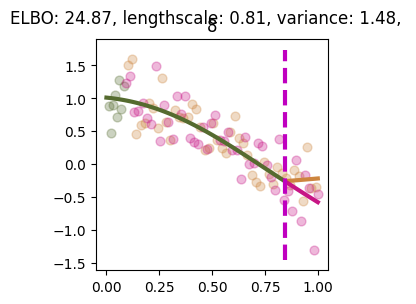

Slicing for gene 9


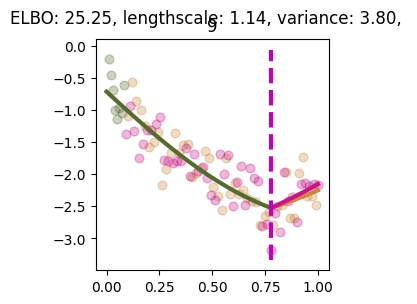

Processing sample 12


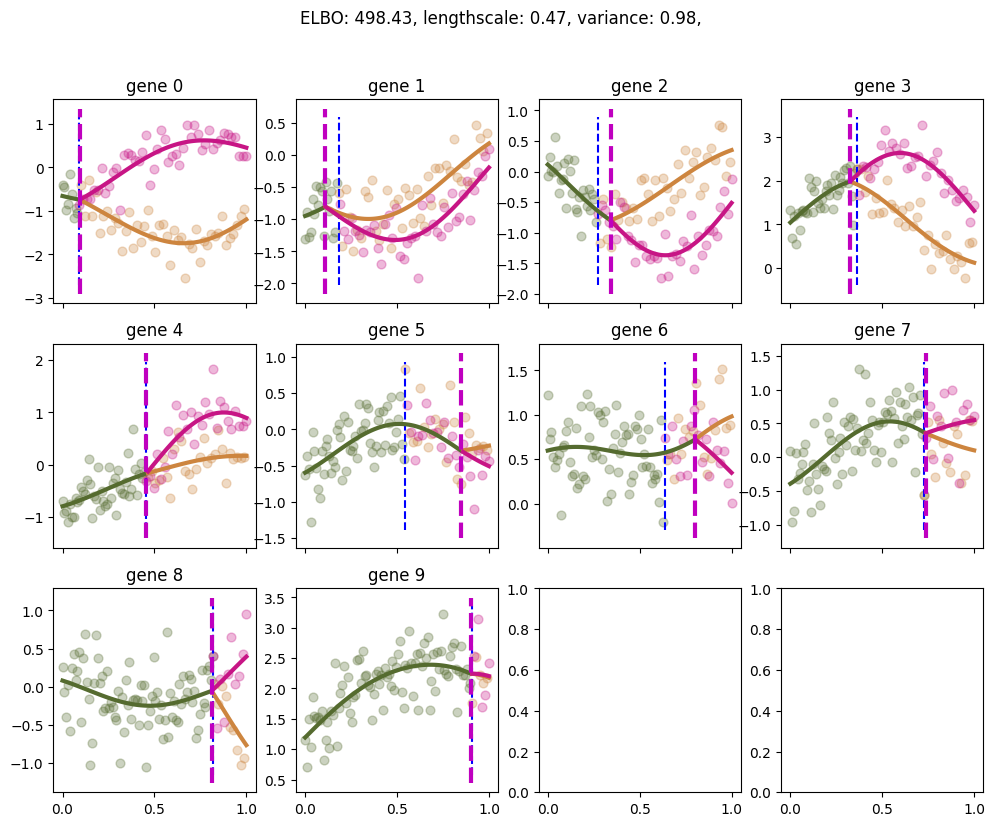

Slicing for gene 0


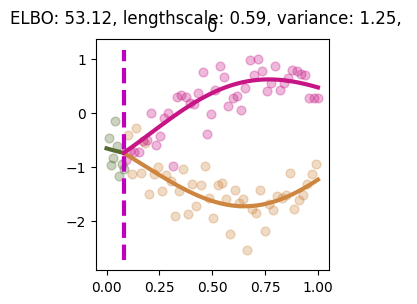

Slicing for gene 1


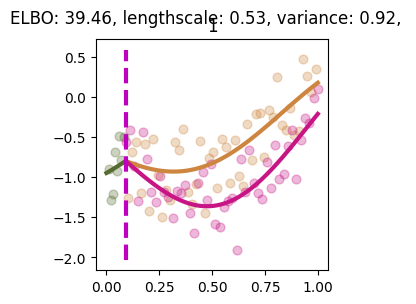

Slicing for gene 2


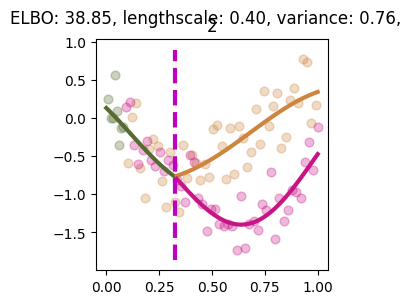

Slicing for gene 3


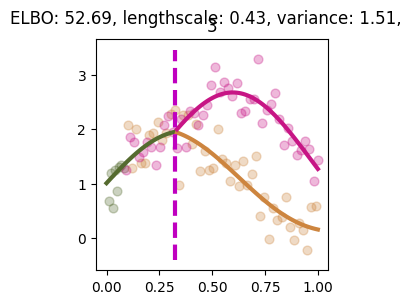

Slicing for gene 4


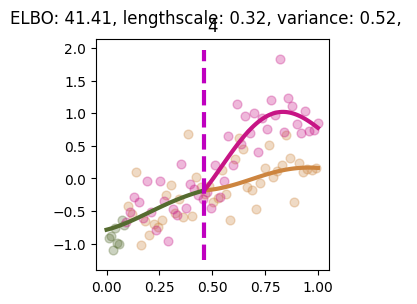

Slicing for gene 5


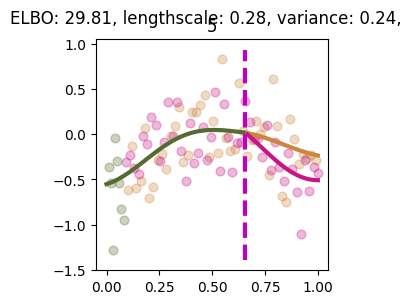

Slicing for gene 6


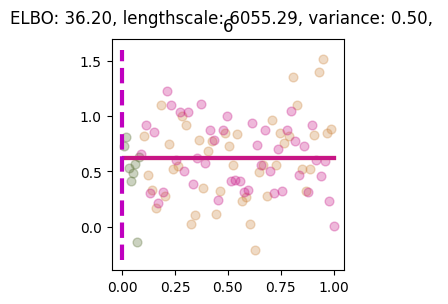

Slicing for gene 7


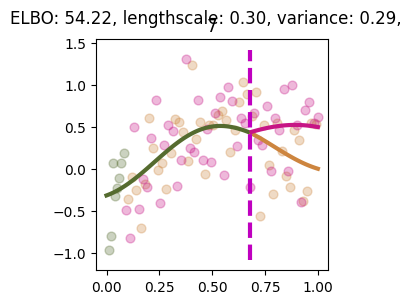

Slicing for gene 8


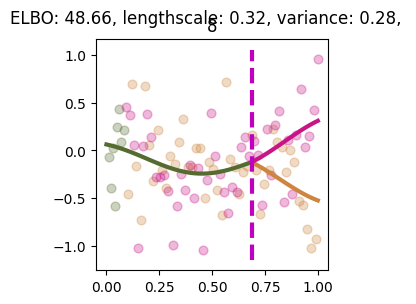

Slicing for gene 9


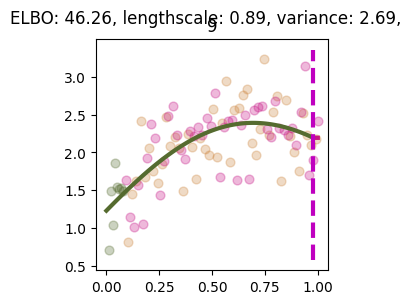

Processing sample 13


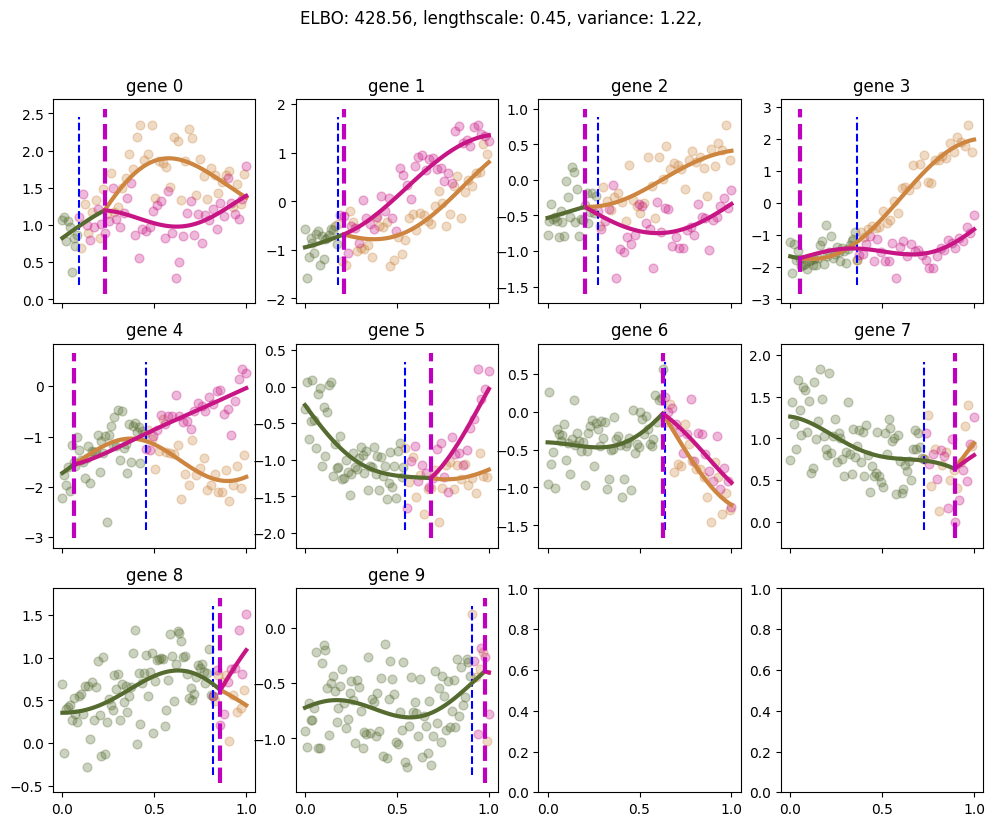

Slicing for gene 0


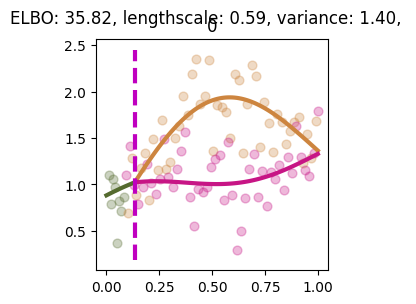

Slicing for gene 1


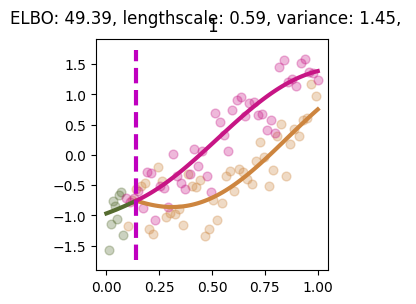

Slicing for gene 2


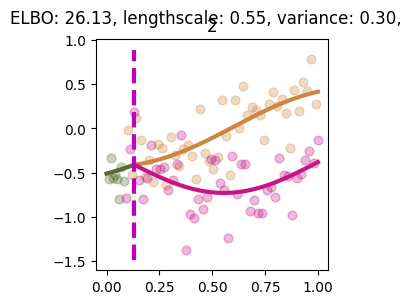

Slicing for gene 3


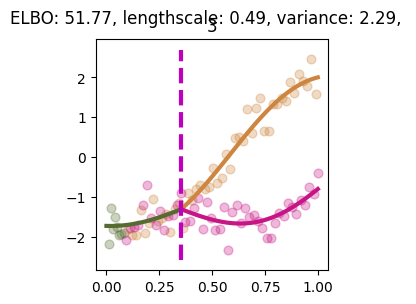

Slicing for gene 4


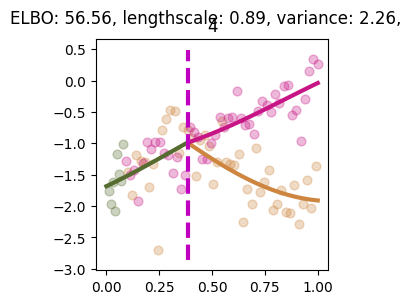

Slicing for gene 5


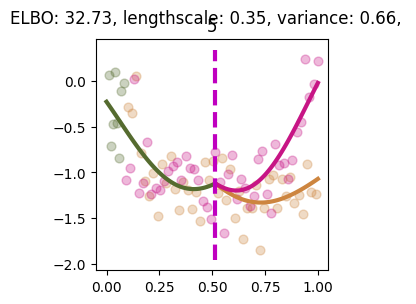

Slicing for gene 6


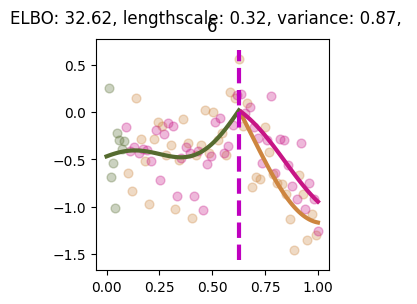

Slicing for gene 7


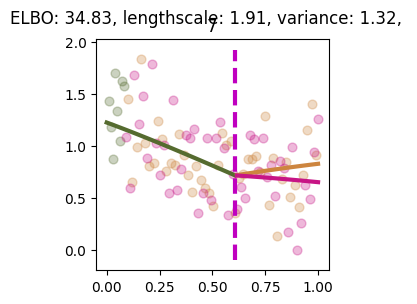

Slicing for gene 8


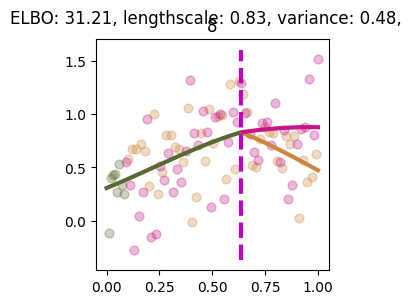

Slicing for gene 9


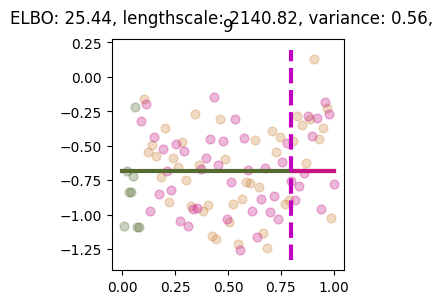

Processing sample 14


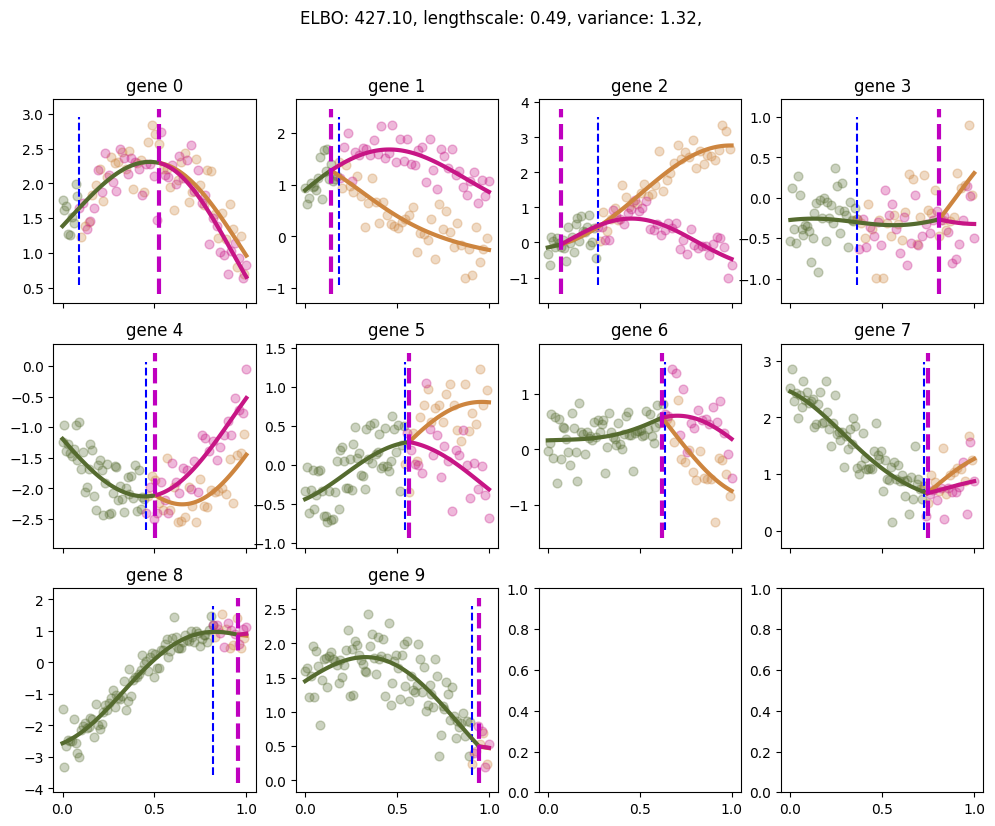

Slicing for gene 0


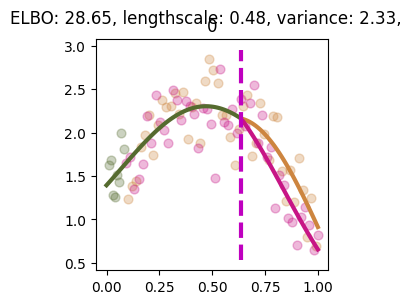

Slicing for gene 1


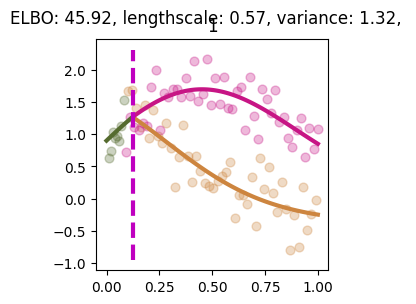

Slicing for gene 2


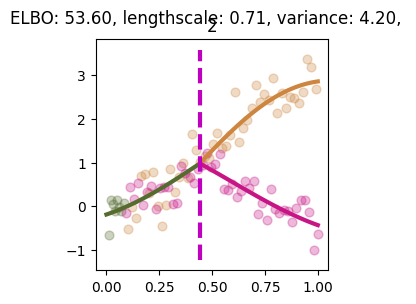

Slicing for gene 3


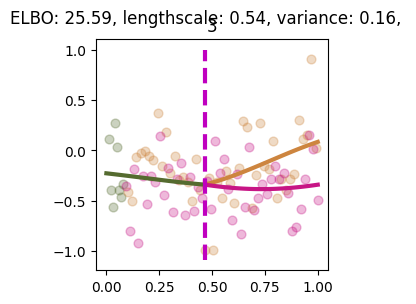

Slicing for gene 4


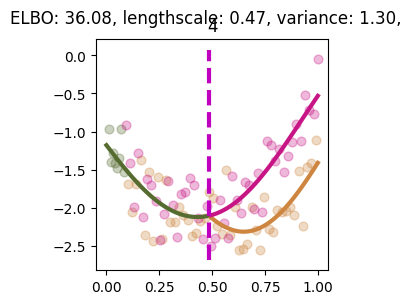

Slicing for gene 5


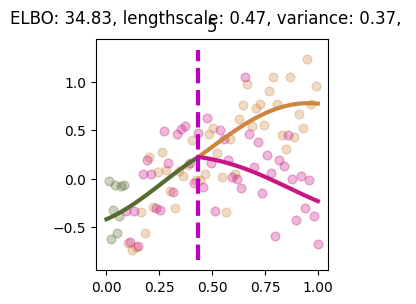

Slicing for gene 6


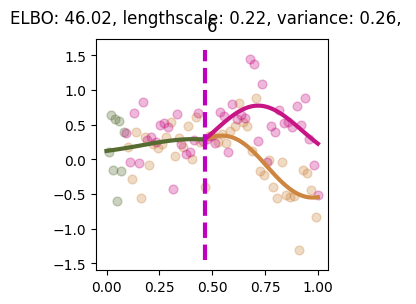

Slicing for gene 7


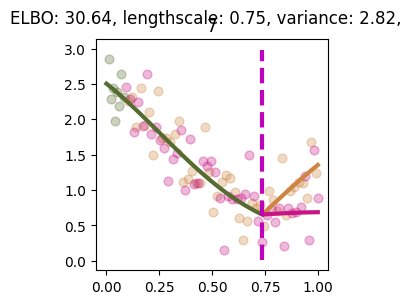

Slicing for gene 8


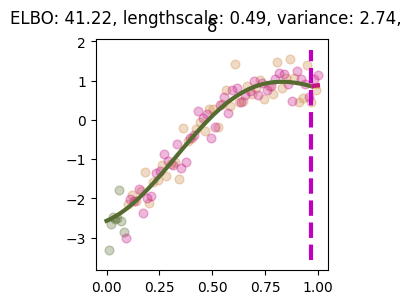

Slicing for gene 9


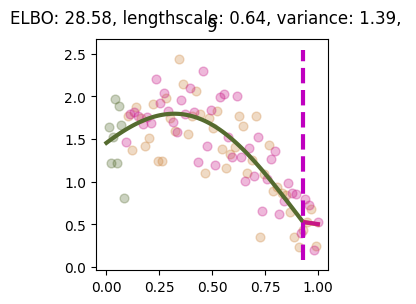

Processing sample 15


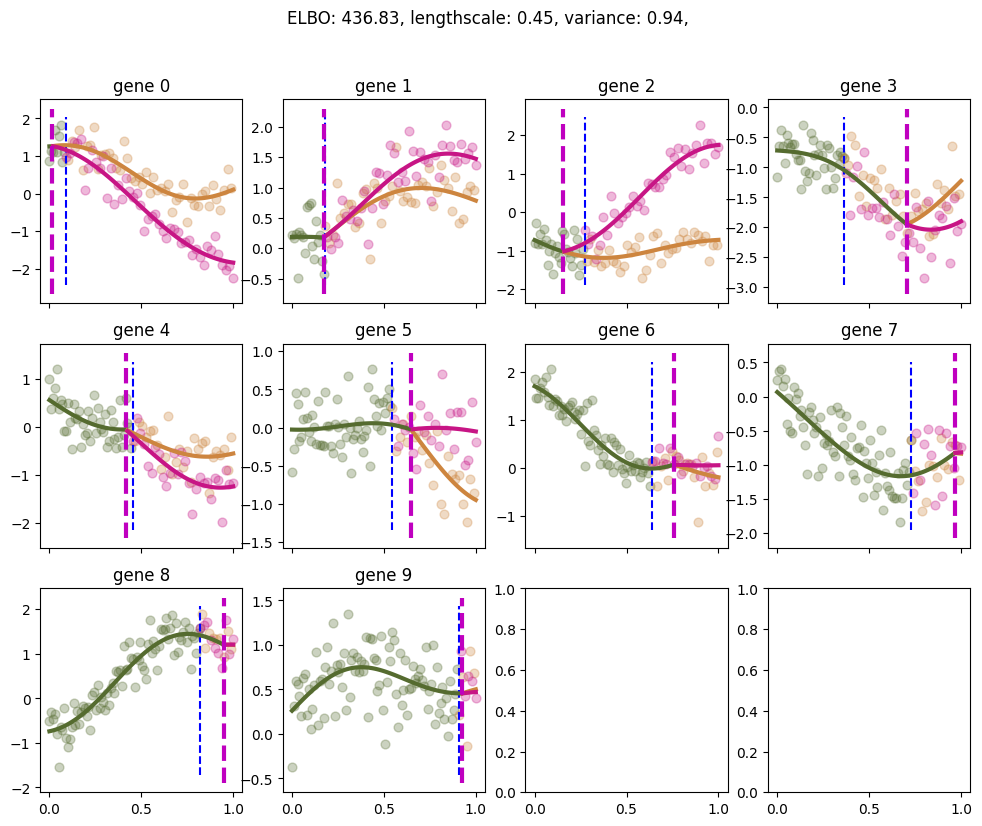

Slicing for gene 0


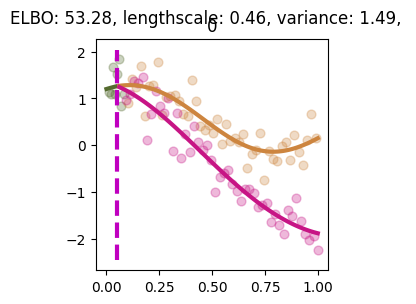

Slicing for gene 1


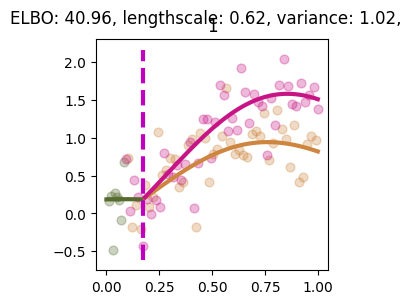

Slicing for gene 2


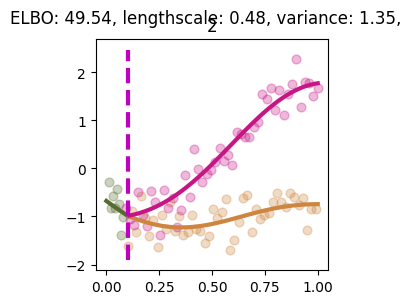

Slicing for gene 3


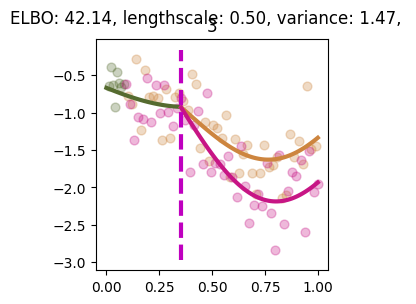

Slicing for gene 4


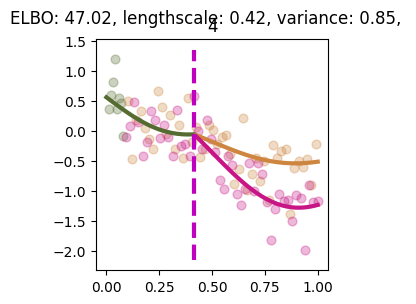

Slicing for gene 5


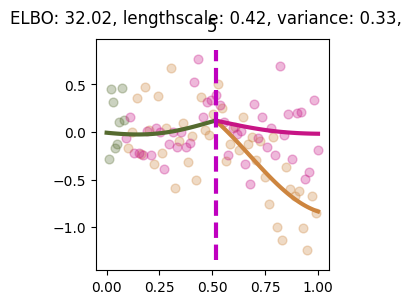

Slicing for gene 6


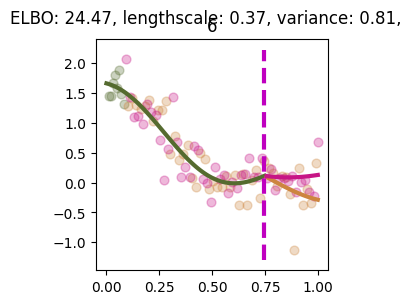

Slicing for gene 7


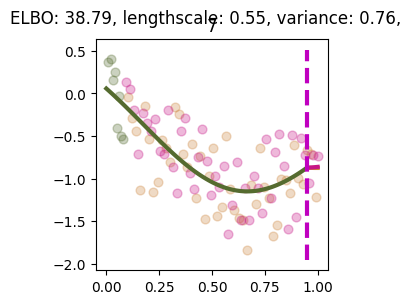

Slicing for gene 8


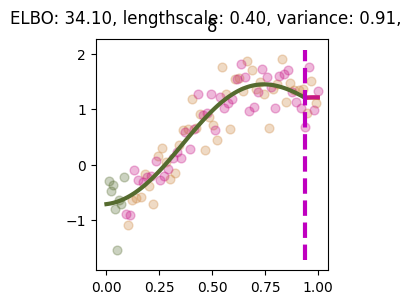

Slicing for gene 9


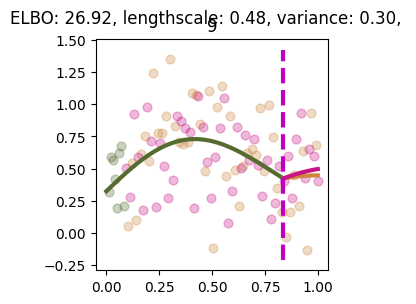

Processing sample 16


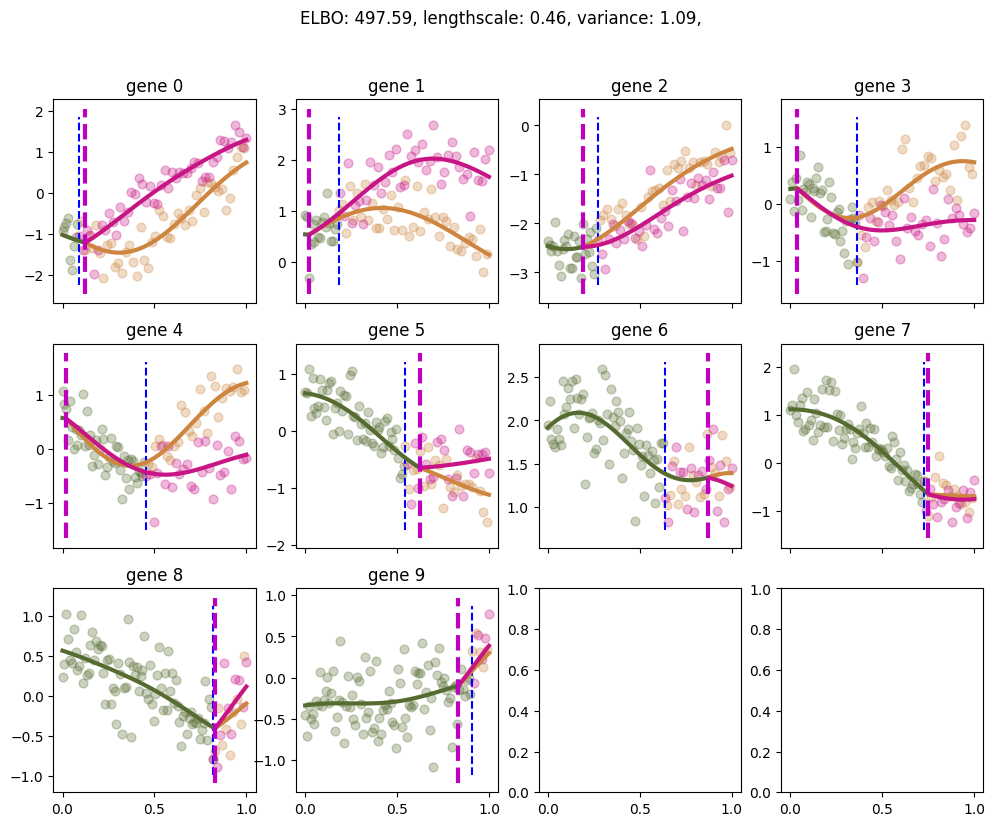

Slicing for gene 0


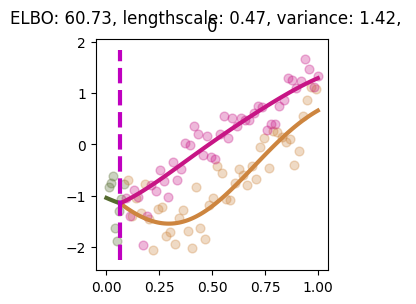

Slicing for gene 1


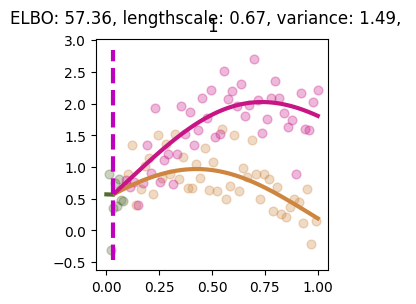

Slicing for gene 2


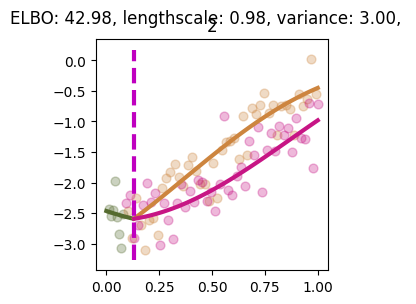

Slicing for gene 3


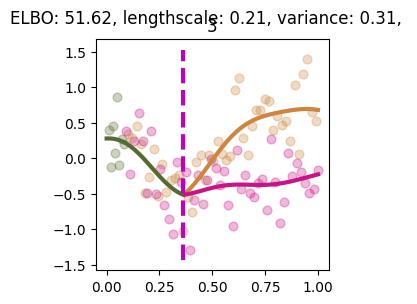

Slicing for gene 4


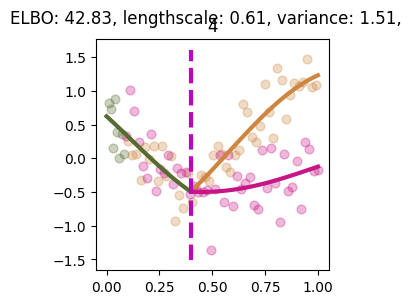

Slicing for gene 5


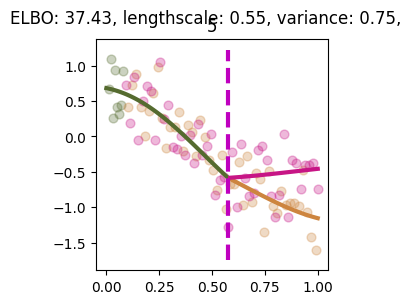

Slicing for gene 6


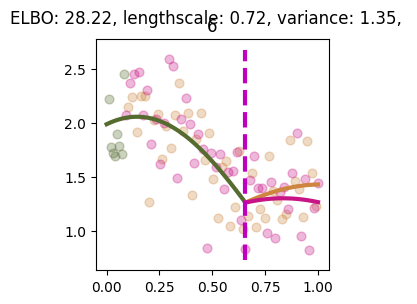

Slicing for gene 7


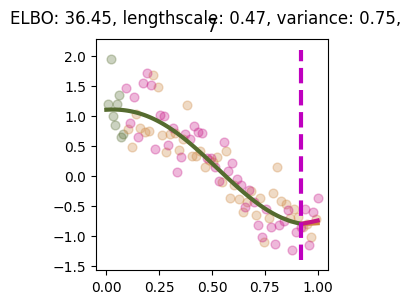

Slicing for gene 8


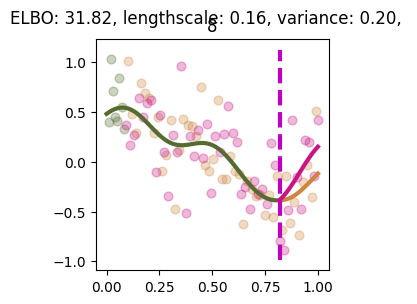

Slicing for gene 9


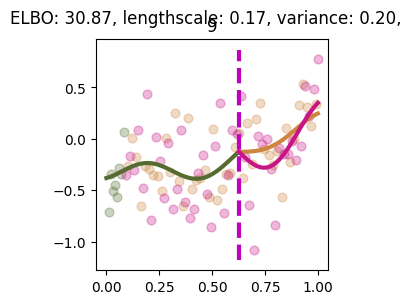

Processing sample 17


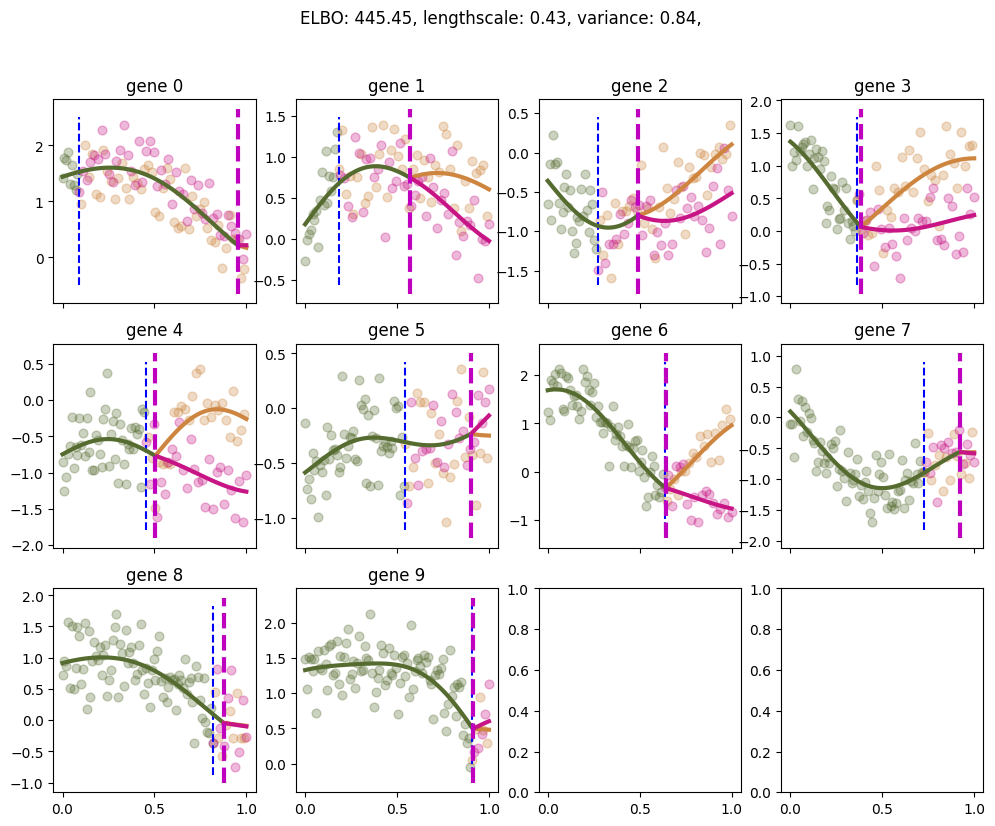

Slicing for gene 0


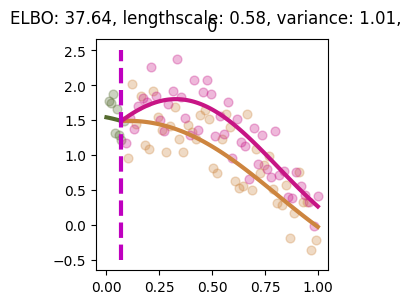

Slicing for gene 1


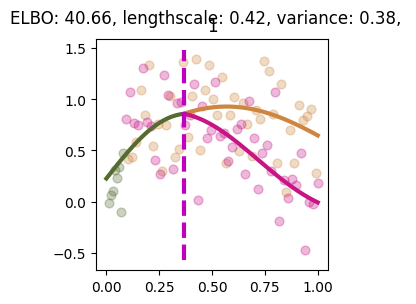

Slicing for gene 2


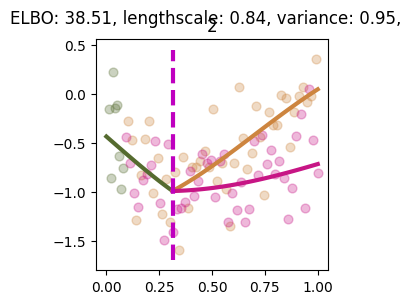

Slicing for gene 3


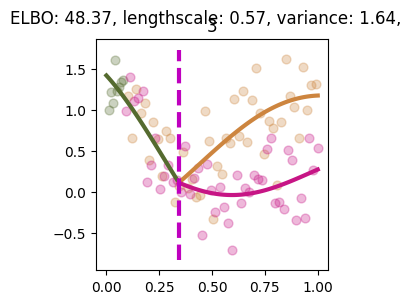

Slicing for gene 4


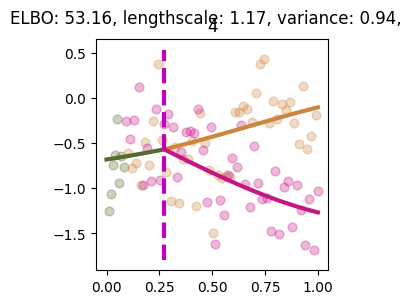

Slicing for gene 5


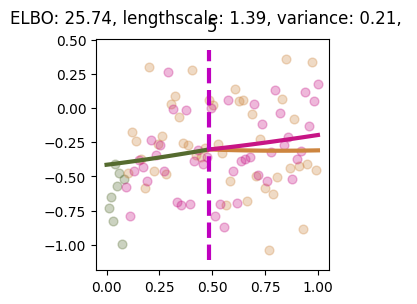

Slicing for gene 6


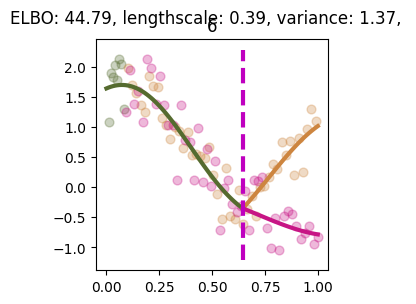

Slicing for gene 7


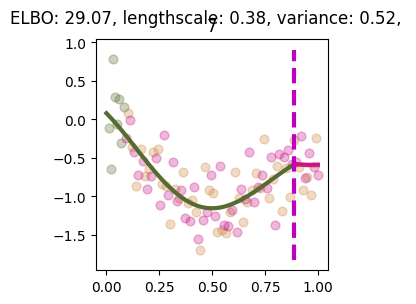

Slicing for gene 8


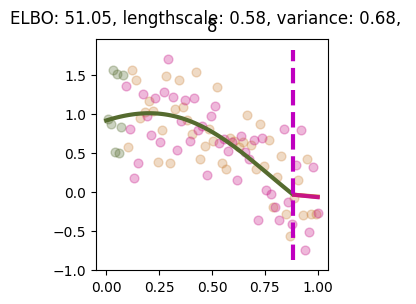

Slicing for gene 9


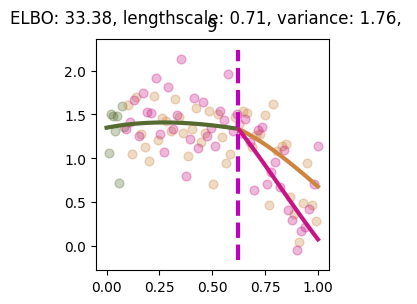

Processing sample 18


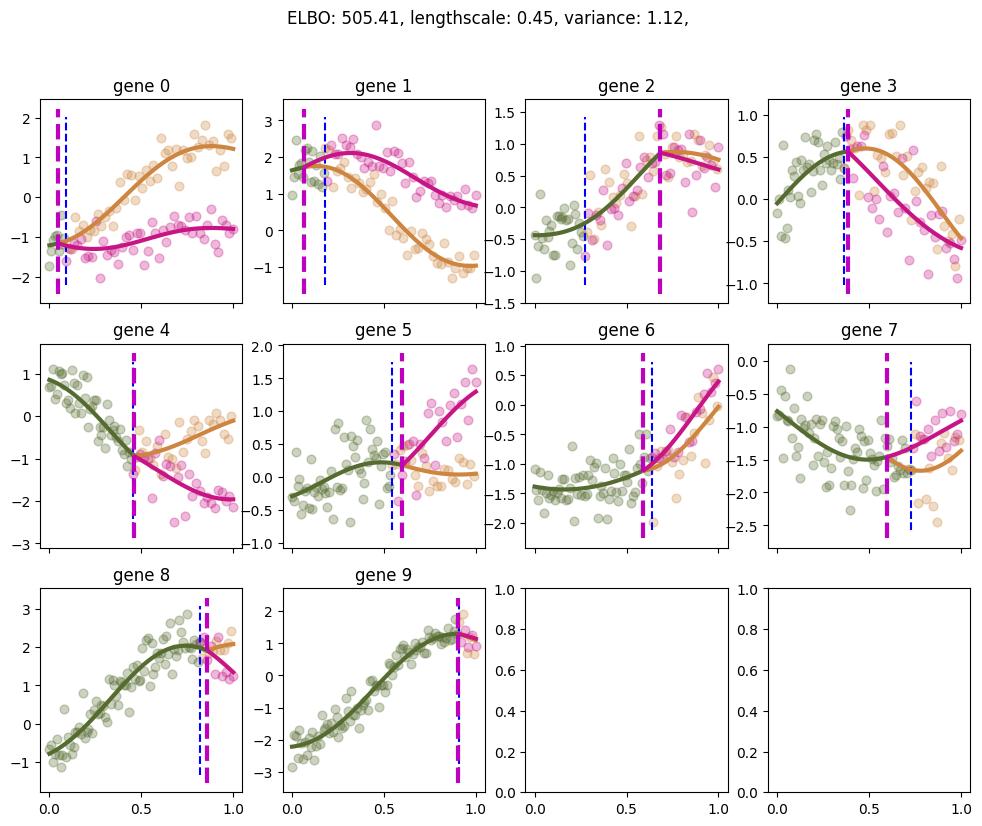

Slicing for gene 0


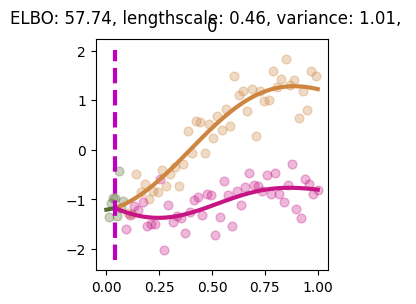

Slicing for gene 1


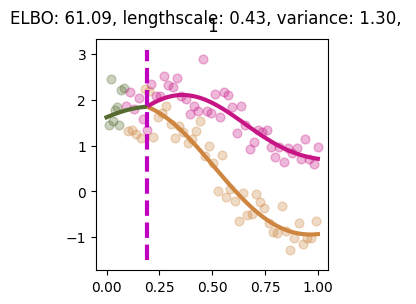

Slicing for gene 2


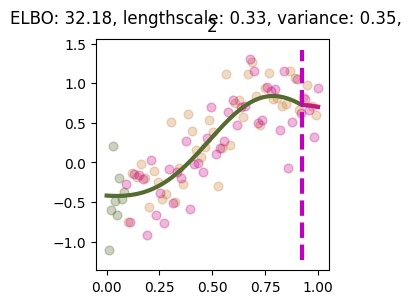

Slicing for gene 3


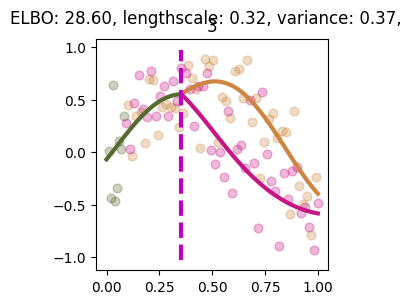

Slicing for gene 4


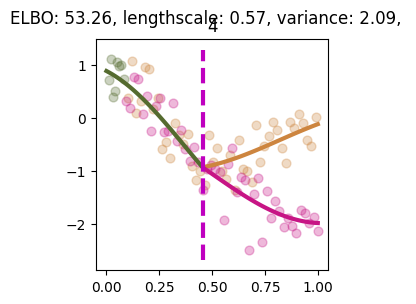

Slicing for gene 5


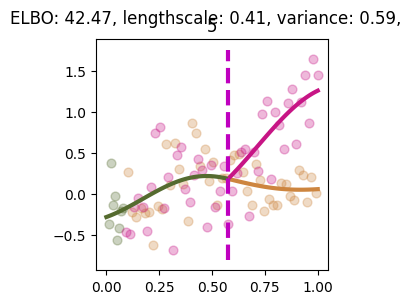

Slicing for gene 6


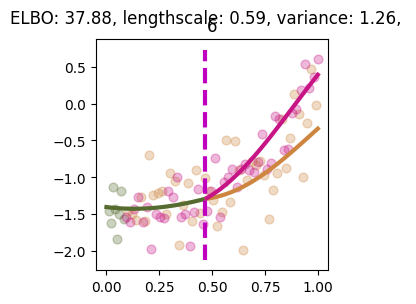

Slicing for gene 7


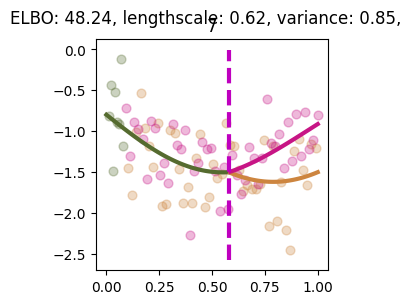

Slicing for gene 8


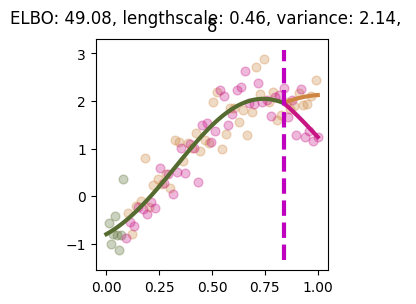

Slicing for gene 9


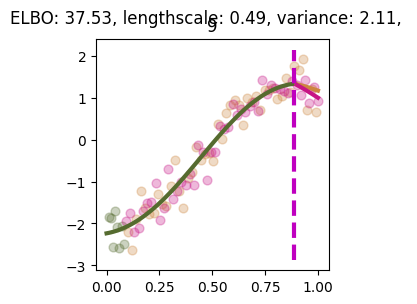

Processing sample 19


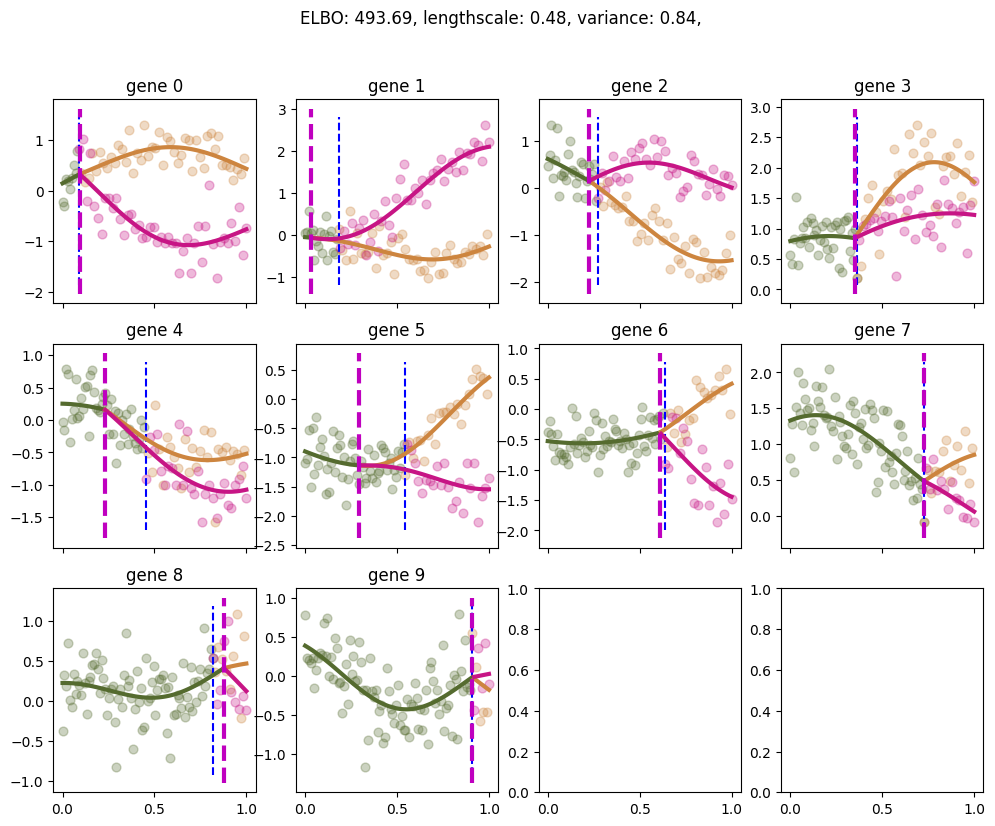

Slicing for gene 0


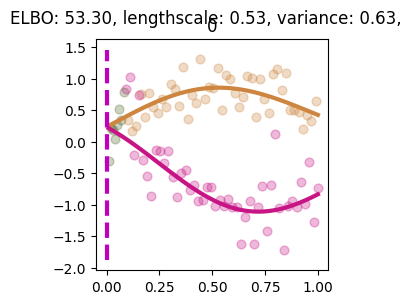

Slicing for gene 1


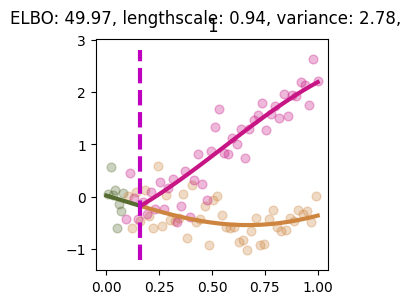

Slicing for gene 2


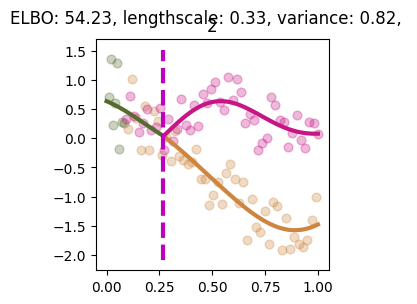

Slicing for gene 3


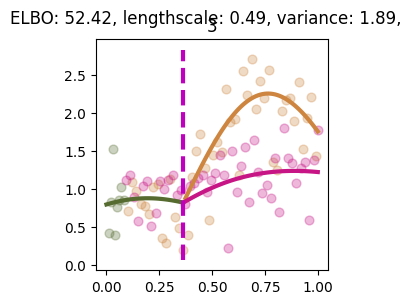

Slicing for gene 4


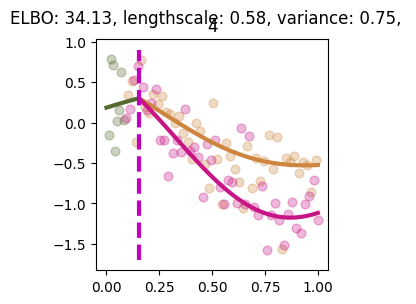

Slicing for gene 5


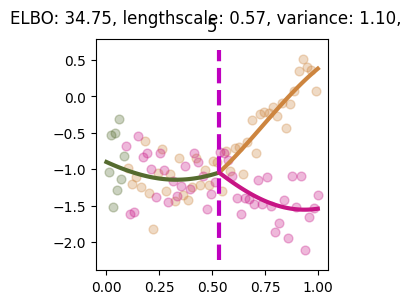

Slicing for gene 6


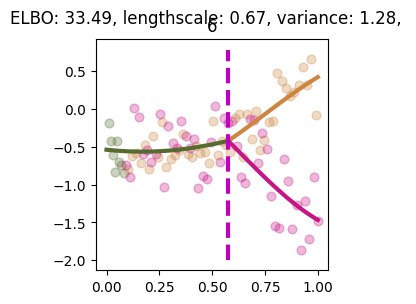

Slicing for gene 7


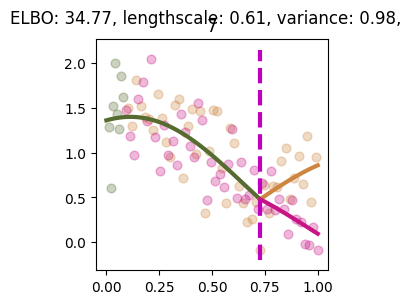

Slicing for gene 8


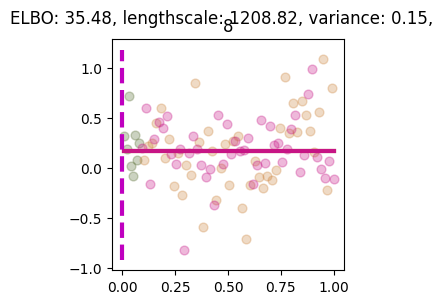

Slicing for gene 9


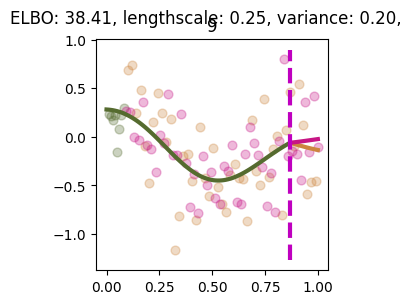

In [8]:
from dataclasses import dataclass
from typing import List


@dataclass
class Result:
    data: GeneExpressionData  # the data we have attempted to fit models to
    true_bps: np.ndarray  # true branching points
    mmbgp: AssignGP  # the trained MMBGP model for the provided data
    bgps: Sequence[AssignGP]  # the trained BGP models for the provided data

        
NOISE = 0.1
LENGTHSCALE = 0.5

NUM_SAMPLES = 20
TRUE_BPS = [i/11 for i in range(1, 11, 1)]


HIGH_PRIOR_CONFIDENCE = 0.8

dummy_model = get_assigngp_with_target_bps(
    TRUE_BPS, 
    lengthscale=LENGTHSCALE, 
    noise_variance=NOISE,
)
synthetic_noisy_data = get_synthetic_noisy_branched_data(
    dummy_model, 
    num_samples=NUM_SAMPLES, 
    x_pts=100,
)

high_prior_confidence_results: List[Result] = []

for i, data in enumerate(synthetic_noisy_data):
    print(f"Processing sample {i}")
    
    #
    # MMBGP
    #
    mmbgp = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=SimplePhiConstructor(sliced_data, HIGH_PRIOR_CONFIDENCE),
        initial_branching_points=[0.5]*10,  # Don't start at the true locations
    )    
    optimiser = ElvijsAmazingOptimiser()
    try:
        trained_mmbgp = optimiser.train(mmbgp)
    except Exception as ex:
        print(f"Error in training: {ex}")
        trained_mmbgp = mmbgp
    
    plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
    plt.show()
    
    #
    # BGPs
    #
    bgps = []

    for i in range(data.num_genes):
        print(f"Slicing for gene {i}")
    
        sliced_data = GeneExpressionData(
            t=data.t,
            Y=data.Y[:, i].reshape(-1, 1),
            state=data.state,
            gene_labels=[f"{i}"]
        )
   
        # new model with default-ey parameter values, but SimplePhiConstructor
        bgp = construct_assigngp_model(
            gene_expression=sliced_data,
            phi_constructor=SimplePhiConstructor(sliced_data, HIGH_PRIOR_CONFIDENCE),
            initial_branching_points=[0.5],  # Don't start at the true locations
        )    
        optimiser = ElvijsAmazingOptimiser()
        try:
            trained_bgp = optimiser.train(bgp)
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_bgp = bgp
            
        plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
        plt.show()
    
        bgps.append(trained_bgp)
    
    result = Result(
        data=data,
        true_bps=np.array(TRUE_BPS),
        mmbgp=trained_mmbgp,
        bgps=bgps,
    )
    high_prior_confidence_results.append(result)

In [9]:
import pandas as pd


def rmse(a: np.ndarray, b: np.ndarray) -> float:
    assert a.shape == b.shape
    n = a.shape[0]
    return np.sqrt(((a - b)**2).mean())


def convert_results_to_df(res: Sequence[Result], inconsistency_threshold: float = 0.8) -> pd.DataFrame:
    dictified_results = []
    
    for i, r in enumerate(res):
        dres = dict(
            sample_id=i,
            mmbgp_bp_rmse=rmse(r.true_bps, r.mmbgp.BranchingPoints),
            bgp_bp_rmse=rmse(r.true_bps, np.array([bgp.BranchingPoints[0] for bgp in r.bgps])),
            inconsistent_branches=count_branch_inconsistencies(r.bgps, inconsistency_threshold),
            inconsistent_all=count_branch_inconsistencies(r.bgps, inconsistency_threshold, only_branches=False),
        )
        dictified_results.append(dres)
    
    return pd.DataFrame(dictified_results)

In [10]:
high_prior_confidence_df = convert_results_to_df(high_prior_confidence_results, inconsistency_threshold=0.6)

In [11]:
high_prior_confidence_df.head(30)

,sample_id,mmbgp_bp_rmse,bgp_bp_rmse,inconsistent_branches,inconsistent_all
0,0,0.284118,0.154445,10,13
1,1,0.219559,0.113571,23,26
2,2,0.278351,0.157657,11,33
3,3,0.084784,0.272002,14,14
4,4,0.177210,0.197552,4,4
5,5,0.150029,0.323600,11,12
6,6,0.050462,0.194051,9,15
7,7,0.223612,0.205936,10,11
8,8,0.399577,0.326628,19,24
9,9,0.188938,0.178193,14,15


In [12]:
high_prior_confidence_df.describe()

,sample_id,mmbgp_bp_rmse,bgp_bp_rmse,inconsistent_branches,inconsistent_all
count,20.00000,20.000000,20.000000,20.000000,20.000000
mean,9.50000,0.186490,0.192257,11.900000,15.650000
std,5.91608,0.087150,0.066858,5.139117,7.249501
min,0.00000,0.050462,0.094270,4.000000,4.000000
25%,4.75000,0.119030,0.149160,9.750000,11.750000
50%,9.50000,0.179676,0.191625,11.000000,14.500000
75%,14.25000,0.220572,0.214587,14.250000,20.250000
max,19.00000,0.399577,0.326628,23.000000,33.000000


## Experiment 2

funky prior where prior confidence = 0.5 (uninformative) for pseudotime [0, 0.8] and then is 0.8 on [0.8, 1].

Processing sample 0
Uninformative until idx: 80


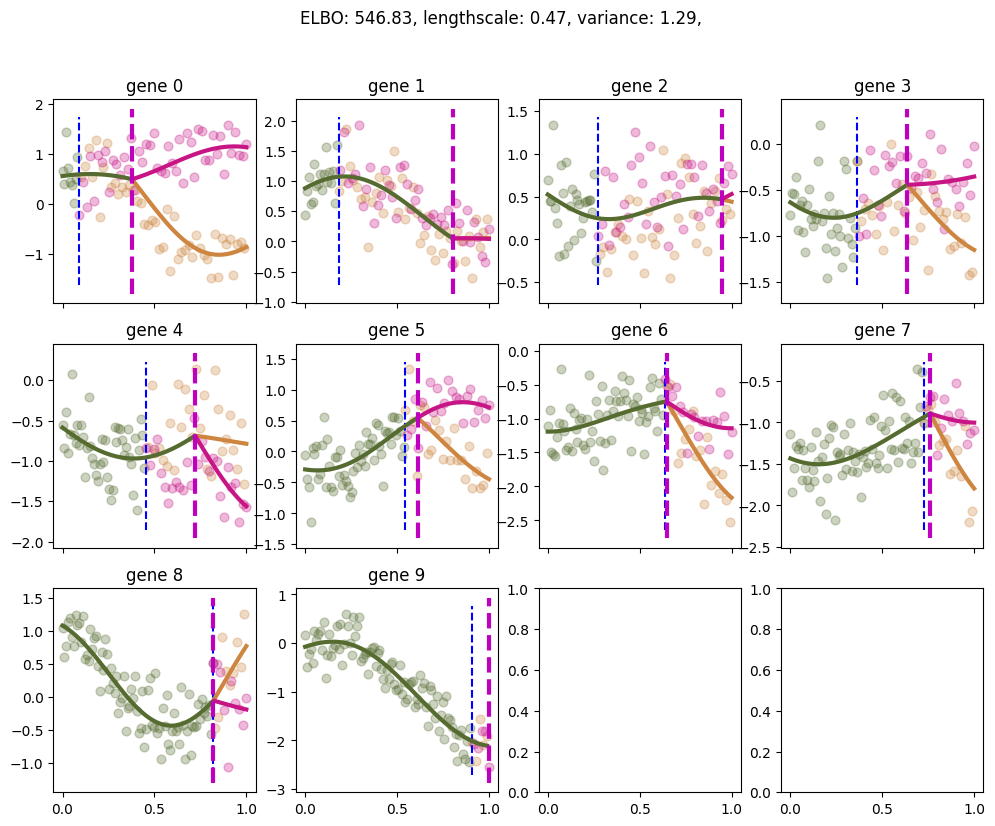

Slicing for gene 0
Uninformative until idx: 80


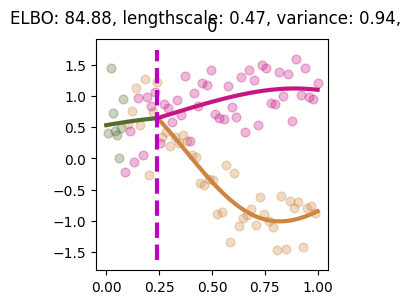

Slicing for gene 1
Uninformative until idx: 80


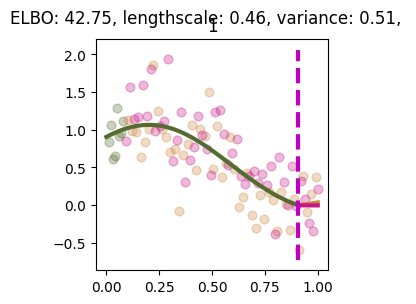

Slicing for gene 2
Uninformative until idx: 80


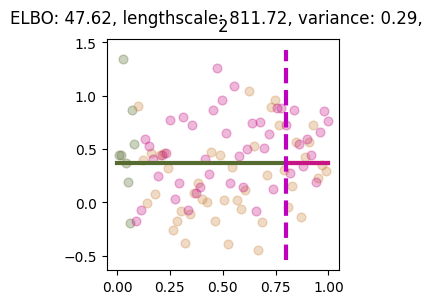

Slicing for gene 3
Uninformative until idx: 80


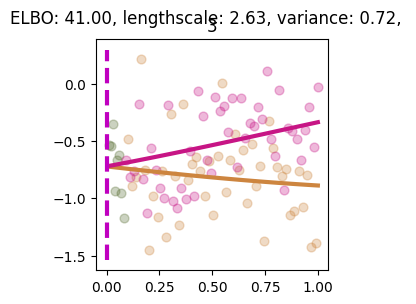

Slicing for gene 4
Uninformative until idx: 80


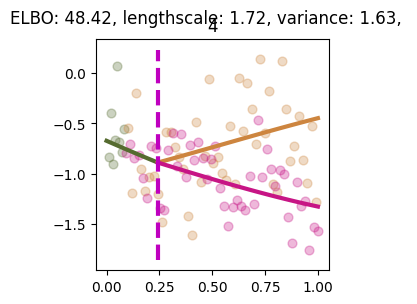

Slicing for gene 5
Uninformative until idx: 80


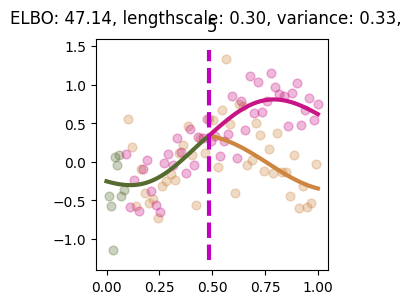

Slicing for gene 6
Uninformative until idx: 80


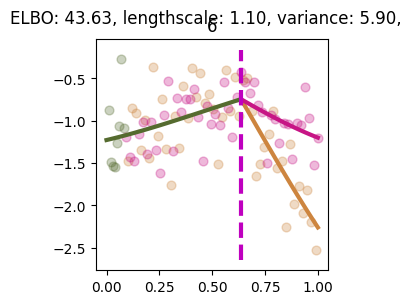

Slicing for gene 7
Uninformative until idx: 80


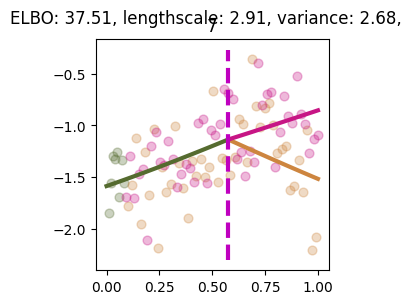

Slicing for gene 8
Uninformative until idx: 80


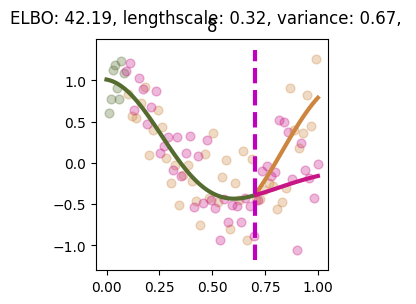

Slicing for gene 9
Uninformative until idx: 80


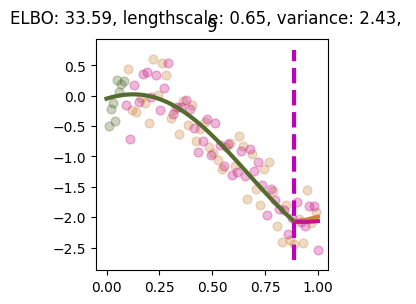

Processing sample 1
Uninformative until idx: 80


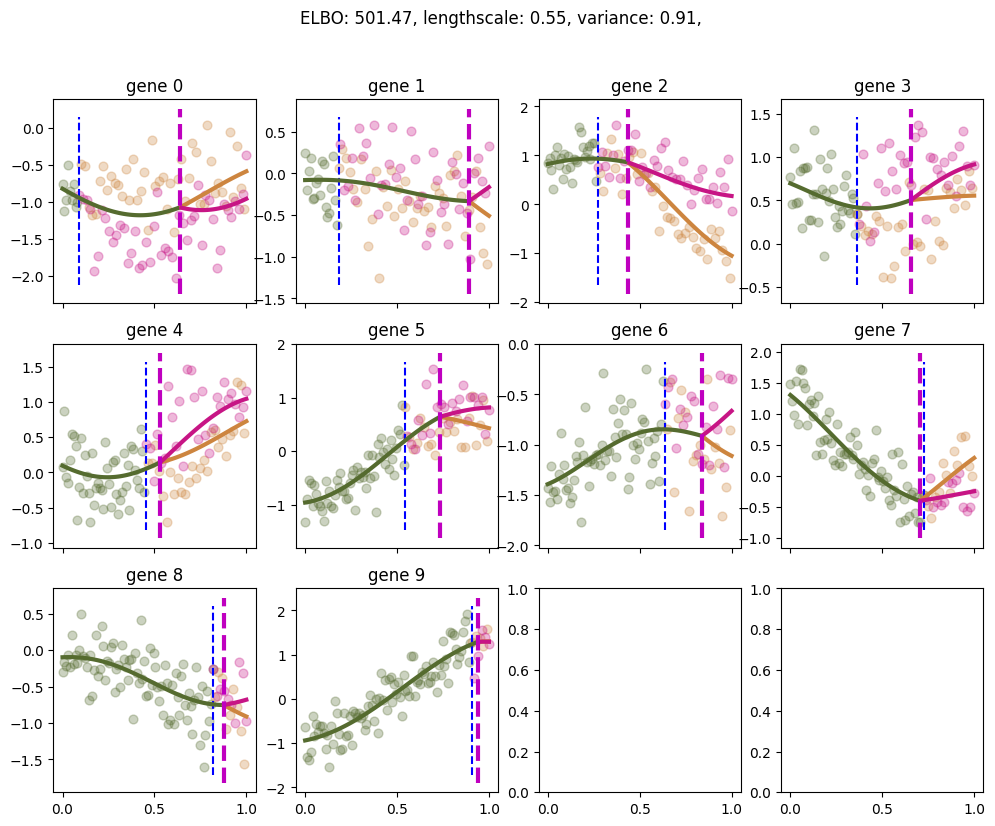

Slicing for gene 0
Uninformative until idx: 80


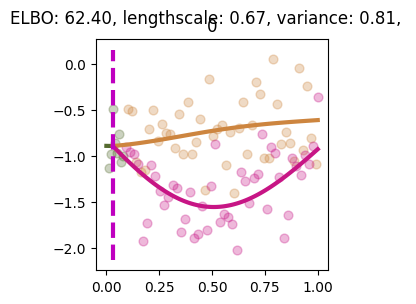

Slicing for gene 1
Uninformative until idx: 80


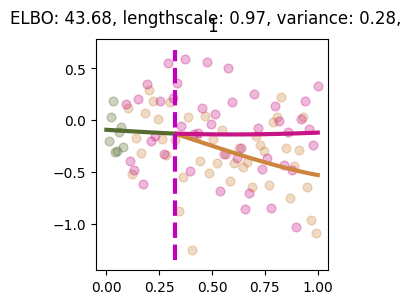

Slicing for gene 2
Uninformative until idx: 80


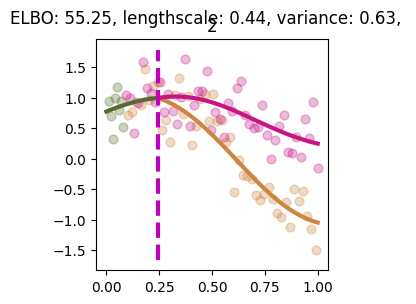

Slicing for gene 3
Uninformative until idx: 80


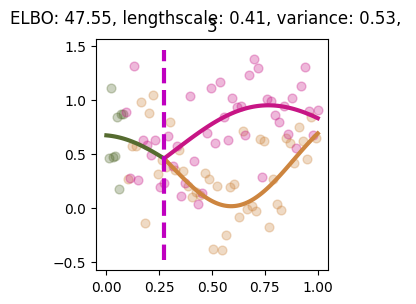

Slicing for gene 4
Uninformative until idx: 80


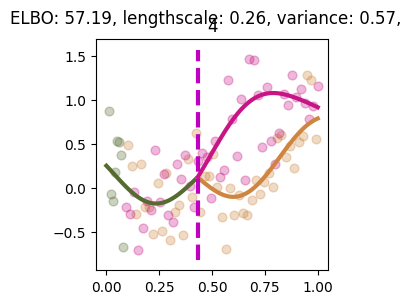

Slicing for gene 5
Uninformative until idx: 80


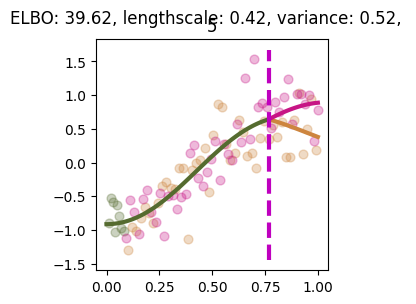

Slicing for gene 6
Uninformative until idx: 80


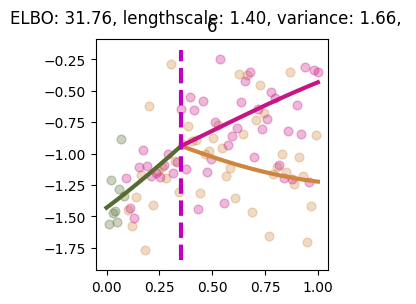

Slicing for gene 7
Uninformative until idx: 80


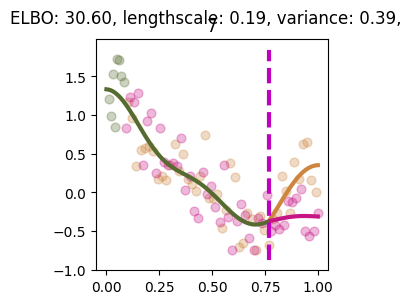

Slicing for gene 8
Uninformative until idx: 80


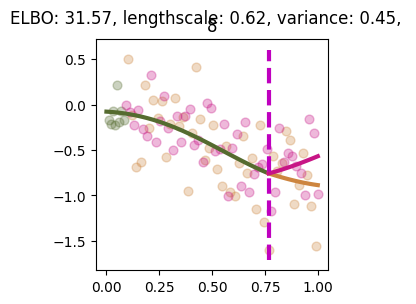

Slicing for gene 9
Uninformative until idx: 80


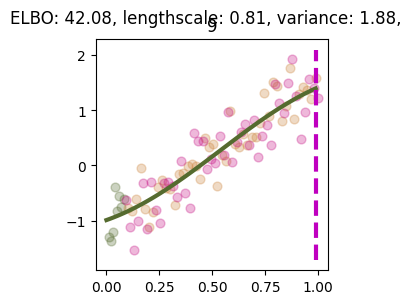

Processing sample 2
Uninformative until idx: 80


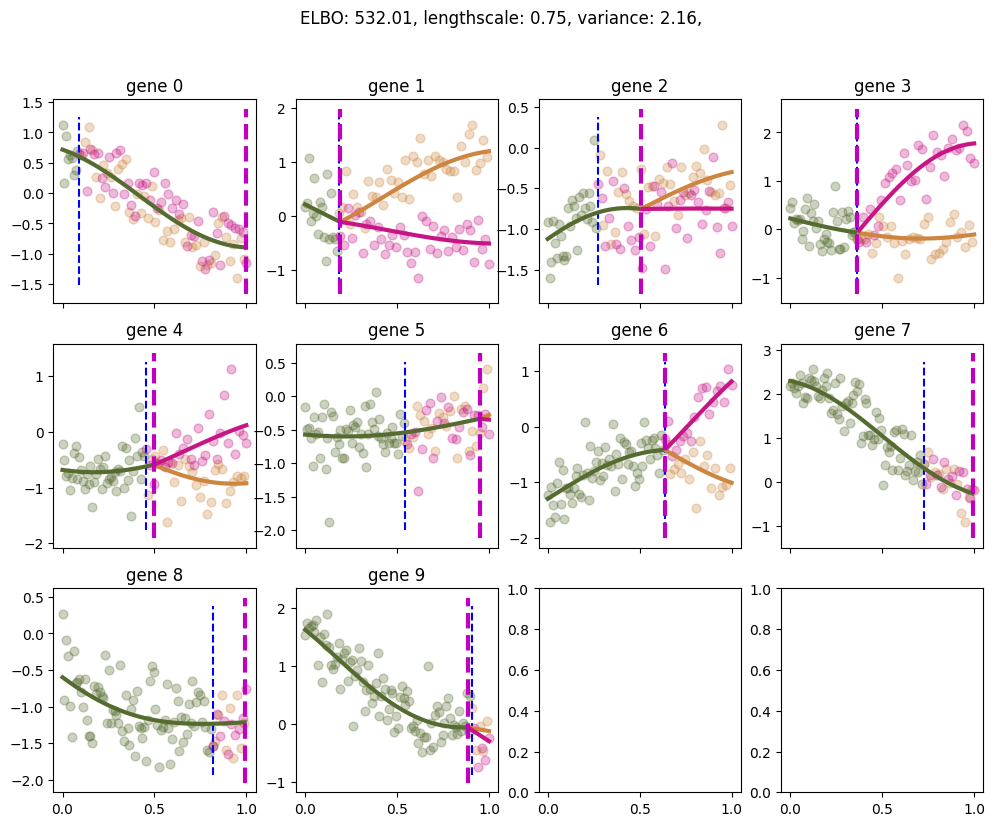

Slicing for gene 0
Uninformative until idx: 80


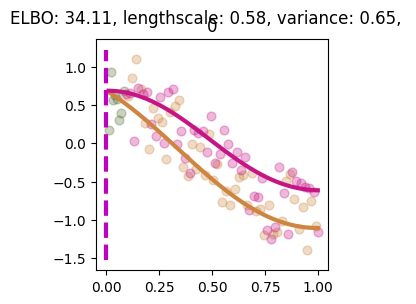

Slicing for gene 1
Uninformative until idx: 80


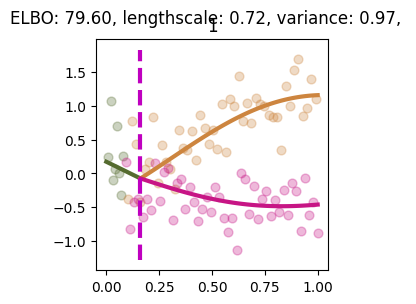

Slicing for gene 2
Uninformative until idx: 80


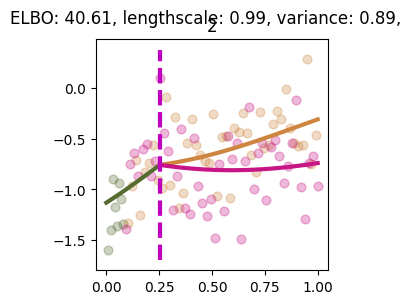

Slicing for gene 3
Uninformative until idx: 80


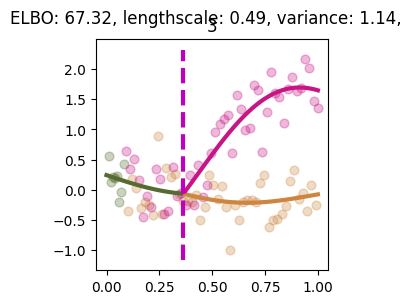

Slicing for gene 4
Uninformative until idx: 80


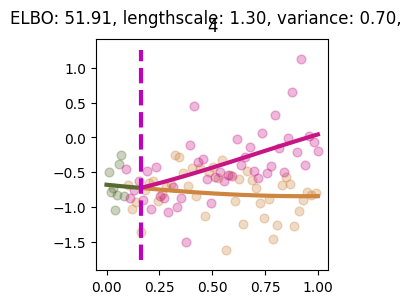

Slicing for gene 5
Uninformative until idx: 80


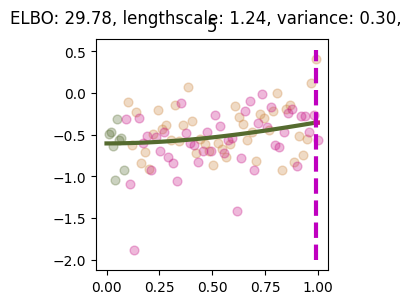

Slicing for gene 6
Uninformative until idx: 80


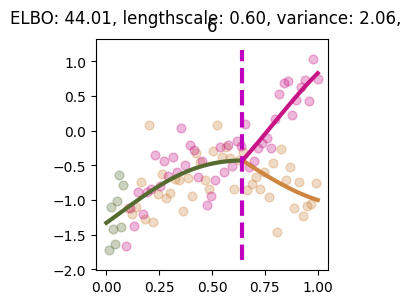

Slicing for gene 7
Uninformative until idx: 80


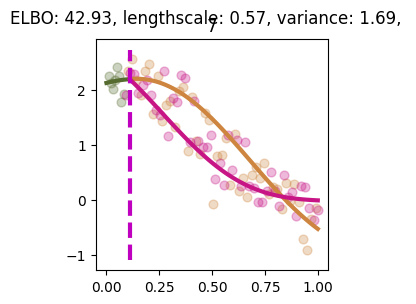

Slicing for gene 8
Uninformative until idx: 80


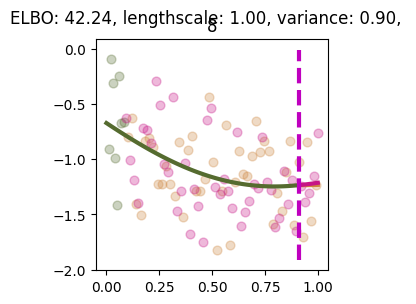

Slicing for gene 9
Uninformative until idx: 80


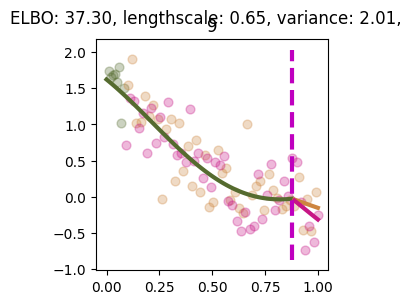

Processing sample 3
Uninformative until idx: 80


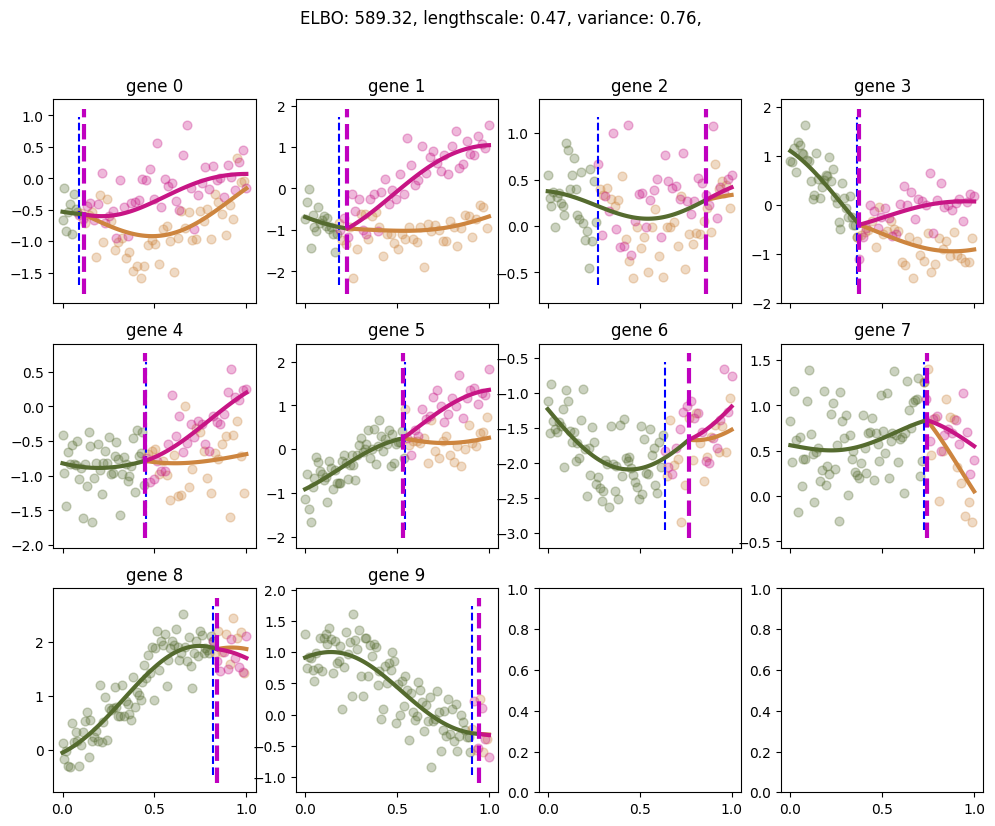

Slicing for gene 0
Uninformative until idx: 80


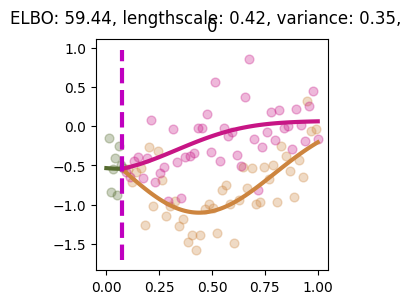

Slicing for gene 1
Uninformative until idx: 80


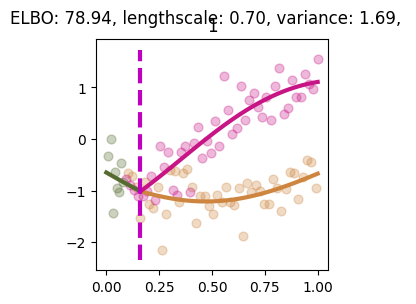

Slicing for gene 2
Uninformative until idx: 80


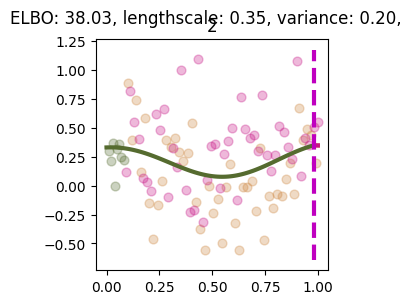

Slicing for gene 3
Uninformative until idx: 80


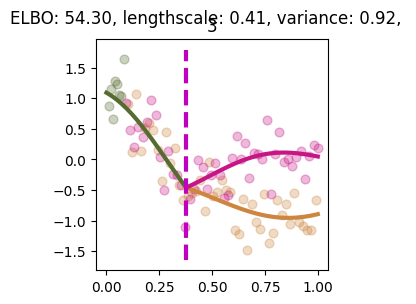

Slicing for gene 4
Uninformative until idx: 80


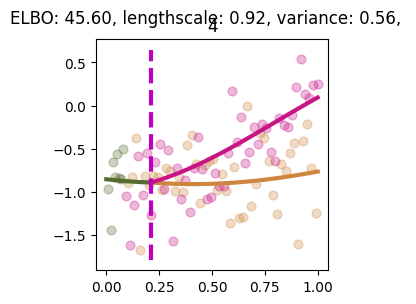

Slicing for gene 5
Uninformative until idx: 80


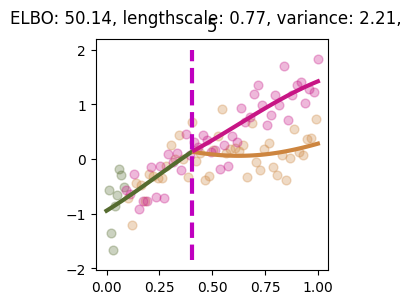

Slicing for gene 6
Uninformative until idx: 80


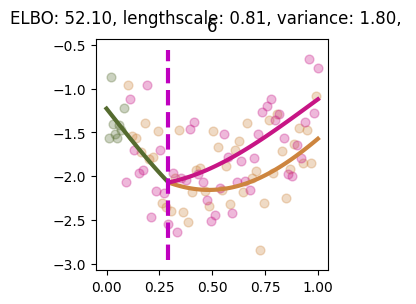

Slicing for gene 7
Uninformative until idx: 80


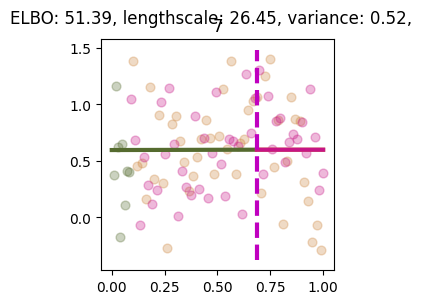

Slicing for gene 8
Uninformative until idx: 80


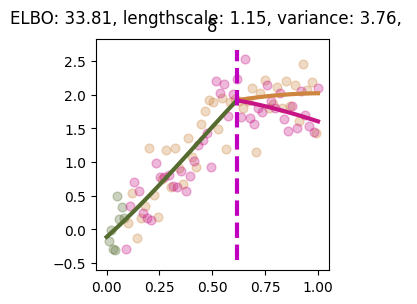

Slicing for gene 9
Uninformative until idx: 80


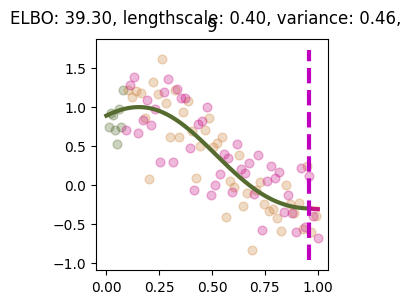

Processing sample 4
Uninformative until idx: 80


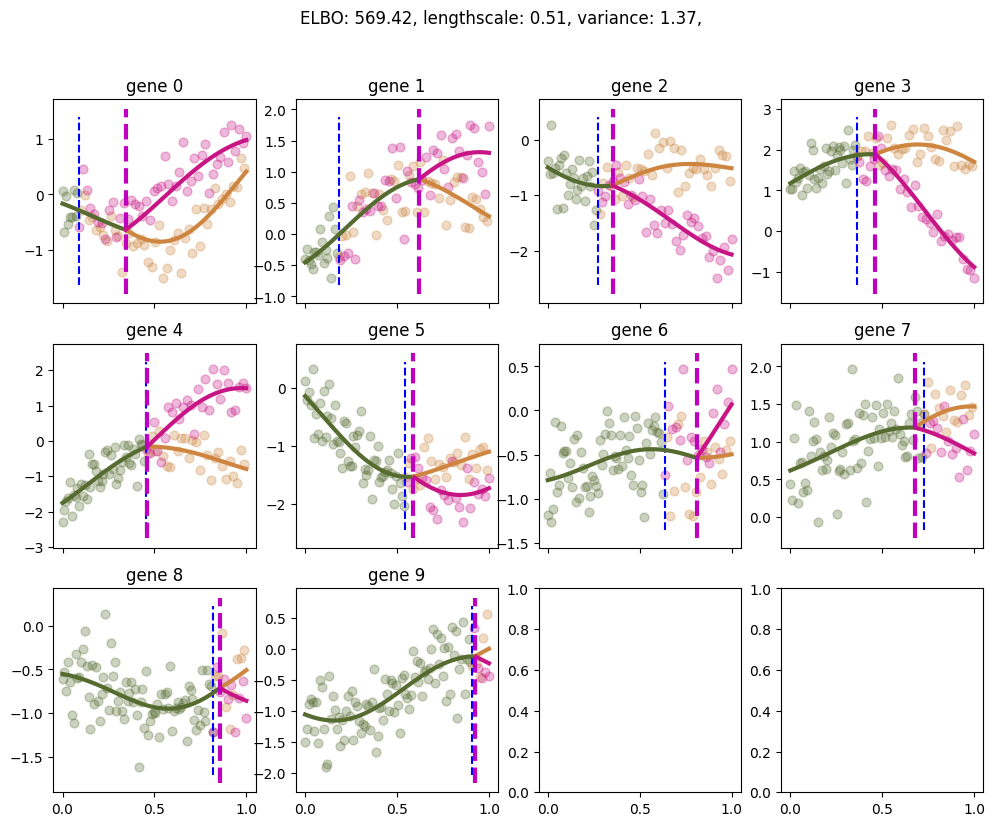

Slicing for gene 0
Uninformative until idx: 80


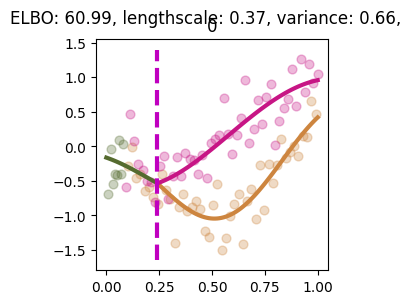

Slicing for gene 1
Uninformative until idx: 80


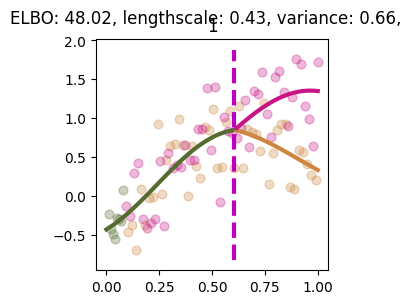

Slicing for gene 2
Uninformative until idx: 80


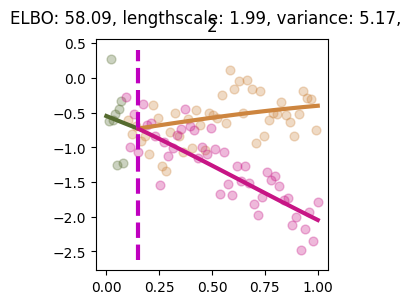

Slicing for gene 3
Uninformative until idx: 80


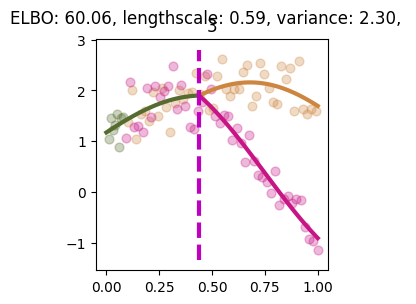

Slicing for gene 4
Uninformative until idx: 80


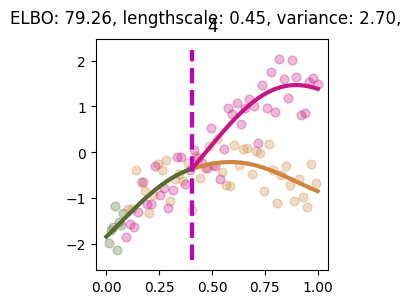

Slicing for gene 5
Uninformative until idx: 80


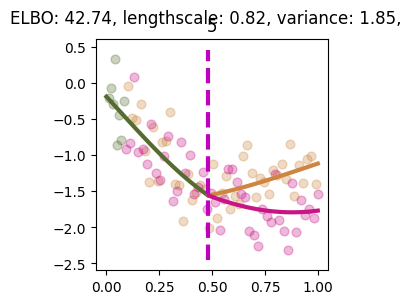

Slicing for gene 6
Uninformative until idx: 80


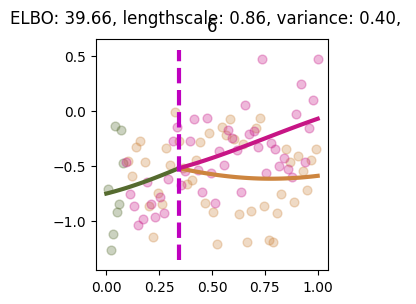

Slicing for gene 7
Uninformative until idx: 80


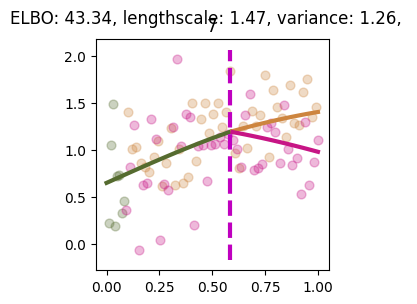

Slicing for gene 8
Uninformative until idx: 80


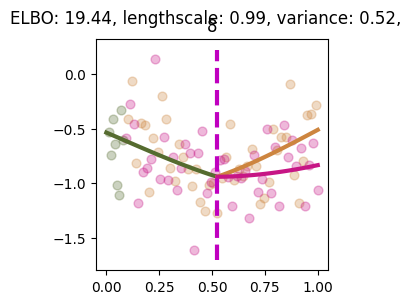

Slicing for gene 9
Uninformative until idx: 80


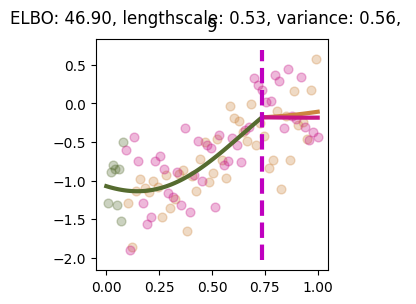

Processing sample 5
Uninformative until idx: 80


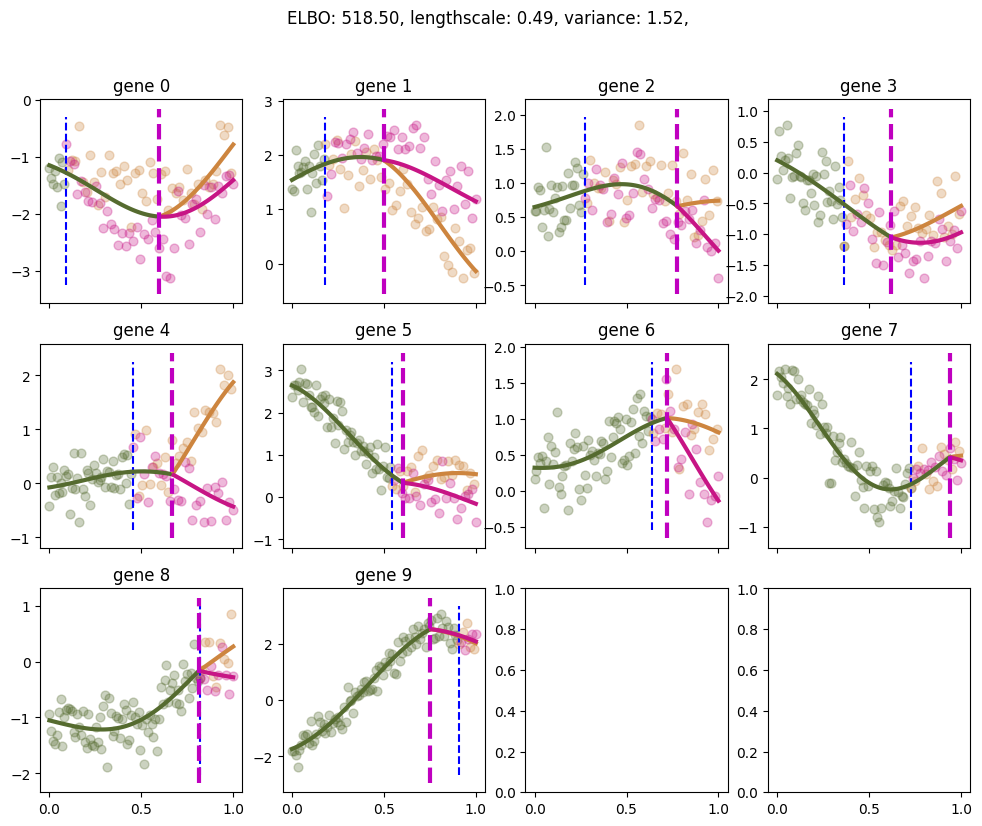

Slicing for gene 0
Uninformative until idx: 80


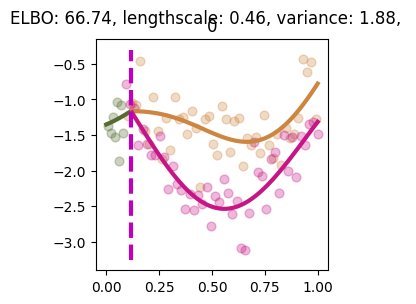

Slicing for gene 1
Uninformative until idx: 80


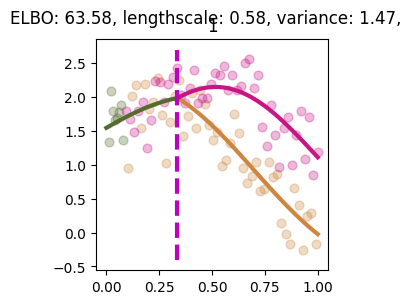

Slicing for gene 2
Uninformative until idx: 80


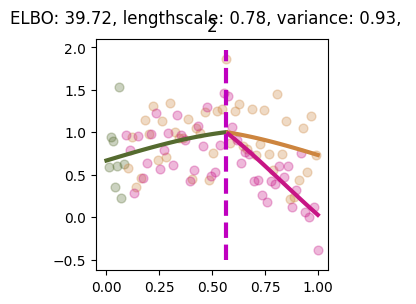

Slicing for gene 3
Uninformative until idx: 80


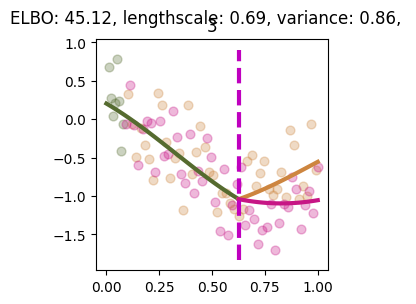

Slicing for gene 4
Uninformative until idx: 80


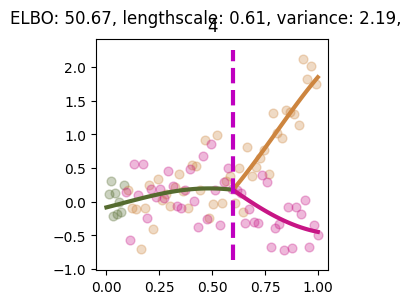

Slicing for gene 5
Uninformative until idx: 80


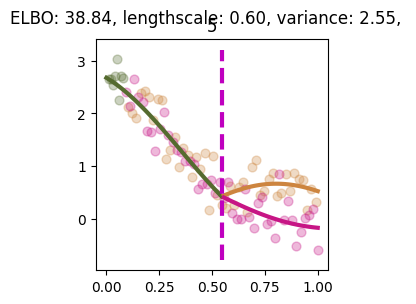

Slicing for gene 6
Uninformative until idx: 80


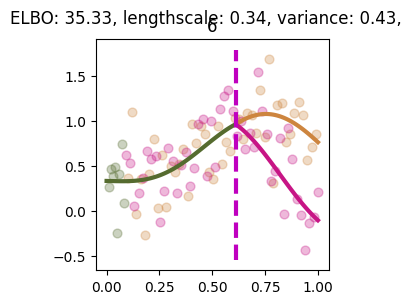

Slicing for gene 7
Uninformative until idx: 80


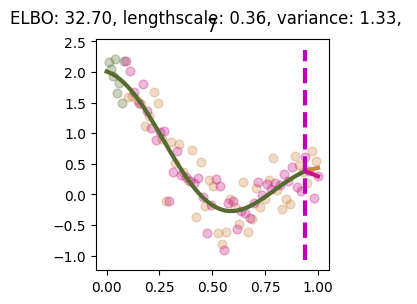

Slicing for gene 8
Uninformative until idx: 80


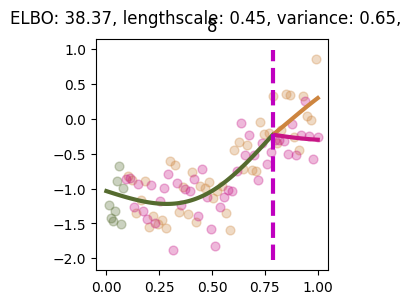

Slicing for gene 9
Uninformative until idx: 80


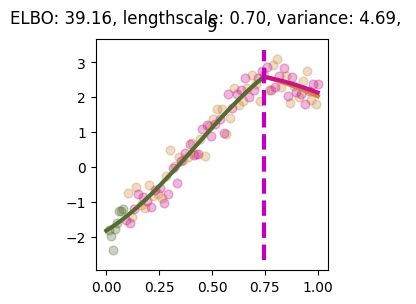

Processing sample 6
Uninformative until idx: 80


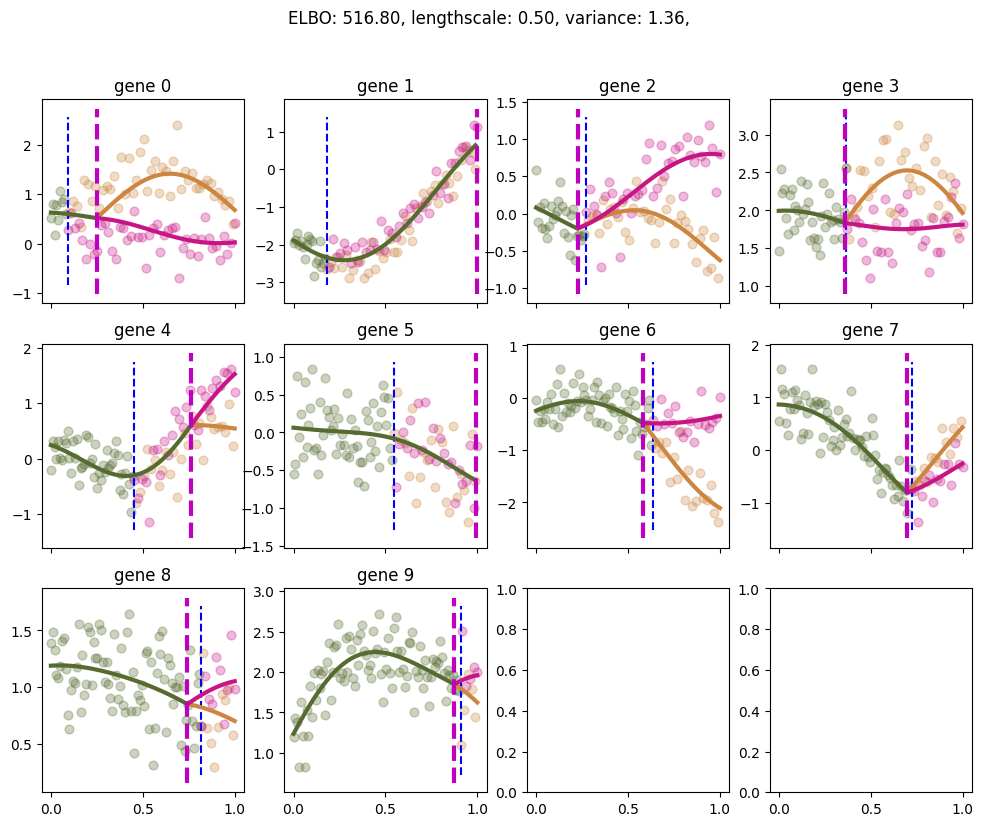

Slicing for gene 0
Uninformative until idx: 80


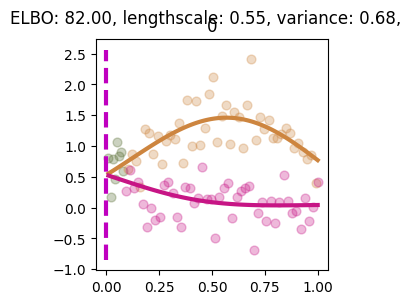

Slicing for gene 1
Uninformative until idx: 80


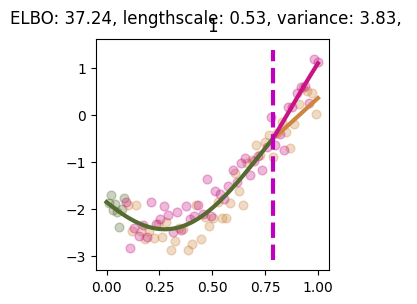

Slicing for gene 2
Uninformative until idx: 80


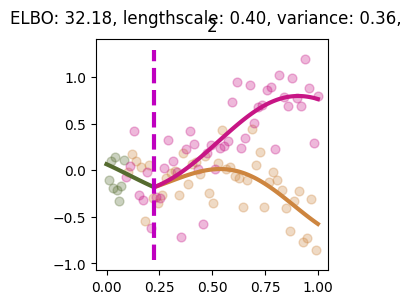

Slicing for gene 3
Uninformative until idx: 80


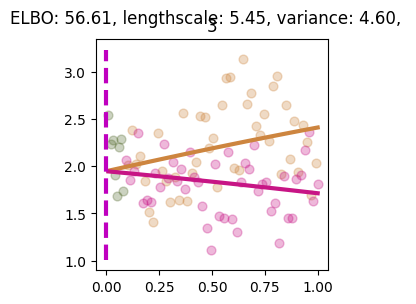

Slicing for gene 4
Uninformative until idx: 80


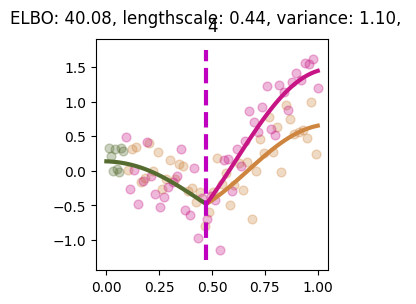

Slicing for gene 5
Uninformative until idx: 80


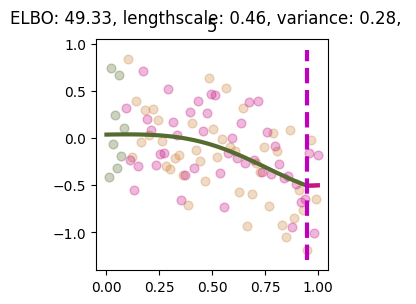

Slicing for gene 6
Uninformative until idx: 80


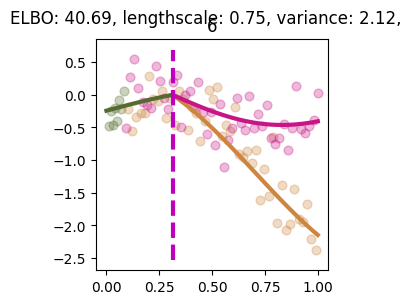

Slicing for gene 7
Uninformative until idx: 80


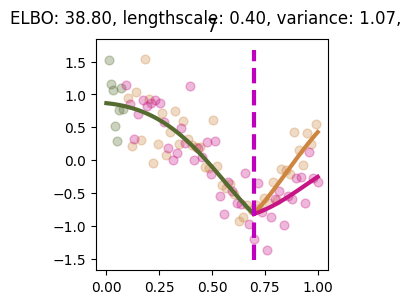

Slicing for gene 8
Uninformative until idx: 80


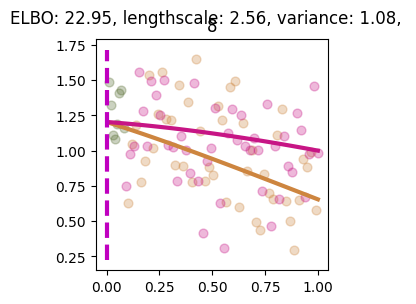

Slicing for gene 9
Uninformative until idx: 80


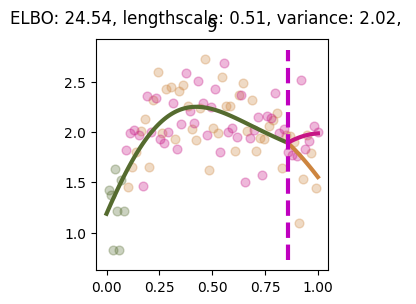

Processing sample 7
Uninformative until idx: 80


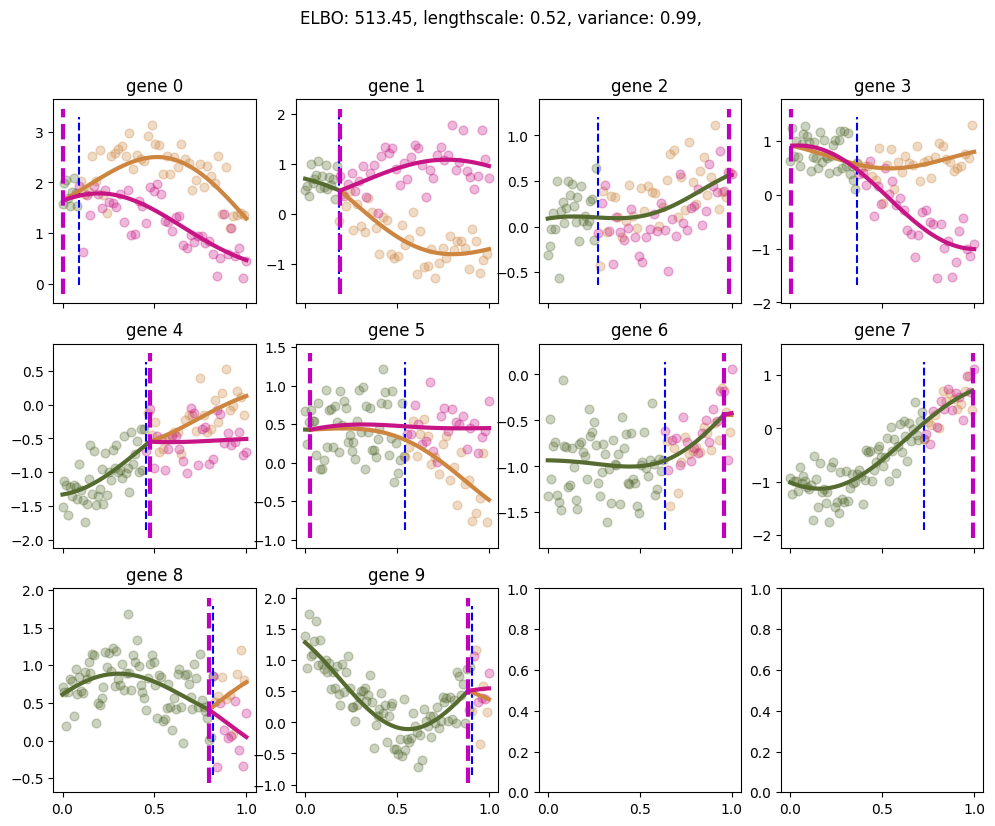

Slicing for gene 0
Uninformative until idx: 80


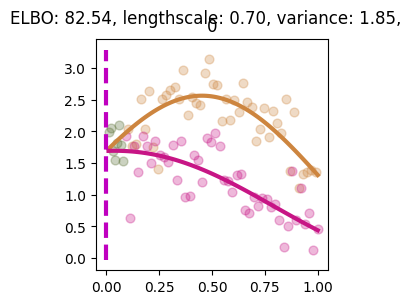

Slicing for gene 1
Uninformative until idx: 80


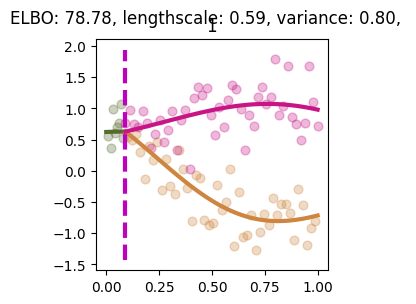

Slicing for gene 2
Uninformative until idx: 80


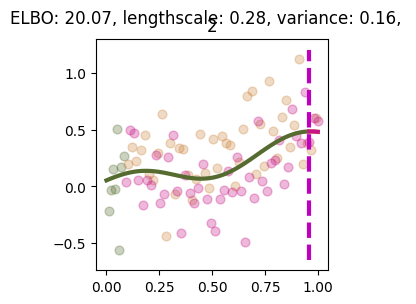

Slicing for gene 3
Uninformative until idx: 80


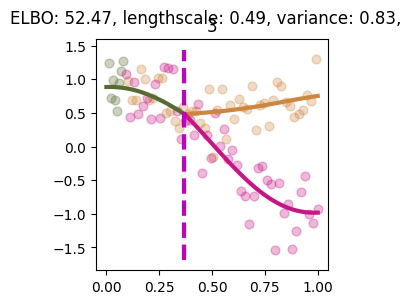

Slicing for gene 4
Uninformative until idx: 80


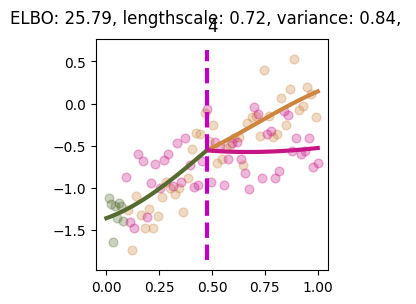

Slicing for gene 5
Uninformative until idx: 80


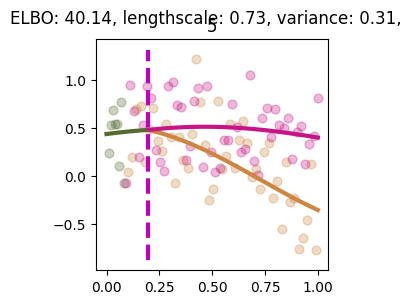

Slicing for gene 6
Uninformative until idx: 80


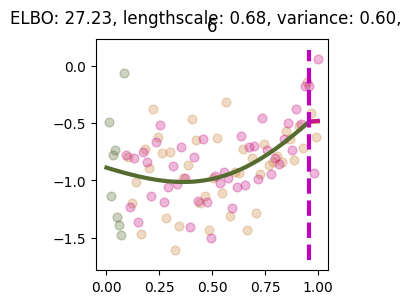

Slicing for gene 7
Uninformative until idx: 80


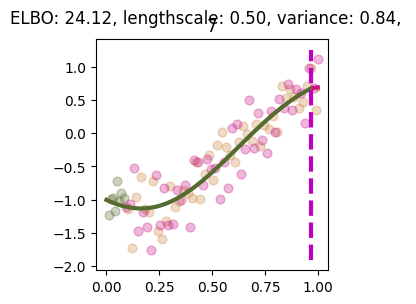

Slicing for gene 8
Uninformative until idx: 80


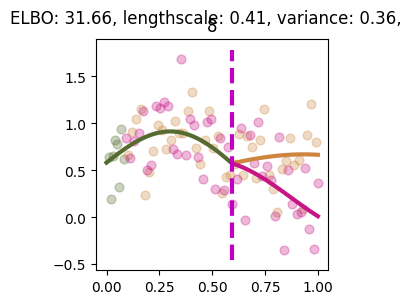

Slicing for gene 9
Uninformative until idx: 80


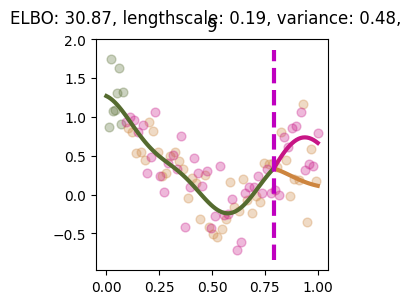

Processing sample 8
Uninformative until idx: 80


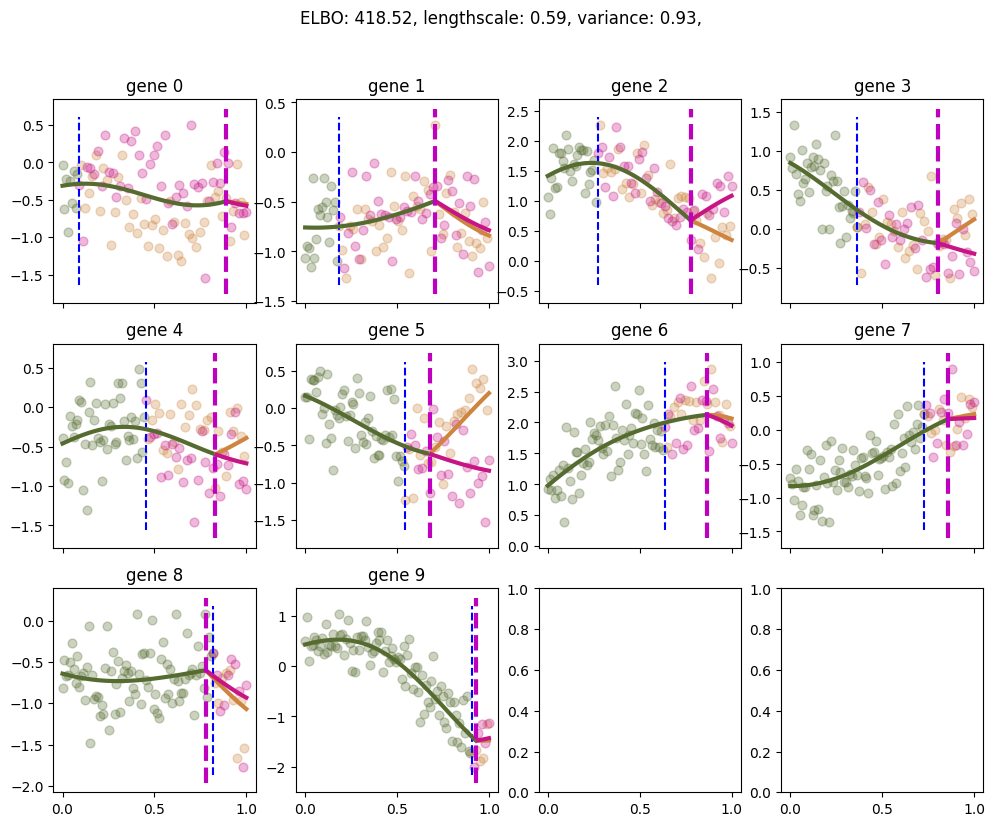

Slicing for gene 0
Uninformative until idx: 80


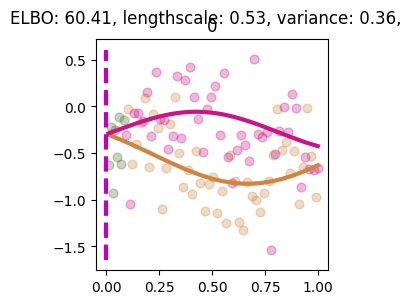

Slicing for gene 1
Uninformative until idx: 80


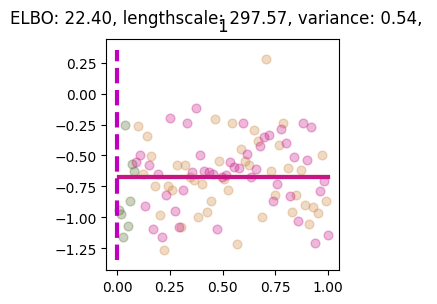

Slicing for gene 2
Uninformative until idx: 80


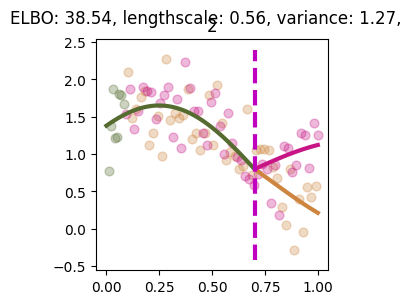

Slicing for gene 3
Uninformative until idx: 80


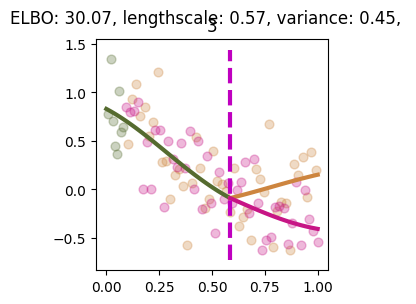

Slicing for gene 4
Uninformative until idx: 80


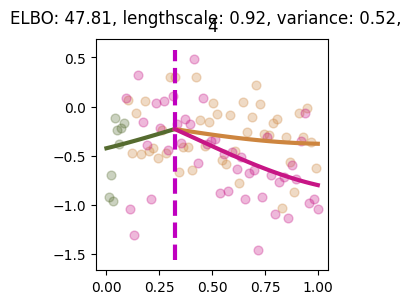

Slicing for gene 5
Uninformative until idx: 80


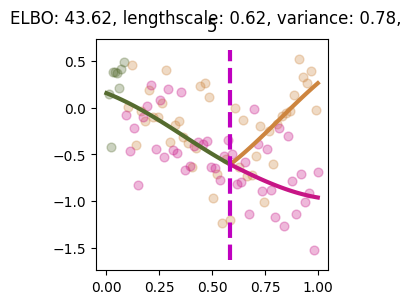

Slicing for gene 6
Uninformative until idx: 80


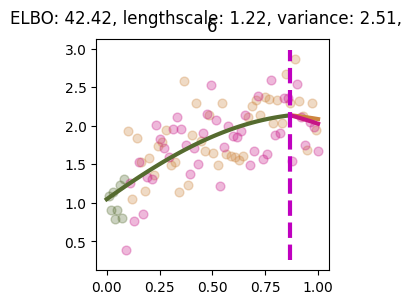

Slicing for gene 7
Uninformative until idx: 80


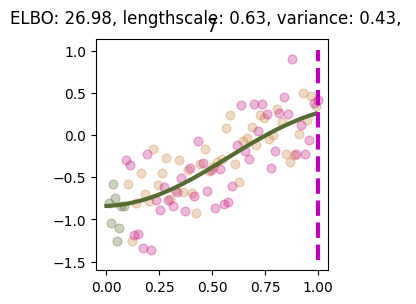

Slicing for gene 8
Uninformative until idx: 80


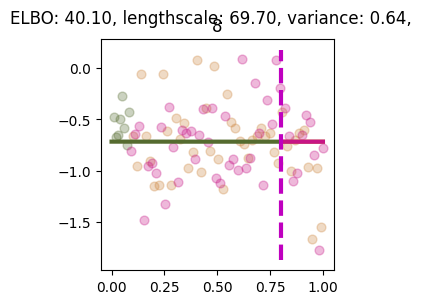

Slicing for gene 9
Uninformative until idx: 80


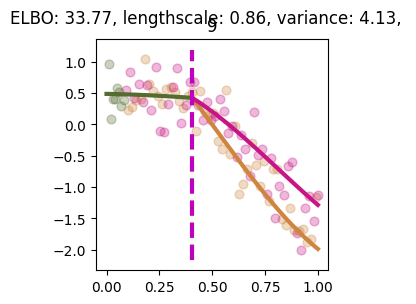

Processing sample 9
Uninformative until idx: 80


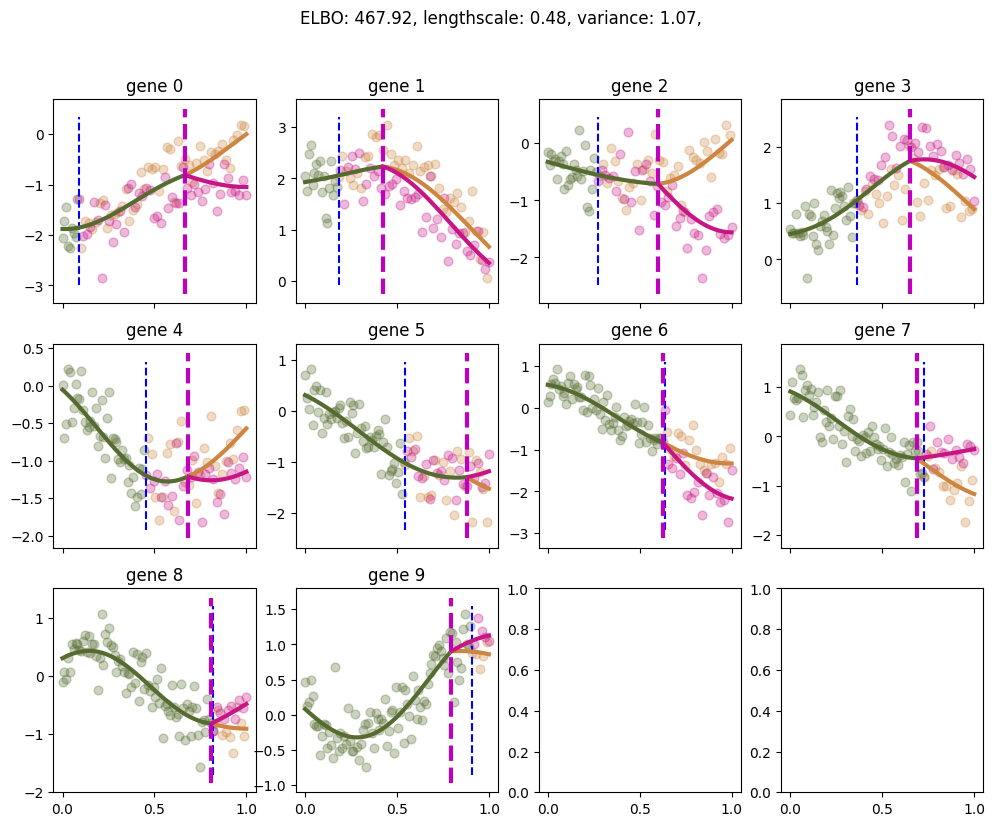

Slicing for gene 0
Uninformative until idx: 80


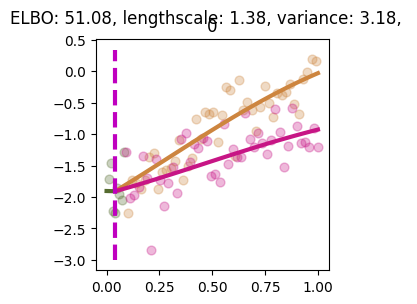

Slicing for gene 1
Uninformative until idx: 80


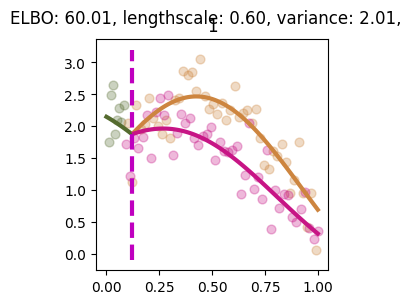

Slicing for gene 2
Uninformative until idx: 80


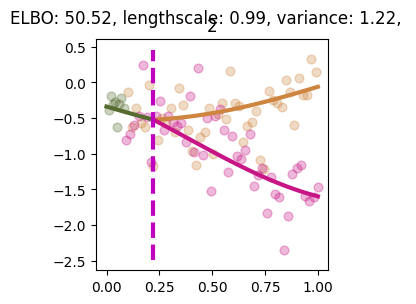

Slicing for gene 3
Uninformative until idx: 80


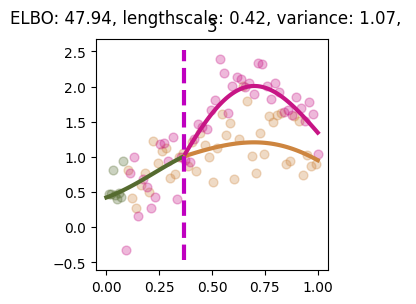

Slicing for gene 4
Uninformative until idx: 80


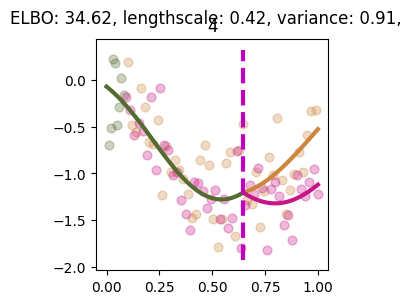

Slicing for gene 5
Uninformative until idx: 80


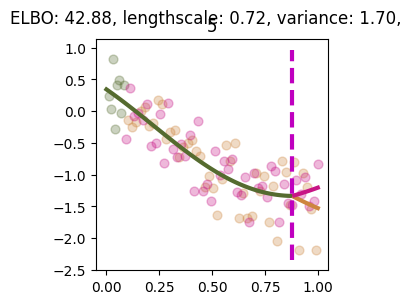

Slicing for gene 6
Uninformative until idx: 80


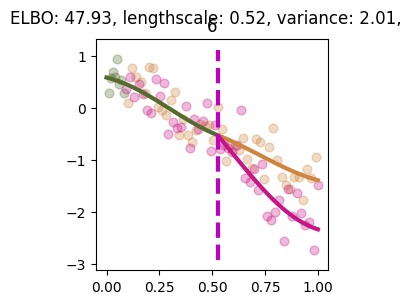

Slicing for gene 7
Uninformative until idx: 80


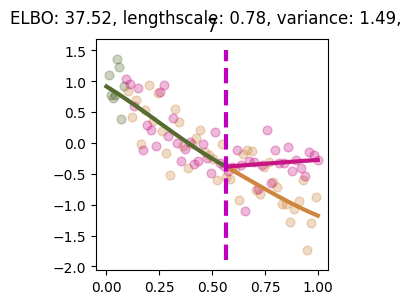

Slicing for gene 8
Uninformative until idx: 80


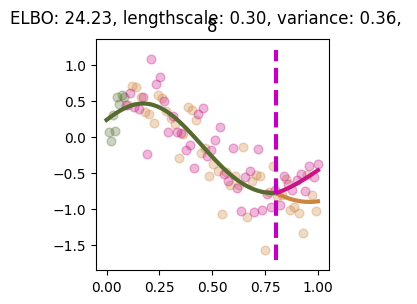

Slicing for gene 9
Uninformative until idx: 80


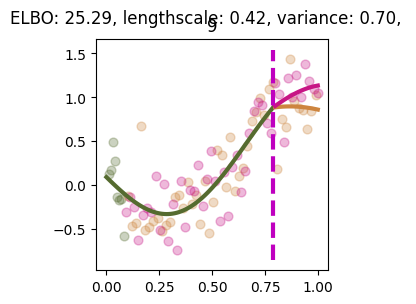

Processing sample 10
Uninformative until idx: 80


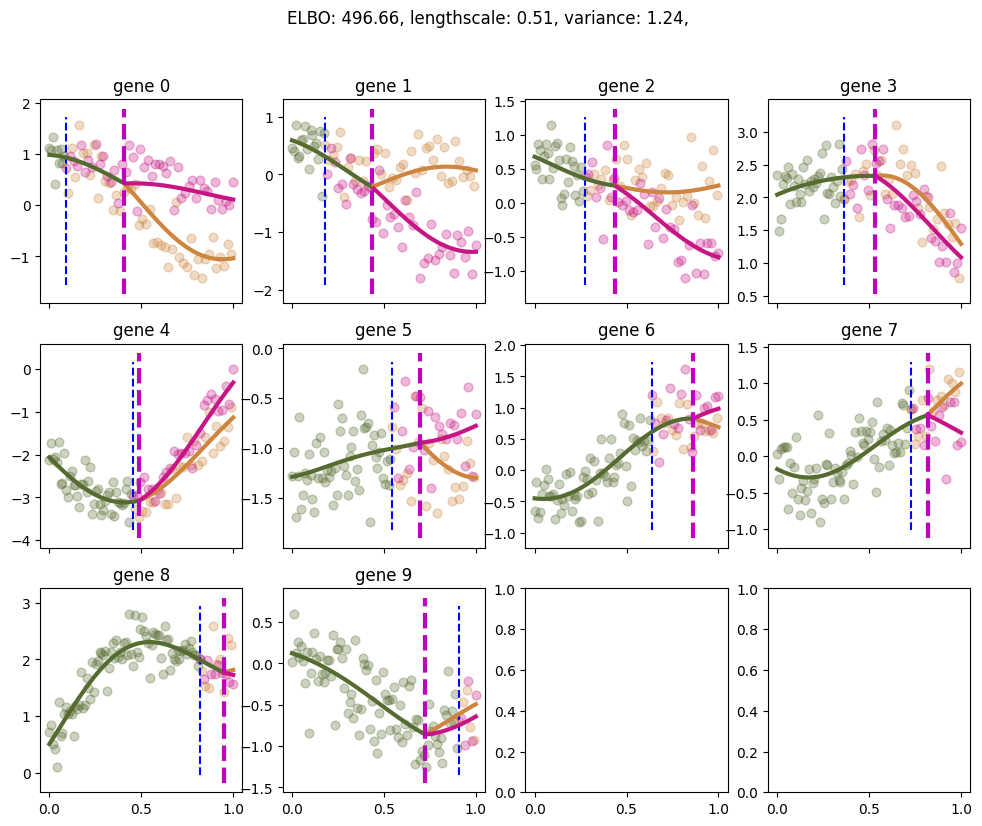

Slicing for gene 0
Uninformative until idx: 80


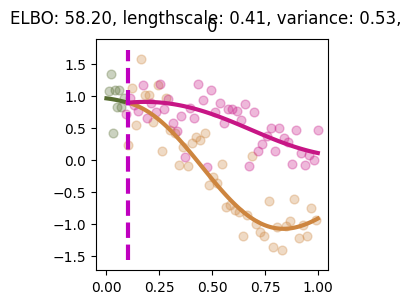

Slicing for gene 1
Uninformative until idx: 80


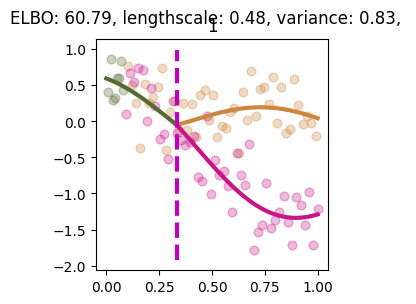

Slicing for gene 2
Uninformative until idx: 80


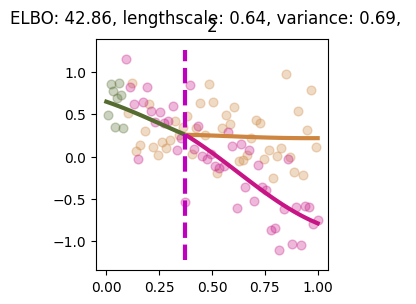

Slicing for gene 3
Uninformative until idx: 80


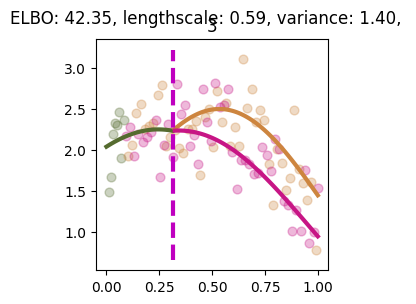

Slicing for gene 4
Uninformative until idx: 80


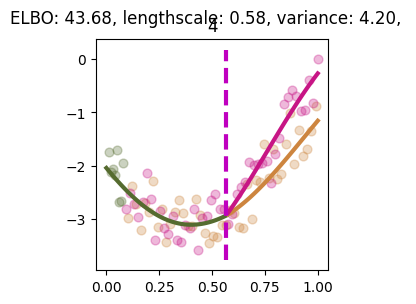

Slicing for gene 5
Uninformative until idx: 80


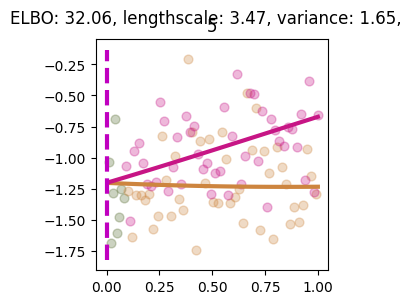

Slicing for gene 6
Uninformative until idx: 80


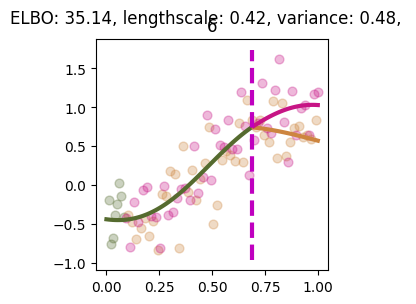

Slicing for gene 7
Uninformative until idx: 80


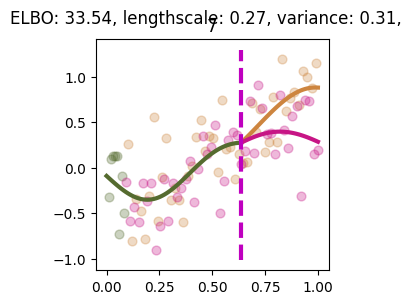

Slicing for gene 8
Uninformative until idx: 80


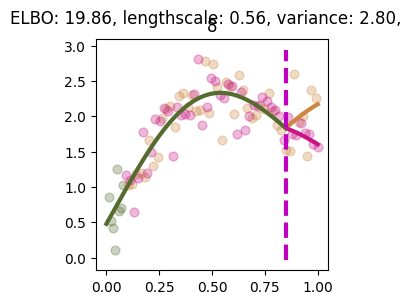

Slicing for gene 9
Uninformative until idx: 80


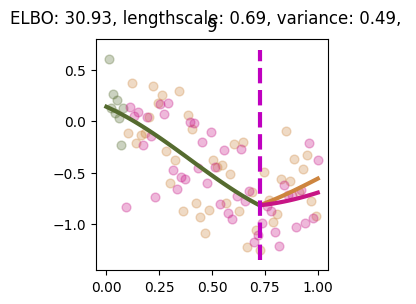

Processing sample 11
Uninformative until idx: 80


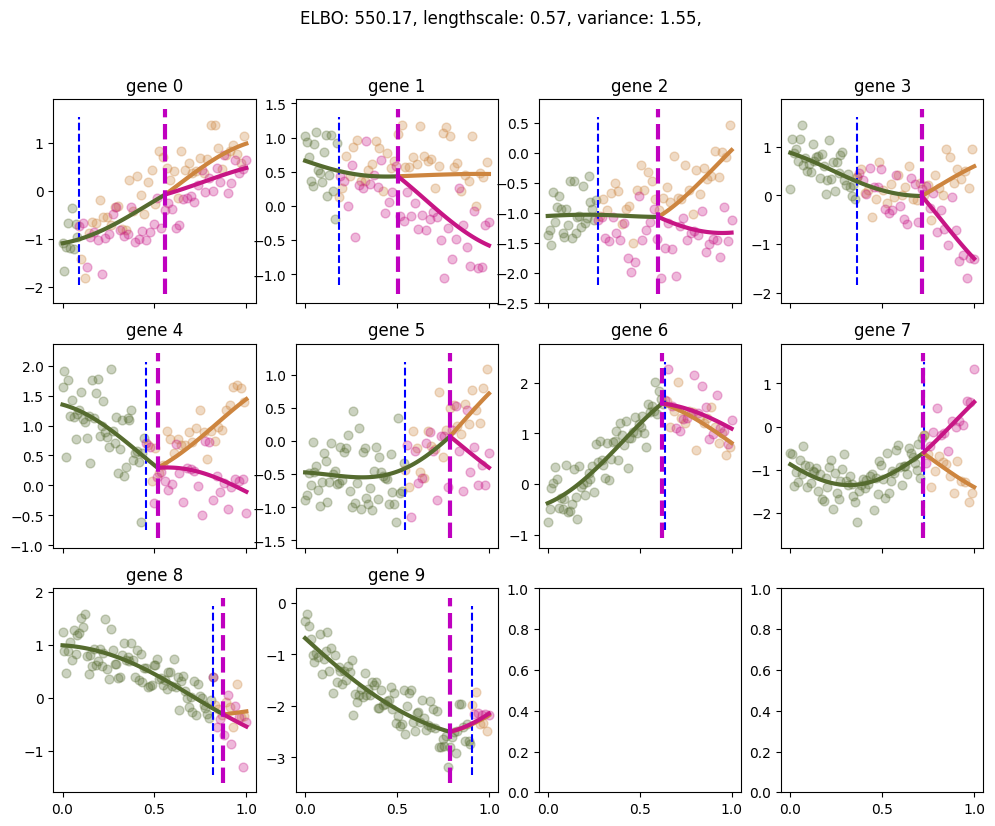

Slicing for gene 0
Uninformative until idx: 80


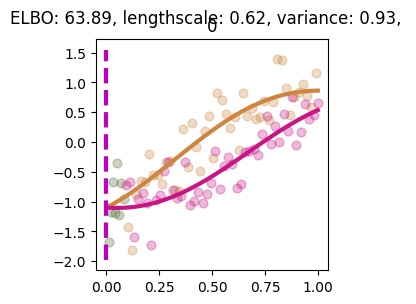

Slicing for gene 1
Uninformative until idx: 80


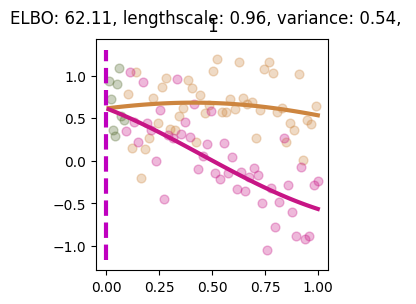

Slicing for gene 2
Uninformative until idx: 80


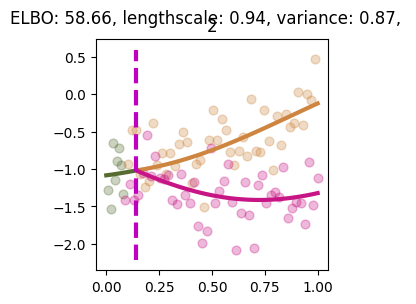

Slicing for gene 3
Uninformative until idx: 80


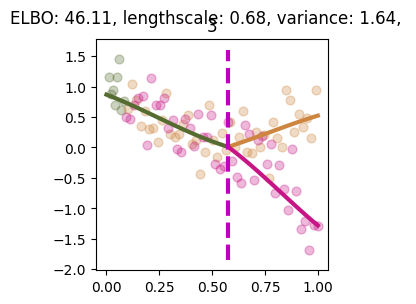

Slicing for gene 4
Uninformative until idx: 80


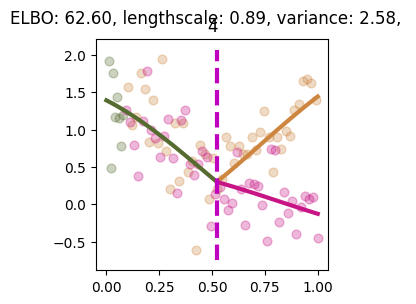

Slicing for gene 5
Uninformative until idx: 80


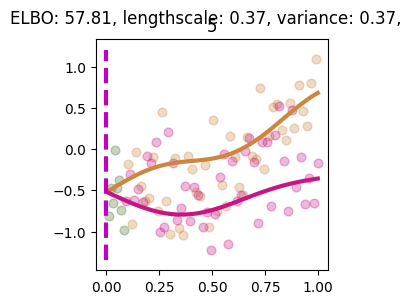

Slicing for gene 6
Uninformative until idx: 80


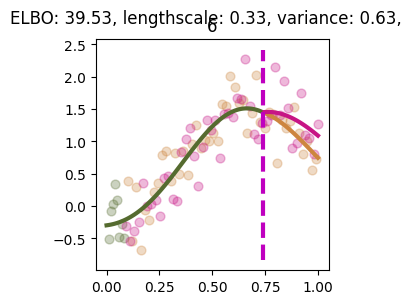

Slicing for gene 7
Uninformative until idx: 80


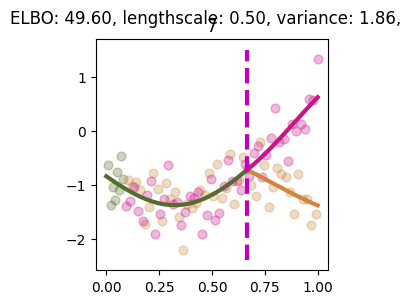

Slicing for gene 8
Uninformative until idx: 80


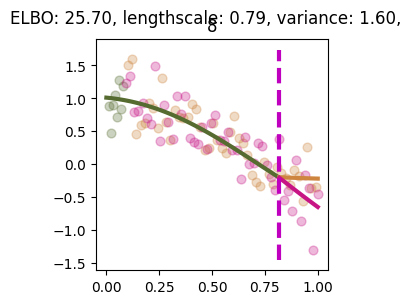

Slicing for gene 9
Uninformative until idx: 80


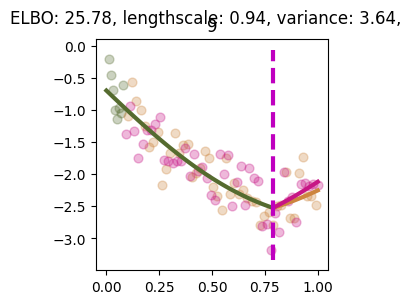

Processing sample 12
Uninformative until idx: 80


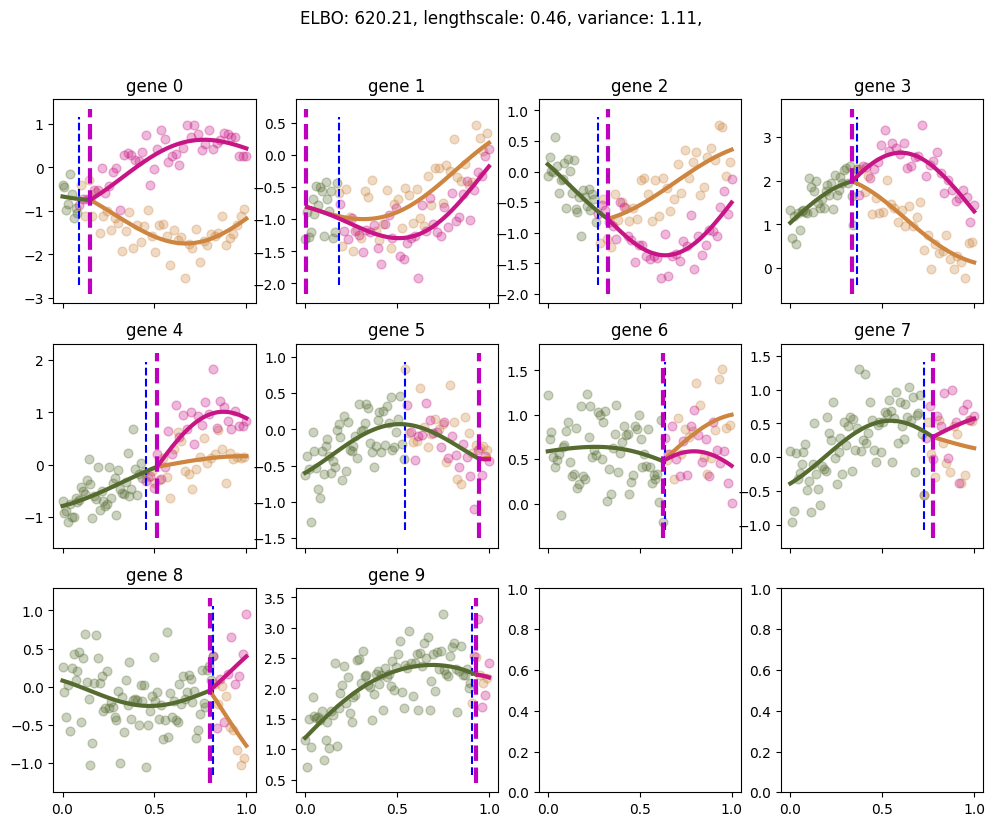

Slicing for gene 0
Uninformative until idx: 80


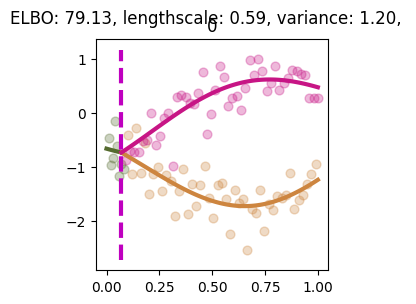

Slicing for gene 1
Uninformative until idx: 80


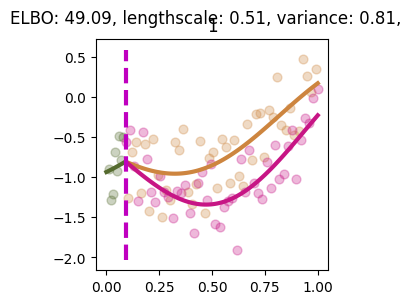

Slicing for gene 2
Uninformative until idx: 80


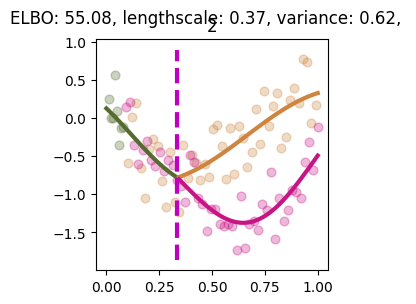

Slicing for gene 3
Uninformative until idx: 80


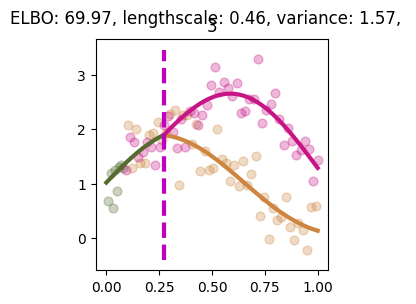

Slicing for gene 4
Uninformative until idx: 80


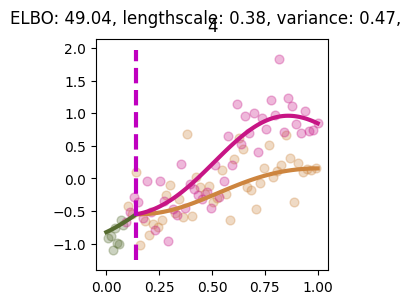

Slicing for gene 5
Uninformative until idx: 80


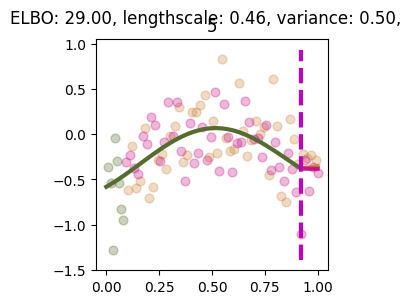

Slicing for gene 6
Uninformative until idx: 80


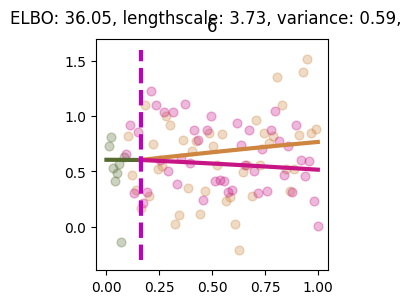

Slicing for gene 7
Uninformative until idx: 80


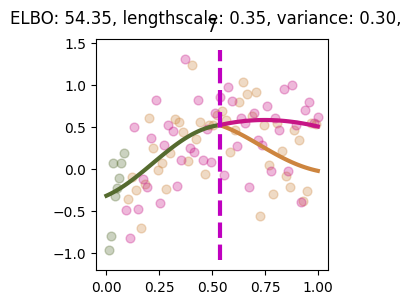

Slicing for gene 8
Uninformative until idx: 80


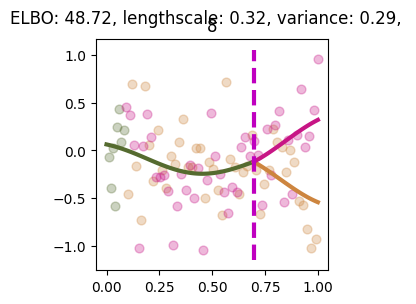

Slicing for gene 9
Uninformative until idx: 80


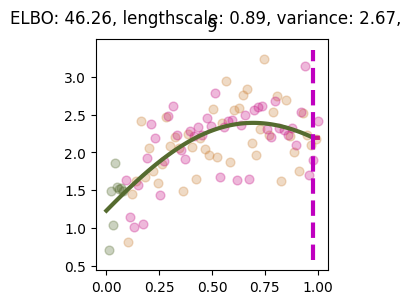

Processing sample 13
Uninformative until idx: 80


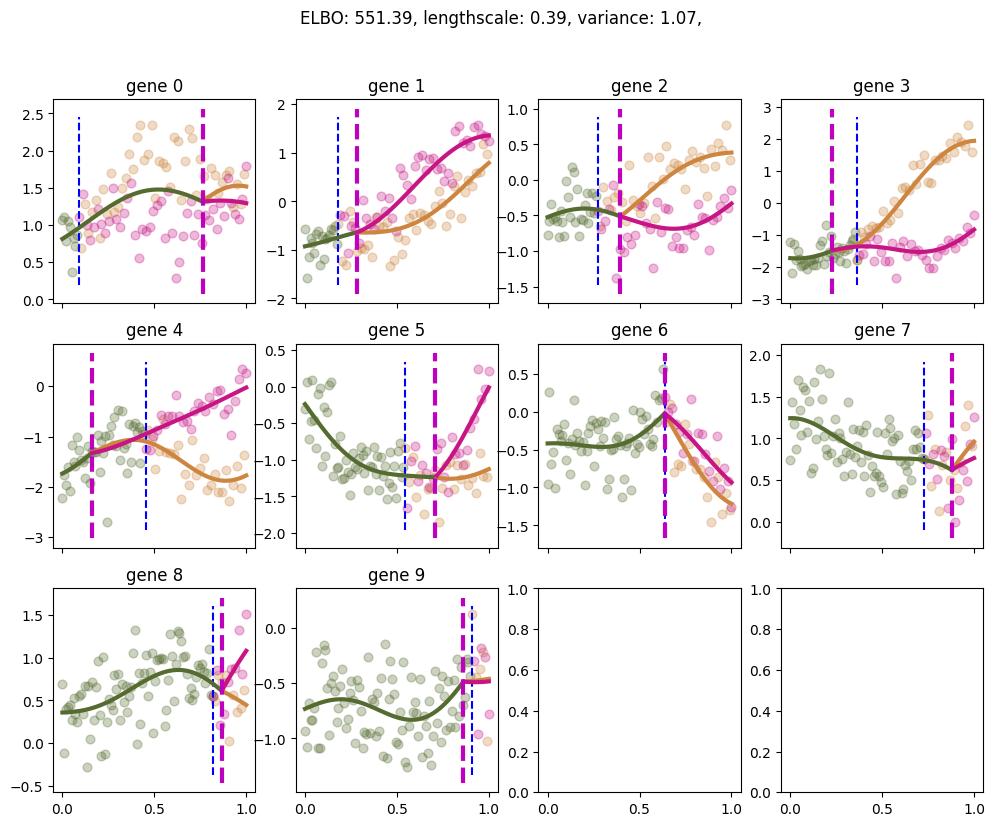

Slicing for gene 0
Uninformative until idx: 80


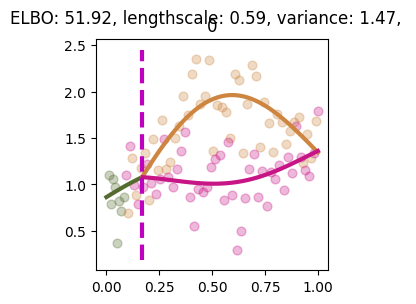

Slicing for gene 1
Uninformative until idx: 80


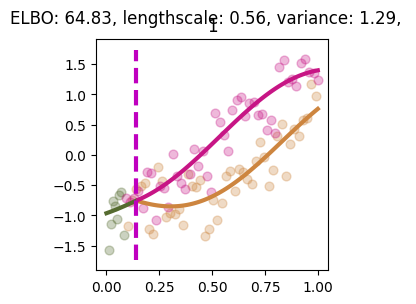

Slicing for gene 2
Uninformative until idx: 80


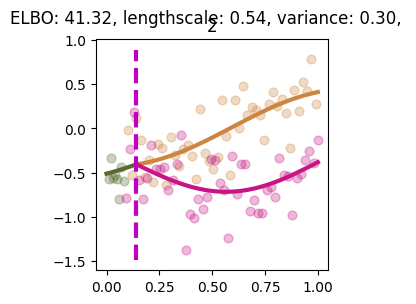

Slicing for gene 3
Uninformative until idx: 80


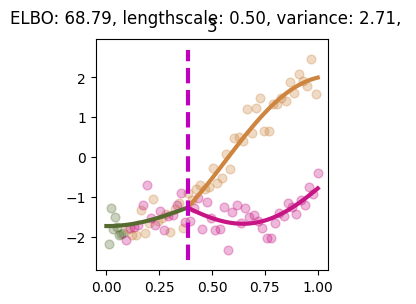

Slicing for gene 4
Uninformative until idx: 80


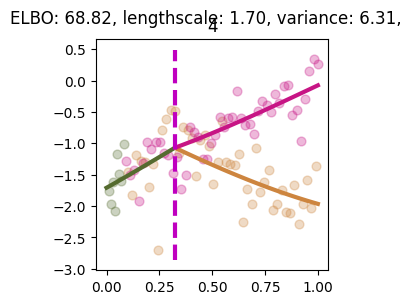

Slicing for gene 5
Uninformative until idx: 80


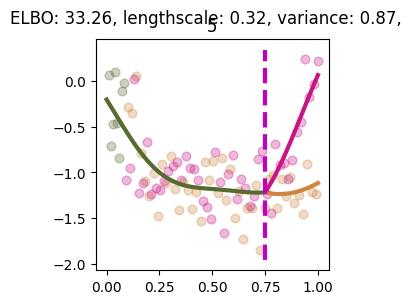

Slicing for gene 6
Uninformative until idx: 80


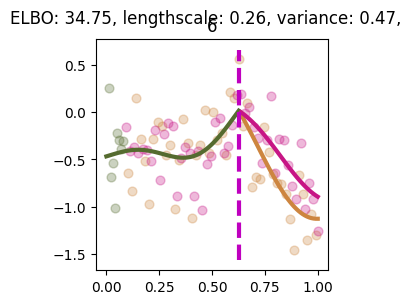

Slicing for gene 7
Uninformative until idx: 80


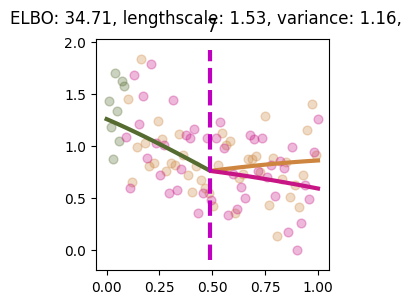

Slicing for gene 8
Uninformative until idx: 80


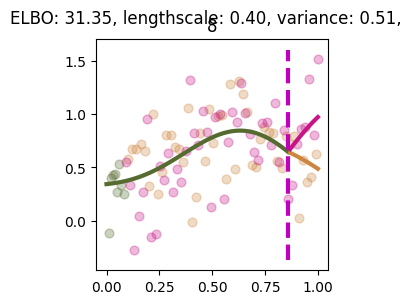

Slicing for gene 9
Uninformative until idx: 80


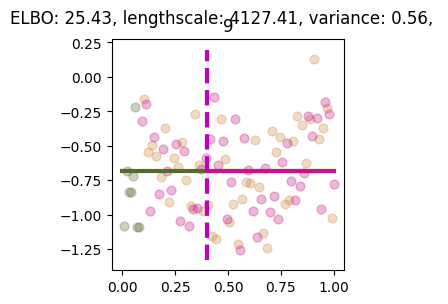

Processing sample 14
Uninformative until idx: 80


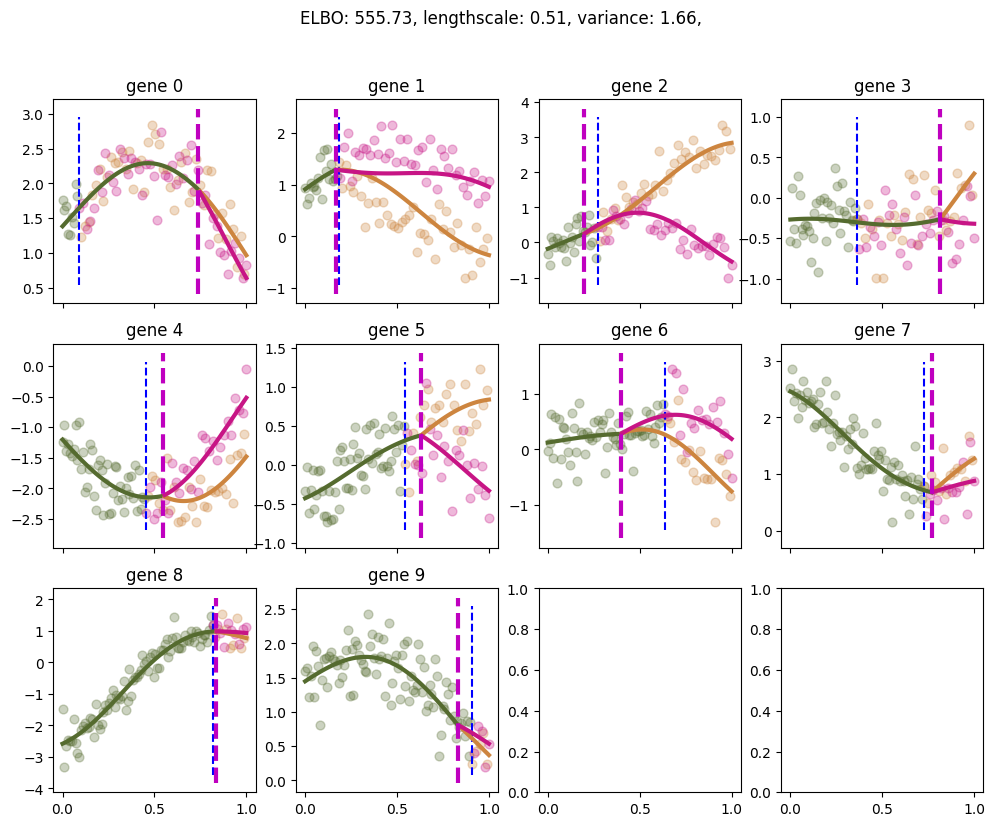

Slicing for gene 0
Uninformative until idx: 80


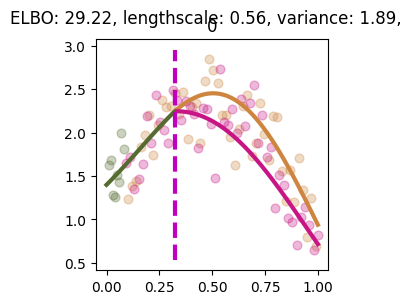

Slicing for gene 1
Uninformative until idx: 80


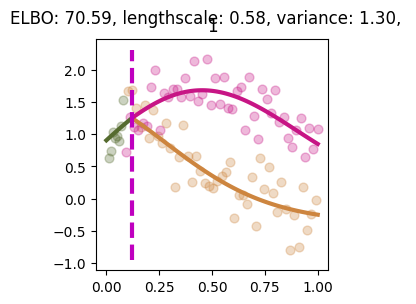

Slicing for gene 2
Uninformative until idx: 80


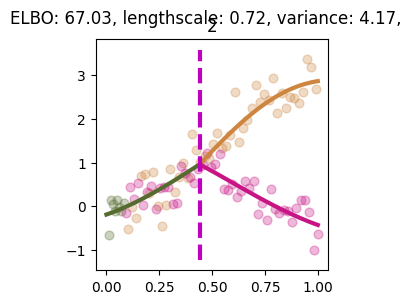

Slicing for gene 3
Uninformative until idx: 80


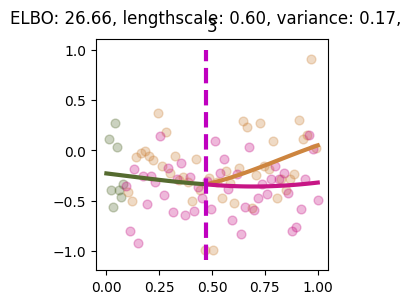

Slicing for gene 4
Uninformative until idx: 80


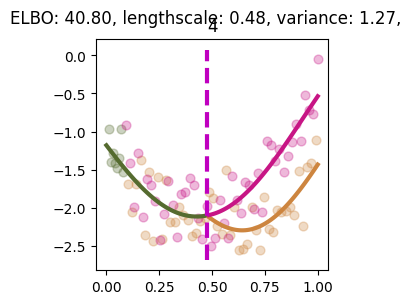

Slicing for gene 5
Uninformative until idx: 80


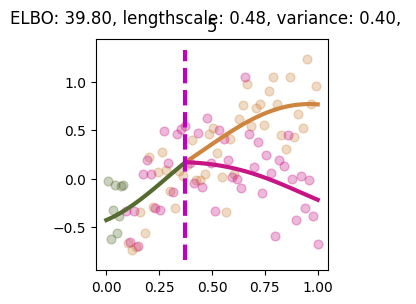

Slicing for gene 6
Uninformative until idx: 80


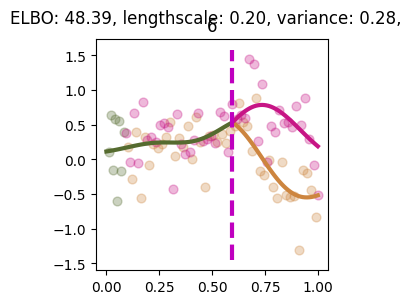

Slicing for gene 7
Uninformative until idx: 80


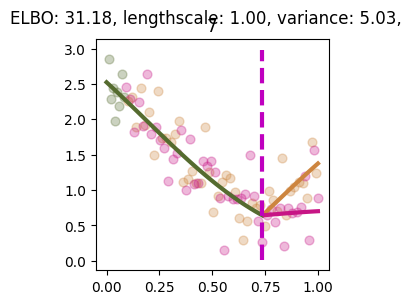

Slicing for gene 8
Uninformative until idx: 80


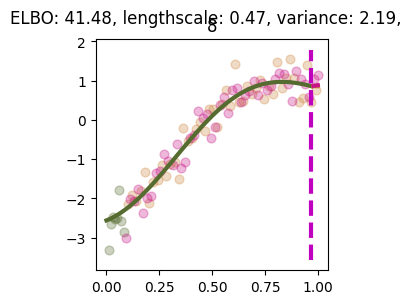

Slicing for gene 9
Uninformative until idx: 80


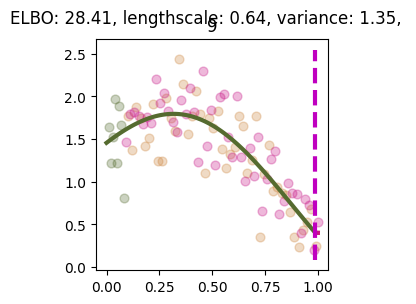

Processing sample 15
Uninformative until idx: 80


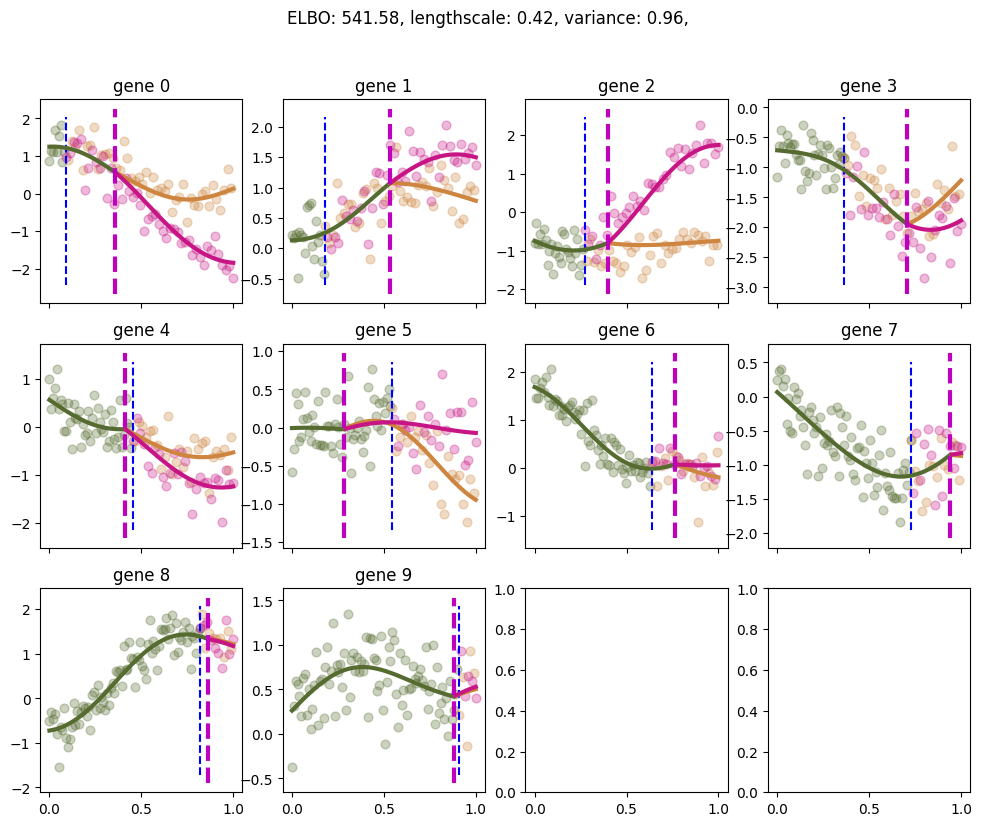

Slicing for gene 0
Uninformative until idx: 80


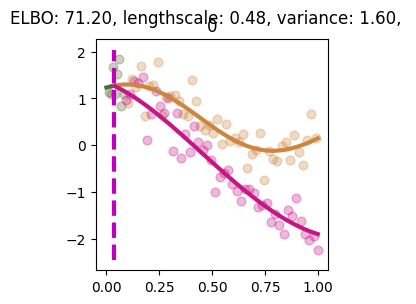

Slicing for gene 1
Uninformative until idx: 80


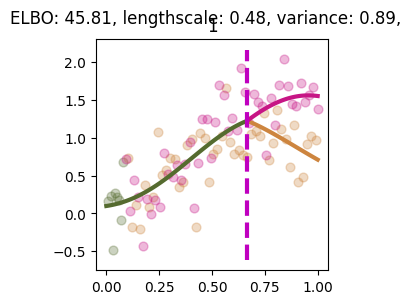

Slicing for gene 2
Uninformative until idx: 80


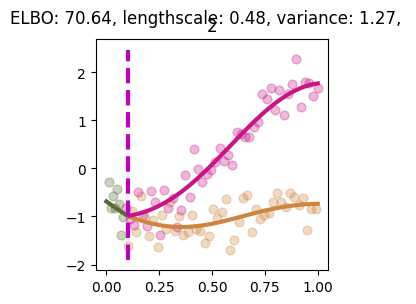

Slicing for gene 3
Uninformative until idx: 80


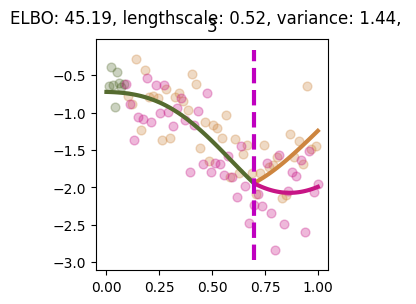

Slicing for gene 4
Uninformative until idx: 80


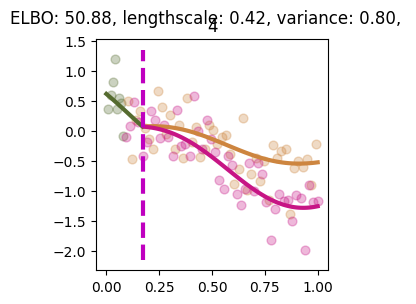

Slicing for gene 5
Uninformative until idx: 80


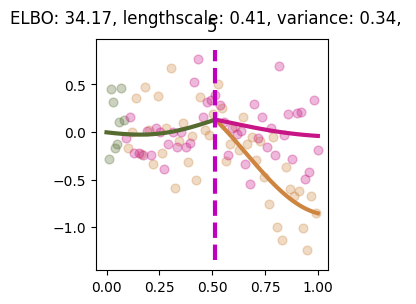

Slicing for gene 6
Uninformative until idx: 80


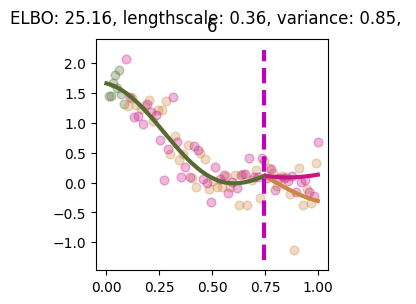

Slicing for gene 7
Uninformative until idx: 80


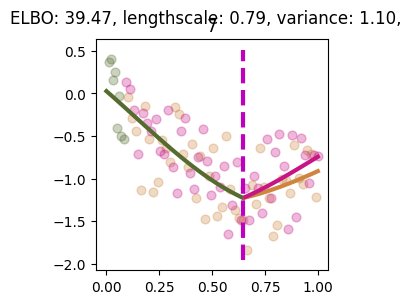

Slicing for gene 8
Uninformative until idx: 80


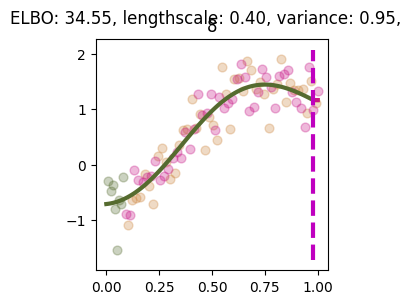

Slicing for gene 9
Uninformative until idx: 80


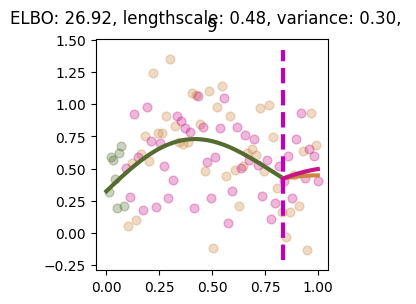

Processing sample 16
Uninformative until idx: 80


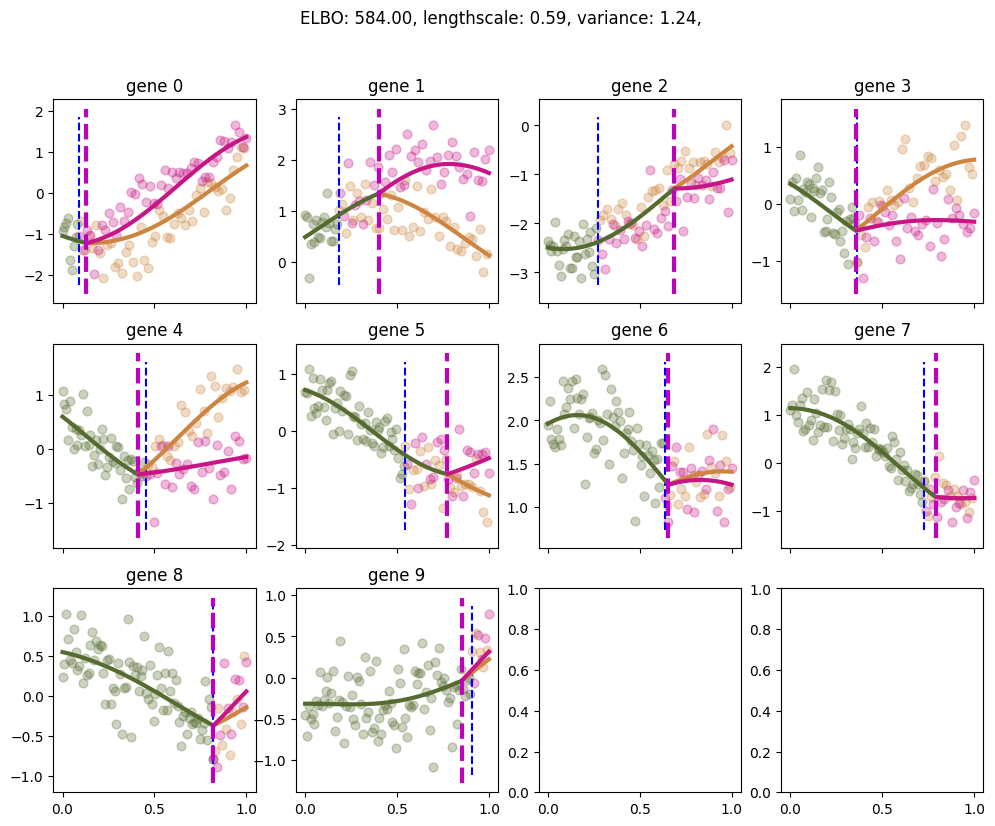

Slicing for gene 0
Uninformative until idx: 80


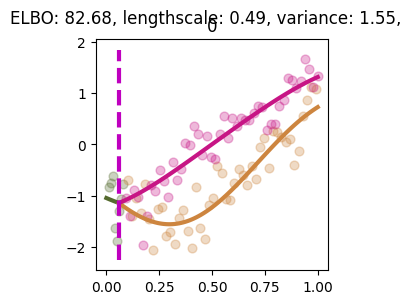

Slicing for gene 1
Uninformative until idx: 80


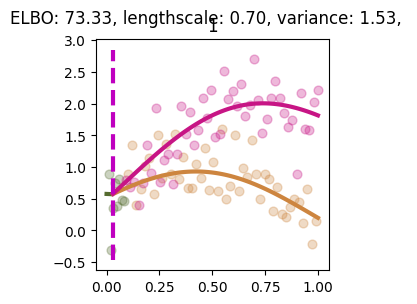

Slicing for gene 2
Uninformative until idx: 80


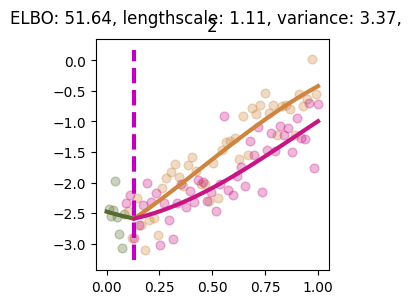

Slicing for gene 3
Uninformative until idx: 80


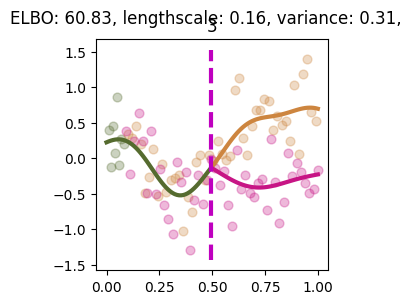

Slicing for gene 4
Uninformative until idx: 80


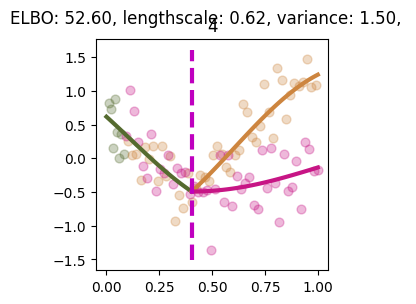

Slicing for gene 5
Uninformative until idx: 80


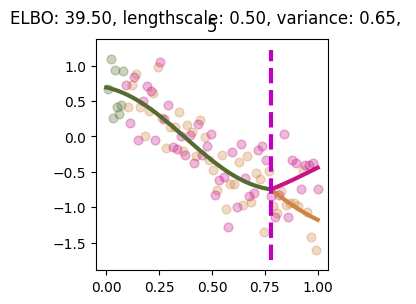

Slicing for gene 6
Uninformative until idx: 80


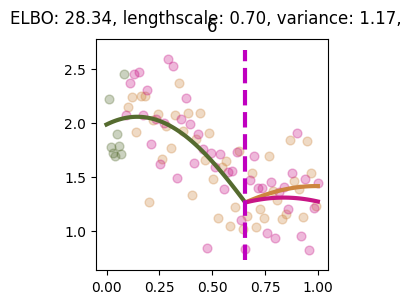

Slicing for gene 7
Uninformative until idx: 80


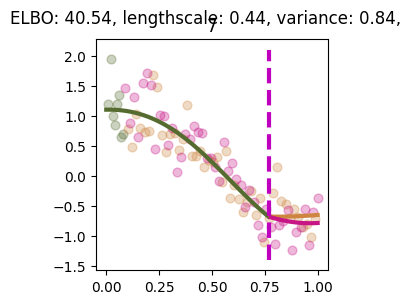

Slicing for gene 8
Uninformative until idx: 80


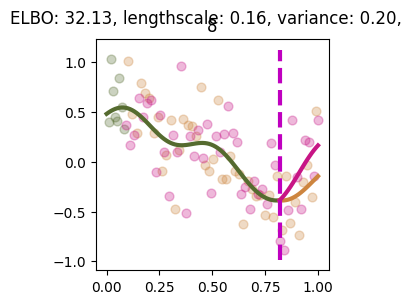

Slicing for gene 9
Uninformative until idx: 80


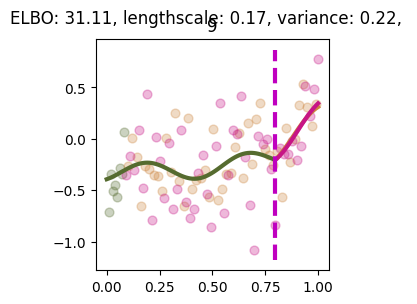

Processing sample 17
Uninformative until idx: 80


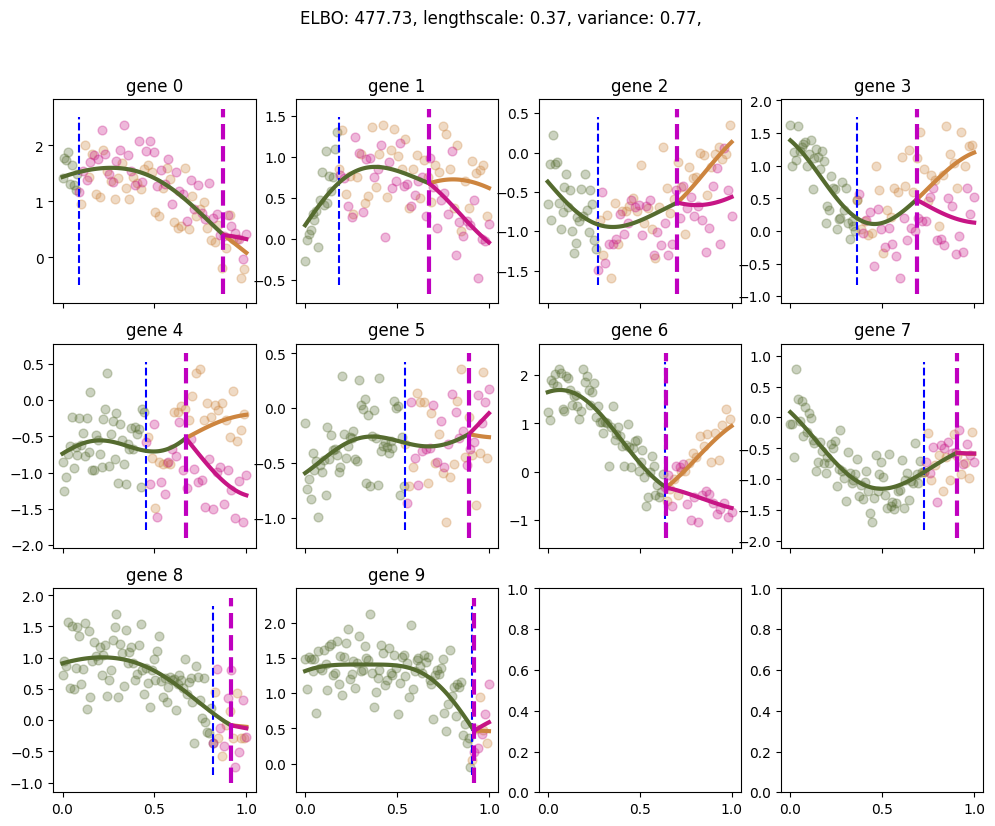

Slicing for gene 0
Uninformative until idx: 80


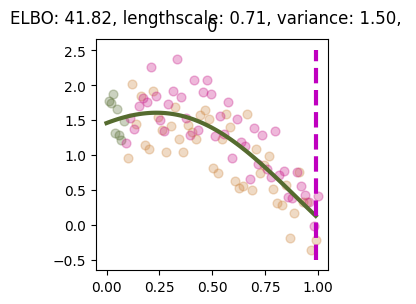

Slicing for gene 1
Uninformative until idx: 80


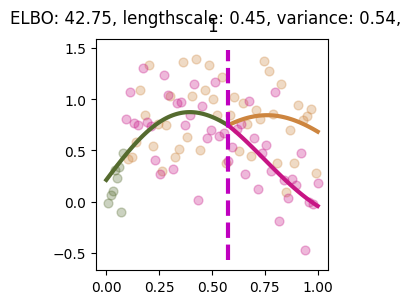

Slicing for gene 2
Uninformative until idx: 80


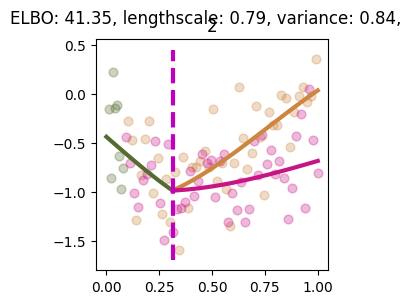

Slicing for gene 3
Uninformative until idx: 80


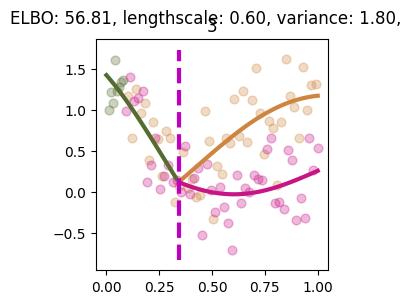

Slicing for gene 4
Uninformative until idx: 80


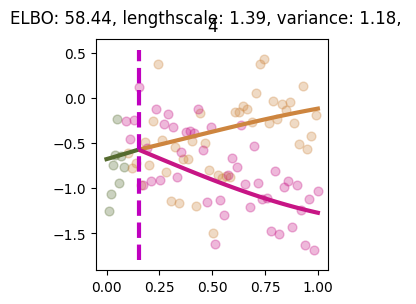

Slicing for gene 5
Uninformative until idx: 80
Error in training: Graph execution error:

Detected at node 'f0f2/invKbb' defined at (most recent call last):
    File "/Users/elvijssarkans/.pyenv/versions/3.10.7/lib/python3.10/runpy.py", line 196, in _run_module_as_main
      return _run_code(code, main_globals, None,
    File "/Users/elvijssarkans/.pyenv/versions/3.10.7/lib/python3.10/runpy.py", line 86, in _run_code
      exec(code, run_globals)
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/ipykernel_launcher.py", line 17, in <module>
      app.launch_new_instance()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/traitlets/config/application.py", line 1043, in launch_instance
      app.start()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/site-packages/ipykernel/kernelapp.py", line 725, in start
      self.io_loop.start()
    File "/Users/elvijssarkans/dev/BranchedGP/venv310/lib/python3.10/s

InvalidArgumentError: {{function_node __wrapped__MatrixInverse_device_/job:localhost/replica:0/task:0/device:CPU:0}} Input is not invertible. [Op:MatrixInverse] name: invKbb

In [13]:
LOW_PRIOR_CONFIDENCE = 0.8
UNINFORMATIVE_UNTIL = 0.8

funky_prior_confidence_results: List[Result] = []

for i, data in enumerate(synthetic_noisy_data):
    print(f"Processing sample {i}")
    
    #
    # MMBGP
    #
    mmbgp = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=FunkyPrior(
            data,
            informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
            uninformative_until=UNINFORMATIVE_UNTIL,
        ),
        initial_branching_points=[0.5]*10,  # Don't start at the true locations
    )    
    optimiser = ElvijsAmazingOptimiser()
    try:
        trained_mmbgp = optimiser.train(mmbgp)
    except Exception as ex:
        print(f"Error in training: {ex}")
        trained_mmbgp = mmbgp
    
    plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
    plt.show()
    
    #
    # BGPs
    #
    bgps = []

    for i in range(data.num_genes):
        print(f"Slicing for gene {i}")
    
        sliced_data = GeneExpressionData(
            t=data.t,
            Y=data.Y[:, i].reshape(-1, 1),
            state=data.state,
            gene_labels=[f"{i}"]
        )
   
        bgp = construct_assigngp_model(
            gene_expression=sliced_data,
            phi_constructor=FunkyPrior(
                sliced_data,
                informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                uninformative_until=UNINFORMATIVE_UNTIL,
            ),
            initial_branching_points=[0.5],  # Don't start at the true locations
        )    
        optimiser = ElvijsAmazingOptimiser()
        try:
            trained_bgp = optimiser.train(bgp)
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_bgp = bgp
            
        plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
        plt.show()
    
        bgps.append(trained_bgp)
    
    result = Result(
        data=data,
        true_bps=np.array(TRUE_BPS),
        mmbgp=trained_mmbgp,
        bgps=bgps,
    )
    funky_prior_confidence_results.append(result)

In [14]:
funky_prior_confidence_df = convert_results_to_df(funky_prior_confidence_results, inconsistency_threshold=0.6)
funky_prior_confidence_df.head(30)

,sample_id,mmbgp_bp_rmse,bgp_bp_rmse,inconsistent_branches,inconsistent_all
0,0,0.328693,0.323574,34,67
1,1,0.316786,0.131716,41,65
2,2,0.338549,0.261355,46,66
3,3,0.191698,0.272501,41,67
4,4,0.176014,0.212676,33,50
5,5,0.283486,0.165386,13,55
6,6,0.316570,0.380944,36,59
7,7,0.330689,0.288643,24,50
8,8,0.399635,0.259705,22,58
9,9,0.275012,0.144980,39,60


In [ ]:
funky_prior_confidence_df.describe()

## Bonus: prior confidence = 0.5

No prior knowledge whatsoever.

In [ ]:
NO_PRIOR_CONFIDENCE = 0.8

dummy_model = get_assigngp_with_target_bps(
    TRUE_BPS, 
    lengthscale=LENGTHSCALE, 
    noise_variance=NOISE,
)
synthetic_noisy_data = get_synthetic_noisy_branched_data(
    dummy_model, 
    num_samples=NUM_SAMPLES, 
    x_pts=100,
)

no_prior_confidence_results: List[Result] = []

for i, data in enumerate(synthetic_noisy_data):
    print(f"Processing sample {i}")
    
    #
    # MMBGP
    #
    mmbgp = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=SimplePhiConstructor(sliced_data, NO_PRIOR_CONFIDENCE),
        initial_branching_points=[0.5]*10,  # Don't start at the true locations
    )    
    optimiser = ElvijsAmazingOptimiser()
    try:
        trained_mmbgp = optimiser.train(mmbgp)
    except Exception as ex:
        print(f"Error in training: {ex}")
        trained_mmbgp = mmbgp
    
    plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
    plt.show()
    
    #
    # BGPs
    #
    bgps = []

    for i in range(data.num_genes):
        print(f"Slicing for gene {i}")
    
        sliced_data = GeneExpressionData(
            t=data.t,
            Y=data.Y[:, i].reshape(-1, 1),
            state=data.state,
            gene_labels=[f"{i}"]
        )
   
        # new model with default-ey parameter values, but SimplePhiConstructor
        bgp = construct_assigngp_model(
            gene_expression=sliced_data,
            phi_constructor=SimplePhiConstructor(sliced_data, NO_PRIOR_CONFIDENCE),
            initial_branching_points=[0.5],  # Don't start at the true locations
        )    
        optimiser = ElvijsAmazingOptimiser()
        try:
            trained_bgp = optimiser.train(bgp)
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_bgp = bgp
            
        plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
        plt.show()
    
        bgps.append(trained_bgp)
    
    result = Result(
        data=data,
        true_bps=np.array(TRUE_BPS),
        mmbgp=trained_mmbgp,
        bgps=bgps,
    )
    no_prior_confidence_results.append(result)

In [ ]:
no_prior_confidence_df = convert_results_to_df(no_prior_confidence_results, inconsistency_threshold=0.6)
no_prior_confidence_df.head(30)

In [ ]:
no_prior_confidence_df.describe()

# Count correct assignment

We actually know the ground truth cell labels,
so let's count how each model did.

In [ ]:
from typing import Set


def get_correct_label_idx_bgp(model: AssignGP, data: GeneExpressionData, true_bp: float) -> Set[int]:
    """
    Get idx of the cells with correct labels.
    
    We're working around the fact that the sliced data labels
    don't reflect the branching point locations.
    """
    num_cells = model.N
    assert num_cells == data.t.shape[0]
    assert data.Y.shape[1] == 1, (
        f"BGP should be fit on single dimensional outputs, instead got {data.Y.shape[1]}"
    )
    
    true_bp_idx = int(true_bp * num_cells)  # assumes pseudotime on [0, 1]
    learned_bp_idx = int(model.BranchingPoints[0] * num_cells)
    
    phi = model.GetPhi()
    
    correct_labels = set()
    for i in range(num_cells):
        # recall that 1 is for trunk
        true_label = 1 if i < true_bp_idx else data.state[i]  # 1, 2 or 3
        
        if i < learned_bp_idx:
            inferred_label = 1  # trunk
        else:
            inferred_label_idx = np.argmax(phi[i]) # 0, 1 or 2
            inferred_label = inferred_label_idx + 1
        
        if inferred_label == true_label:
            correct_labels.add(i)
        
    return correct_labels

In [ ]:
get_correct_label_idx_bgp(trained_bgp, sliced_data, 10/11)

In [ ]:
def get_correct_label_idx_mmbgp(model: AssignGP, data: GeneExpressionData, true_bps: Sequence[float]) -> Set[int]:
    """
    Count how many labels are correct. 
    Return a set of indices, one for each gene.
    """
    num_cells = model.N
    bps = model.BranchingPoints
    
    num_genes = bps.size
    
    assert num_cells == data.t.shape[0]
    assert num_genes == data.Y.shape[1], (
        f"MMBGP not fit on this data, different output dimensions: {num_genes} vs {data.Y.shape[1]}"
    )
    
    correct_idxs: List[Set[int]] = []
    
    for i in range(num_genes):
        true_bp_idx = int(true_bps[i] * num_cells)  # assumes pseudotime on [0, 1]
        learned_bp_idx = int(bps[i] * num_cells)
    
        phi = model.GetPhi()
    
        correct_labels = set()
        for i in range(num_cells):
            # recall that 1 is for trunk
            true_label = 1 if i < true_bp_idx else data.state[i]  # 1, 2 or 3
        
            if i < learned_bp_idx:
                inferred_label = 1  # trunk
            else:
                inferred_label_idx = np.argmax(phi[i]) # 0, 1 or 2
                inferred_label = inferred_label_idx + 1
        
            if inferred_label == true_label:
                correct_labels.add(i)
        
        correct_idxs.append(correct_labels)
        
    return correct_idxs

In [ ]:
get_correct_label_idx_mmbgp(trained_mmbgp, data, TRUE_BPS)

In [ ]:
def convert_results_to_df(res: Sequence[Result], inconsistency_threshold: float = 0.8) -> pd.DataFrame:
    dictified_results = []
    
    for i, r in enumerate(res):
        dres = dict(
            sample_id=i,
            mmbgp_bp_rmse=rmse(r.true_bps, r.mmbgp.BranchingPoints),
            bgp_bp_rmse=rmse(r.true_bps, np.array([bgp.BranchingPoints[0] for bgp in r.bgps])),
            inconsistent_branches=count_branch_inconsistencies(r.bgps, inconsistency_threshold),
            inconsistent_all=count_branch_inconsistencies(r.bgps, inconsistency_threshold, only_branches=False),
            mean_mmbgp_correct_labels=np.array([
                len(correct_labels) for correct_labels in get_correct_label_idx_mmbgp(r.mmbgp, r.data, TRUE_BPS)
            ]).mean(),
        )
        
        bgp_correct_labels = []
        for j, bgp in enumerate(r.bgps):
            sliced_data = GeneExpressionData(
                t=r.data.t,
                Y=r.data.Y[:, j].reshape(-1, 1),
                state=r.data.state,
                gene_labels=[f"{j}"]
            )
            correct_labels = get_correct_label_idx_bgp(bgp, sliced_data, TRUE_BPS[j])
            bgp_correct_labels.append(correct_labels)
            
            
        dres["mean_bgp_correct_labels"] = np.array([len(cl) for cl in bgp_correct_labels]).mean()
        
        dictified_results.append(dres)
    
    return pd.DataFrame(dictified_results)

Summary of results with the additional columns


# Prior confidence = 0.8

In [ ]:
high_prior_confidence_df = convert_results_to_df(high_prior_confidence_results, inconsistency_threshold=0.6)
high_prior_confidence_df.head(30)

In [ ]:
high_prior_confidence_df.describe()

# Funky prior

In [ ]:
funky_prior_confidence_df = convert_results_to_df(funky_prior_confidence_results, inconsistency_threshold=0.6)
funky_prior_confidence_df.head(30)

In [ ]:
funky_prior_confidence_df.describe()

# Prior confidence = 0.5

In [ ]:
no_prior_confidence_df = convert_results_to_df(no_prior_confidence_results, inconsistency_threshold=0.6)
no_prior_confidence_df.head(30)

In [ ]:
no_prior_confidence_df.describe()

## Histograms of where the labels are correct

We want to plot a histogram of cell label errors with pseudotime on the x-axis. 
Binning the pseudotimes across 10 genes all together in one plot 
(so a plot per sample, not a plot per gene).

In [ ]:
from typing import Tuple


def convert_result_to_incorrect_label_count(
        res: Result,
) -> Tuple[Sequence[int], Sequence[int]]:
    """ 
    Given a sequence of results, produce two sequences of incorrect cell label pseudotimes:
    one for MMBGP and one for BGP.
    """    
    # Get the number of data points for idx to pseudotime conversions
    n = res.data.t.size
    
    mmbgp_correct_labels = get_correct_label_idx_mmbgp(res.mmbgp, res.data, TRUE_BPS)
    # This is a list of sets with each set corresponding to the indices with correct labels,
    # for example {1, 3, 10, ..., 99}. 
    # We now invert each set to get its complement in {0, 1, 2, 3, ..., 99}
    mmbgp_incorrect_labels = [
        set(range(n + 1)) - set(correct_labels_per_gene) 
        for correct_labels_per_gene in mmbgp_correct_labels
    ]
    # Now flatten the sets into one long list and convert idx to pseudotime
    mmbgp_incorrect_pseudotimes = [
        i/n
        for incorrect_labels_per_gene in mmbgp_incorrect_labels
        for i in incorrect_labels_per_gene
    ]

    bgp_incorrect_labels = []
    for j, bgp in enumerate(res.bgps):
        sliced_data = GeneExpressionData(
            t=res.data.t,
            Y=res.data.Y[:, j].reshape(-1, 1),
            state=res.data.state,
            gene_labels=[f"{j}"]
        )
        correct_labels = get_correct_label_idx_bgp(bgp, sliced_data, TRUE_BPS[j])
        # This is a set of form {1, 3, 10, ..., 99}. 
        # We now invert it to get the complement of the above set in {0, 1, 2, 3, ..., 99}
        incorrect_labels = set(range(n + 1)) - correct_labels
        
        bgp_incorrect_labels.append(incorrect_labels)
    
    # Now convert to pseudotimes by dividing through the number of data points
    bgp_incorrect_pseudotimes = [
        i/n
        for bgp_incorrect_labels_per_gene in bgp_incorrect_labels
        for i in bgp_incorrect_labels_per_gene
    ]
    
    return (mmbgp_incorrect_pseudotimes, bgp_incorrect_pseudotimes)

In [ ]:
def plot_incorrect_label_histograms(results: Sequence[Result]) -> None:
    mmbgp_all, bgp_all = [], []

    for i, res in enumerate(results): 
        mbgp_incorrect_ptime, bgp_incorrect_ptime = convert_result_to_incorrect_label_count(res)
    
        fig, axa = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)
        axa[0].hist(mbgp_incorrect_ptime)
        axa[0].set_title(f"Sample {i}, MMBGP incorrect labels")
        axa[1].hist(bgp_incorrect_ptime)
        axa[1].set_title(f"Sample {i}, BGP incorrect labels")
        plt.show()

        mmbgp_all.extend(mbgp_incorrect_ptime)
        bgp_all.extend(bgp_incorrect_ptime)


    fig, axa = plt.subplots(1, 2, figsize=(10, 4), sharex=True, sharey=True)
    axa[0].hist(mmbgp_all)
    axa[0].set_title("All MMBGP incorrect labels")
    axa[1].hist(bgp_all)
    axa[1].set_title("All BGP incorrect labels")
    plt.show()

### Prior confidence = 0.8

In [ ]:
plot_incorrect_label_histograms(high_prior_confidence_results)

### Funky prior

In [ ]:
plot_incorrect_label_histograms(funky_prior_confidence_results)

**TODO:** re-run the above with ground truth BPs (don't learn them).
  This way we focus on the cell assignment problem.
  Only for the funky prior.

**TODO:** compare ELBO at the MMBGP learned "location + cell labels" vs 
  initialising at the ground truth (the ELBO minimum should be close to the true minimum).

**TODO:** drill into this and see if we can (i) add more genes, and (ii) reduce noise.
  Only for the funky prior.

**TODO:** compute the standard error for each bin and see if each of the bin measurements
  is significantly different?

**TODO:** prettify this histogram.

**TODO (long term):** new optimisation scheme. 
  Learn a single branching time with a slight prior towards early branching time. 
  Do this via grid search, not gradient descent?
  Then learn the cell labels. Then allow branching times to be different per gene.

### No prior knowledge

In [ ]:
plot_incorrect_label_histograms(no_prior_confidence_results)

## Finding where BGP is bad

We want to find a setting where BGP doesn’t work well as measured by the true/learned BP RMSE. 
Starting point - 20 genes, 50 cells, later branching points (with funky prior). 
I might also reduce the noise a bit.

In [ ]:
NOISE = 0.05
LENGTHSCALE = 0.5

NUM_SAMPLES = 5
TRUE_BPS = [i/21 for i in range(1, 21, 1)]


HIGH_PRIOR_CONFIDENCE = 0.8

dummy_model = get_assigngp_with_target_bps(
    TRUE_BPS, 
    lengthscale=LENGTHSCALE, 
    noise_variance=NOISE,
)
synthetic_noisy_data = get_synthetic_noisy_branched_data(
    dummy_model, 
    num_samples=NUM_SAMPLES, 
    x_pts=50,
)

search_for_bad_bgp_fits: List[Result] = []

    
LOW_PRIOR_CONFIDENCE = 0.8
UNINFORMATIVE_UNTIL = 0.8

funky_prior_confidence_results: List[Result] = []

for i, data in enumerate(synthetic_noisy_data):
    print(f"Processing sample {i}")
    
    #
    # MMBGP
    #
    mmbgp = construct_assigngp_model(
        gene_expression=data,
        phi_constructor=FunkyPrior(
            data,
            informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
            uninformative_until=UNINFORMATIVE_UNTIL,
        ),
        initial_branching_points=[0.5]*len(TRUE_BPS),  # Don't start at the true locations
    )    
    optimiser = ElvijsAmazingOptimiser()
    try:
        trained_mmbgp = optimiser.train(mmbgp)
    except Exception as ex:
        print(f"Error in training: {ex}")
        trained_mmbgp = mmbgp
    
    plot_model_snapshot(trained_mmbgp, genes=data, alpha=0.3)
    plt.show()
    
    #
    # BGPs
    #
    bgps = []

    for i in range(data.num_genes):
        print(f"Slicing for gene {i}")
    
        sliced_data = GeneExpressionData(
            t=data.t,
            Y=data.Y[:, i].reshape(-1, 1),
            state=data.state,
            gene_labels=[f"{i}"]
        )
   
        bgp = construct_assigngp_model(
            gene_expression=sliced_data,
            phi_constructor=FunkyPrior(
                sliced_data,
                informative_prior_confidence=HIGH_PRIOR_CONFIDENCE, 
                uninformative_until=UNINFORMATIVE_UNTIL,
            ),
            initial_branching_points=[0.5],  # Don't start at the true locations
        )    
        optimiser = ElvijsAmazingOptimiser()
        try:
            trained_bgp = optimiser.train(bgp)
        except Exception as ex:
            print(f"Error in training: {ex}")
            trained_bgp = bgp
            
        plot_model_snapshot(trained_bgp, genes=sliced_data, alpha=0.3)
        plt.show()
    
        bgps.append(trained_bgp)
    
    result = Result(
        data=data,
        true_bps=np.array(TRUE_BPS),
        mmbgp=trained_mmbgp,
        bgps=bgps,
    )
    search_for_bad_bgp_fits.append(result)

In [ ]:
search_for_bad_bgp_fits_df = convert_results_to_df(search_for_bad_bgp_fits, inconsistency_threshold=0.6)

In [ ]:
search_for_bad_bgp_fits_df.head(10)

In [ ]:
search_for_bad_bgp_fits_df.describe()